# Problem Statement

You are given the original and degraded versions of a few images. Your task is to write a GAN which can fix the degraded images.

Complete the function `fix` at the end of the "Evaluation" block so that it can take a degraded image, and return a fixed image (that looks as much like the original non-degraded version as possible).

Before submission, get this notebook in a state such that the `fix` function can directly be called on an image.

#Setup

## Intended Structure after Setup

Run the blocks in this section to get the following directory structure:
```
/content
│
└───my-pubfig831
    │
    └───correct
    │   │
    │   └───train
    │   │   │
    │   │   └───Adam Sandler
    │   │   │   │   train__000001-000000.jpg
    │   │   │   │   train__000001-000001.jpg
    │   │   │   │   train__000001-000002.jpg
    │   │   │   │   ...
    │   │   │
    │   │   └───Alec Baldwin
    │   │   │   │   train__000002-000000.jpg
    │   │   │   │   train__000002-000001.jpg
    │   │   │   │   ...
    │   │   │
    │   │   └───Angelina Jolie
    │   │   │   │   train__000003-000000.jpg
    │   │   │   │   train__000003-000001.jpg
    │   │   │   │   ...
    │   │   │
    │   │   │ ...
    │   │
    │   └───test
    │       │
    │       └───Adam Sandler
    │       │   │   test__000001-000000.jpg
    │       │   │   test__000001-000001.jpg
    │       │   │   ...
    │       │
    │       └───Alec Baldwin
    │       │   │   test__000002-000000.jpg
    │       │   │   ...
    │       │
    │       └───Angelina Jolie
    │       │   │   test__000003-000000.jpg
    │       │   │   ...
    │       │
    │       │ ...
    │
    │
    └───degraded
        │   <Same directory structure as 'correct'>
```

Every image in the degraded directory is a degraded version of the image with the same name in the correct directory. e.g. `/content/my-pubfig831/degraded/Adam Sandler/train__000001-000002.jpg` is the degraded version of `/content/my-pubfig831/correct/Adam Sandler/train__000001-000002.jpg`

## Installation (pip etc)
Add any other installation commands you want to in this block.

In [0]:
!pip install GPUtil
!pip install tqdm
!ln -sf /opt/bin/nvidia-smi /usr/bin/nvidia-smi
!apt install graphviz
!pip install pydot pydot-ng
!echo "Double check with Python 3"
!python -c "import pydot"

  Created wheel for GPUtil: filename=GPUtil-1.4.0-cp36-none-any.whl size=7410 sha256=8f51d3c391ac0d006531102d8435ca2c25d4eeac0dfaa4e8ce50e5f95abfebda
  Stored in directory: /root/.cache/pip/wheels/3d/77/07/80562de4bb0786e5ea186911a2c831fdd0018bda69beab71fd
Successfully built GPUtil
Reading package lists... Done
Building dependency tree       
Reading state information... Done
graphviz is already the newest version (2.40.1-2).
0 upgraded, 0 newly installed, 0 to remove and 8 not upgraded.
Double check with Python 3


## Downloading and Generating Dataset
Run this block only once. Do not modify it.

In [0]:
import os
from glob import glob

import cv2
import numpy as np
from tqdm import tqdm

def degrade(path: str) -> None:
    """Load image at `input_path`, distort and save as `output_path`"""
    SHIFT = 2
    image = cv2.imread(path)
    to_swap = np.random.choice([False, True], image.shape[:2], p=[.8, .2])
    swap_indices = np.where(to_swap[:-SHIFT] & ~to_swap[SHIFT:])
    swap_vals = image[swap_indices[0] + SHIFT, swap_indices[1]]
    image[swap_indices[0] + SHIFT, swap_indices[1]] = image[swap_indices]
    image[swap_indices] = swap_vals
    cv2.imwrite(path, image)

!wget http://briancbecker.com/files/downloads/pubfig83lfw/pubfig83lfw_raw_in_dirs.zip
!unzip -q pubfig83lfw_raw_in_dirs.zip
!rm pubfig83lfw_raw_in_dirs.zip
!mkdir my-pubfig831
!mv pubfig83lfw_raw_in_dirs my-pubfig831/correct
!rm -r my-pubfig831/correct/distract
!cp -r my-pubfig831/correct my-pubfig831/degraded

for image_path in tqdm(glob('my-pubfig831/degraded/*/*/*.jpg')):
  degrade(image_path)

--2019-10-06 14:41:33--  http://briancbecker.com/files/downloads/pubfig83lfw/pubfig83lfw_raw_in_dirs.zip
Resolving briancbecker.com (briancbecker.com)... 162.241.216.158
Connecting to briancbecker.com (briancbecker.com)|162.241.216.158|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 400247922 (382M) [application/zip]
Saving to: ‘pubfig83lfw_raw_in_dirs.zip’

pubfig83lfw_raw_in_ 100%[===================>] 381.71M  74.9MB/s    in 5.3s    

2019-10-06 14:41:39 (71.4 MB/s) - ‘pubfig83lfw_raw_in_dirs.zip’ saved [400247922/400247922]



100%|██████████| 13002/13002 [01:01<00:00, 209.79it/s]


# **Checking Free Memory**
This block is just so that you can have an idea of the resources you have at hand on the Google Collab system.

In [0]:
import psutil
import humanize
import os
import GPUtil as GPU
import os
from glob import glob

import cv2
import numpy as np
from tqdm import tqdm
gpu = GPU.getGPUs()[0]
process = psutil.Process(os.getpid())
print(f"Gen RAM: Free {humanize.naturalsize(psutil.virtual_memory().available)} | Proc size {humanize.naturalsize(process.memory_info().rss)}")
print(f"GPU RAM: Free {gpu.memoryFree:.0f}MB | Used {gpu.memoryUsed:.0f}MB | Util {gpu.memoryUtil*100:.0f}% | Total {gpu.memoryTotal:.0f}MB")

Gen RAM: Free 26.4 GB | Proc size 173.9 MB
GPU RAM: Free 11441MB | Used 0MB | Util 0% | Total 11441MB


# **Main Code**

## Data Loading

In [0]:
correct_train_paths = glob('my-pubfig831/correct/train/*/*.jpg')
degraded_train_paths = glob('my-pubfig831/degraded/train/*/*.jpg')
correct_test_paths = glob('my-pubfig831/correct/test/*/*.jpg')
degraded_test_paths = glob('my-pubfig831/degraded/test/*/*.jpg')

correct_images = []
for path in correct_train_paths:
    temp = cv2.imread(path)
    # temp = cv2.cvtColor(temp, cv2.COLOR_BGR2RGB)
    temp = cv2.resize(temp, (224, 224), interpolation = cv2.INTER_CUBIC)
    temp = temp.astype('float32')
    temp = (temp - 127.5) / 127.5
    correct_images.append(temp)
correct_images = np.asarray(correct_images)
print("Correct images shape: {}".format(correct_images.shape))

degraded_images = []
for path in degraded_train_paths:
    temp = cv2.imread(path)
    # temp = cv2.cvtColor(temp, cv2.COLOR_BGR2RGB)
    temp = cv2.resize(temp, (224,224), interpolation = cv2.INTER_CUBIC)
    temp = temp.astype('float32')
    temp = (temp - 127.5) / 127.5
    degraded_images.append(temp)
degraded_images = np.asarray(degraded_images)
print("Degraded images shape: {}".format(degraded_images.shape))

Correct images shape: (8720, 224, 224, 3)
Degraded images shape: (8720, 224, 224, 3)


## Structure

### **Constants and Hyperparemeters**

In [0]:
IN_HEIGHT = 224
IN_WIDTH = 224
IN_CHANNELS = 3
EPOCHS = 5000
BATCH_SIZE = 32

### Generator Model

In [0]:
from keras.models import *
from keras.layers import *
from keras.optimizers import *
from keras.utils.vis_utils import plot_model
from IPython.display import Image
from keras import backend as k
import keras
import matplotlib.pyplot as plt
from keras.initializers import *
def create_generator(input_size=(IN_HEIGHT, IN_WIDTH, IN_CHANNELS)):
	inputs = Input(input_size, name='g_degraded_input')
	init = RandomNormal(mean=0.0, stddev=0.02)
	conv1 = Conv2D(32, 3, strides = (2,2), padding='same', kernel_initializer=init, name='g_conv1')(inputs)
	bn1 = BatchNormalization(momentum = 0.8)(conv1)
	lr1 = LeakyReLU(0.2)(bn1)
	
	conv2 = Conv2D(64, 3, strides = (2,2), padding='same', kernel_initializer=init, name='g_conv2')(lr1)
	bn2 = BatchNormalization(momentum = 0.8)(conv2)
	lr2 = LeakyReLU(0.2)(bn2)
	
	conv3 = Conv2D(128 , 3, strides = (2,2), padding='same', kernel_initializer=init, name='g_conv3')(lr2)
	bn3 = BatchNormalization(momentum = 0.8)(conv3)
	lr3 = LeakyReLU(0.2)(bn3)
	
	conv4 = Conv2D(256, 3, strides = (2,2), padding='same', kernel_initializer=init, name='g_conv4')(lr3)
	bn4 = BatchNormalization(momentum = 0.8)(conv4)
	lr4 = LeakyReLU(0.2)(bn4)
	drop4 = Dropout(0.5)(lr4)

	conv5 = Conv2D(128, 3, padding = 'same', kernel_initializer = init, name = 'g_conv5')(UpSampling2D(size=(2, 2))(drop4))
	bn5 = BatchNormalization(momentum = 0.8)(conv5)
	lr5 = LeakyReLU(0.2)(bn5)
	merge5 = concatenate([lr3, lr5], axis=3)
	conv6 = Conv2D(128, 3, padding='same', kernel_initializer=init, name='g_conv6')(merge5)
	bn6 = BatchNormalization(momentum = 0.8)(conv6)
	lr6 = LeakyReLU(0.2)(bn6)

	conv7 = Conv2D(64, 3, padding = 'same', kernel_initializer = init, name ='g_conv7') (UpSampling2D(size=(2, 2))(lr6))
	bn7 = BatchNormalization(momentum = 0.8)(conv7)
	lr7 = LeakyReLU(0.2)(bn7)
	merge6 = concatenate([lr2, lr7], axis=3)
	conv8 = Conv2D(64, 3, padding='same', kernel_initializer=init, name='g_conv8')(merge6)
	bn8 = BatchNormalization(momentum = 0.8)(conv8)
	lr8 = LeakyReLU(0.2)(bn8)

	conv9 = Conv2D(32, 3, padding='same', kernel_initializer = init, name = 'g_conv9') (UpSampling2D(size=(2, 2))(lr8))
	bn9 = BatchNormalization(momentum = 0.8)(conv9)
	lr9 = LeakyReLU(0.2)(bn9)
	merge7 = concatenate([lr1, lr9], axis=3)

	up11 = UpSampling2D(size=(2,2))(merge7)
	conv10 = Conv2D(3, 3, activation = 'tanh', padding='same', kernel_initializer= init, name='gen_out')(up11)

	model = Model(input=[inputs], output=[conv10] , name= 'generator')
	# model.compile(optimizer=Adam(lr=1e-4), loss='binary_crossentropy', metrics=['accuracy'])
	# print("Generator Summary")
	# print(model.summary())
	return model

Using TensorFlow backend.


### Discriminator Model

In [0]:
def create_descriminator(input_size=(IN_HEIGHT, IN_WIDTH, IN_CHANNELS)):
    inputs1 = Input(input_size, name = 'generated_input')
    inputs2 = Input(input_size, name='ground_truth')

    conv1 = Conv2D(48, 4, strides =(2,2), name='d_conv1')(inputs1)
    bn1 = BatchNormalization(momentum=0.8)(conv1)
    lr1 = LeakyReLU(alpha=0.1)(bn1)

    conv2 = Conv2D(96, 4, strides =(2,2), name='d_conv2')(lr1)
    bn2 = BatchNormalization(momentum = 0.8)(conv2)
    lr2 = LeakyReLU(alpha=0.1)(bn2)

    conv3 = Conv2D(192, 4, strides =(2,2), name='d_conv3')(lr2)
    bn3 = BatchNormalization(momentum = 0.8)(conv3)
    lr3 = LeakyReLU(alpha=0.1)(bn3)

    conv4 = Conv2D(384, 4, strides =(2,2), name='d_conv4')(lr3)
    bn4 = BatchNormalization(momentum = 0.8)(conv4)
    lr4 = LeakyReLU(alpha=0.1)(bn4)

    flatten = Flatten()(lr4)
    dense1 = Dense(1024, activation='relu')(flatten)
    dense2 = Dense(1, activation='sigmoid', name = 'des_out')(dense1)

    model = Model(input = [inputs1, inputs2], output = [dense2], name = 'descriminator')
    model.compile(optimizer=Adam(lr=1e-4), loss='binary_crossentropy', metrics=['accuracy'])
    # print("Descriminator summary")
    # print(model.summary())
    return model

## Preprocessing

## Training







Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.



/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:54: UserWarning: Update your `Model` call to the Keras 2 API: `Model(name="generator", inputs=[<tf.Tenso..., outputs=[<tf.Tenso...)`



Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:25: UserWarning: Update your `Model` call to the Keras 2 API: `Model(name="descriminator", inputs=[<tf.Tenso..., outputs=[<tf.Tenso...)`
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: UserWarning: Update your `Model` call to the Keras 2 API: `Model(name="gan", inputs=[<tf.Tenso..., outputs=Tensor("de...)`
  


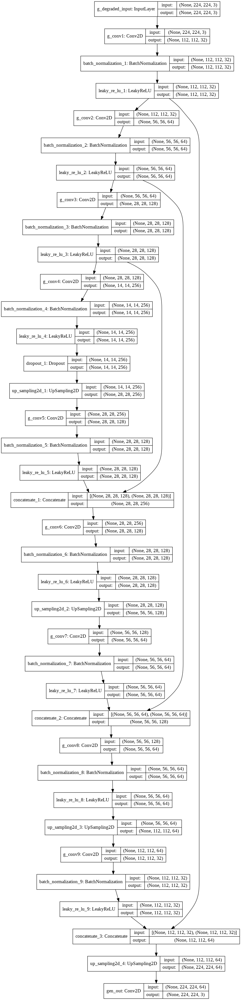

In [0]:
inp2 = Input((IN_HEIGHT, IN_WIDTH, IN_CHANNELS), name='ground_input')
gen = create_generator()
generated_img = gen.outputs

def custom_loss(y_true, y_pred):
    loss1 = k.mean(k.square(generated_img - inp2), axis=-1)
    # loss2 = keras.losses.binary_crossentropy(y_true, y_pred)
    return loss1 

des = create_descriminator()
des_out = des([gen.output, inp2])

des.trainable = False
combined = Model(input = [gen.input, inp2], output = des_out, name='gan')
combined.compile(optimizer = Adam(lr=1e-4), loss=custom_loss, metrics = ['accuracy'] )
plot_model(combined, show_shapes=True, show_layer_names=True, to_file='gan.png')
plot_model(des, show_shapes=True, show_layer_names=True, to_file='des.png')
plot_model(gen, show_shapes=True, show_layer_names=True, to_file='gen.png')

In [0]:
def train(epochs=EPOCHS, batch_size=8):
    valid = np.ones((batch_size, 1))
    fake = np.zeros((batch_size, 1))    
    for e in tqdm(range(epochs)):
        # training descriminator
        des.trainable = True
        idx = np.random.randint(0, correct_images.shape[0], batch_size)
        correct_batch = correct_images[idx]
        degraded_batch = degraded_images[idx]
        
        gen_imgs = gen.predict(degraded_batch)
        des_loss = des.train_on_batch([gen_imgs, correct_batch], fake)

        # train generator
        des.trainable = False
        imgs = {
            'g_degraded_input' : degraded_batch,
            'ground_input' : correct_batch
        }
        gen_loss = combined.train_on_batch(imgs, valid)
        print(gen_loss)
        if(e%50 == 0):
            print ("%d [G loss: %f, G acc.: %.2f%%]" % (e, gen_loss[0], 100*gen_loss[1]))
        if(e%200 == 0):
            save_img(e)
    gen.save('gen_model.h5')
    des.save('des_model.h5')
    combined.save('gan_model.h5')


In [0]:
def save_img(epoch):
    i = np.random.randint(0,correct_images.shape[0],25)
    d_img = degraded_images[i]
    g_img = gen.predict(d_img)
    g_img = g_img * 0.5 + 0.5
    g_img = g_img*255
    g_img = g_img.astype(np.uint8)
    # g_img = g_img[:,:,::-1]
    fig, axs = plt.subplots(5,5, figsize=(25,25))
    for j in range(5):
        for k in range(5):
            axs[j,k].imshow(g_img[5*j + k])
            axs[j,k].axis('off')
    plt.show()
    fig.savefig("training_imgs/Faces_%d.png" % epoch)
    plt.close()

  0%|          | 0/5000 [00:00<?, ?it/s]

[0.4101051, 0.0]
0 [G loss: 0.410105, G acc.: 0.00%]


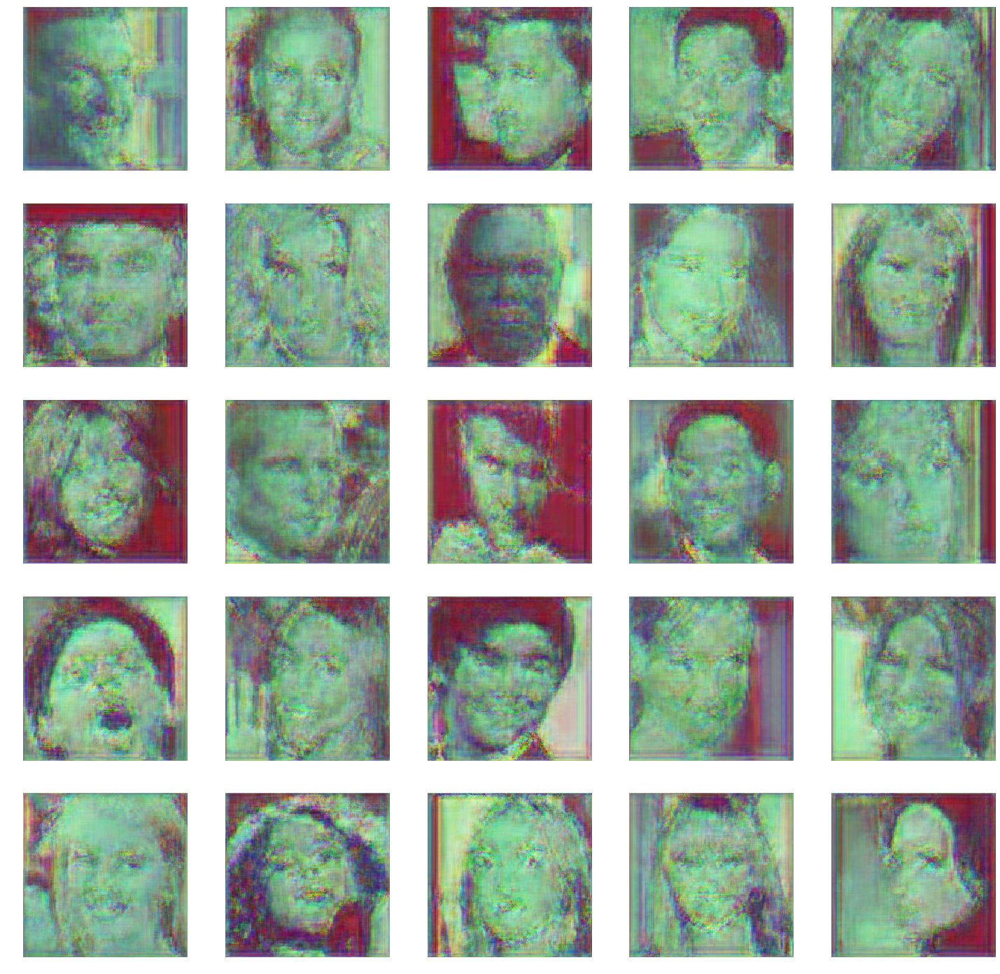

  0%|          | 2/5000 [00:21<20:11:00, 14.54s/it]

[0.22948371, 0.0]


  0%|          | 3/5000 [00:21<14:25:23, 10.39s/it]

[0.1863931, 0.0]


  0%|          | 4/5000 [00:22<10:23:12,  7.48s/it]

[0.12352666, 0.0]


  0%|          | 5/5000 [00:23<7:34:01,  5.45s/it] 

[0.09925118, 0.0]


  0%|          | 6/5000 [00:24<5:35:14,  4.03s/it]

[0.09288968, 0.0]


  0%|          | 7/5000 [00:24<4:12:29,  3.03s/it]

[0.087717414, 0.0]


  0%|          | 8/5000 [00:25<3:14:11,  2.33s/it]

[0.0662937, 0.0]


  0%|          | 9/5000 [00:26<2:33:41,  1.85s/it]

[0.060260817, 0.0]


  0%|          | 10/5000 [00:26<2:05:01,  1.50s/it]

[0.05192269, 0.0]


  0%|          | 11/5000 [00:27<1:45:24,  1.27s/it]

[0.045063812, 0.0]


  0%|          | 12/5000 [00:28<1:31:13,  1.10s/it]

[0.043994803, 0.0]


  0%|          | 13/5000 [00:28<1:21:41,  1.02it/s]

[0.03510437, 0.0]


  0%|          | 14/5000 [00:29<1:14:41,  1.11it/s]

[0.03668484, 0.0]


  0%|          | 15/5000 [00:30<1:09:58,  1.19it/s]

[0.031554434, 0.0]


  0%|          | 16/5000 [00:31<1:06:28,  1.25it/s]

[0.033544637, 0.0]


  0%|          | 17/5000 [00:31<1:04:10,  1.29it/s]

[0.037485246, 0.0]


  0%|          | 18/5000 [00:32<1:02:27,  1.33it/s]

[0.029175982, 0.0]


  0%|          | 19/5000 [00:33<1:01:29,  1.35it/s]

[0.031090505, 0.0]


  0%|          | 20/5000 [00:33<1:00:31,  1.37it/s]

[0.02779337, 0.0]


  0%|          | 21/5000 [00:34<1:00:01,  1.38it/s]

[0.026406322, 0.0]


  0%|          | 22/5000 [00:35<59:28,  1.39it/s]  

[0.0233352, 0.0]


  0%|          | 23/5000 [00:36<59:21,  1.40it/s]

[0.022846255, 0.0]


  0%|          | 24/5000 [00:36<59:06,  1.40it/s]

[0.02344835, 0.0]


  0%|          | 25/5000 [00:37<59:05,  1.40it/s]

[0.024544543, 0.0]


  1%|          | 26/5000 [00:38<58:46,  1.41it/s]

[0.018041607, 0.0]


  1%|          | 27/5000 [00:38<59:00,  1.40it/s]

[0.019592235, 0.0]


  1%|          | 28/5000 [00:39<58:43,  1.41it/s]

[0.024769017, 0.0]


  1%|          | 29/5000 [00:40<58:56,  1.41it/s]

[0.0179995, 0.0]


  1%|          | 30/5000 [00:40<58:40,  1.41it/s]

[0.018752035, 0.0]


  1%|          | 31/5000 [00:41<58:46,  1.41it/s]

[0.023491766, 0.0]


  1%|          | 32/5000 [00:42<58:37,  1.41it/s]

[0.019288896, 0.0]


  1%|          | 33/5000 [00:43<58:57,  1.40it/s]

[0.016212804, 0.0]


  1%|          | 34/5000 [00:43<58:41,  1.41it/s]

[0.017193712, 0.0]


  1%|          | 35/5000 [00:44<58:49,  1.41it/s]

[0.016753219, 0.0]


  1%|          | 36/5000 [00:45<58:34,  1.41it/s]

[0.015700879, 0.0]


  1%|          | 37/5000 [00:45<58:45,  1.41it/s]

[0.014254301, 0.0]


  1%|          | 38/5000 [00:46<58:25,  1.42it/s]

[0.016392484, 0.0]


  1%|          | 39/5000 [00:47<58:41,  1.41it/s]

[0.018400783, 0.0]


  1%|          | 40/5000 [00:48<58:29,  1.41it/s]

[0.01991979, 0.0]


  1%|          | 41/5000 [00:48<58:37,  1.41it/s]

[0.013278908, 0.0]


  1%|          | 42/5000 [00:49<58:25,  1.41it/s]

[0.013718801, 0.0]


  1%|          | 43/5000 [00:50<58:36,  1.41it/s]

[0.014115164, 0.0]


  1%|          | 44/5000 [00:50<58:26,  1.41it/s]

[0.016164225, 0.0]


  1%|          | 45/5000 [00:51<58:44,  1.41it/s]

[0.016293028, 0.0]


  1%|          | 46/5000 [00:52<58:41,  1.41it/s]

[0.014001086, 0.0]


  1%|          | 47/5000 [00:53<58:48,  1.40it/s]

[0.016045688, 0.0]


  1%|          | 48/5000 [00:53<58:36,  1.41it/s]

[0.013424113, 0.0]


  1%|          | 49/5000 [00:54<58:47,  1.40it/s]

[0.011662184, 0.0]


  1%|          | 50/5000 [00:55<58:32,  1.41it/s]

[0.011439187, 0.0]


  1%|          | 51/5000 [00:55<58:44,  1.40it/s]

[0.012290703, 0.0]
50 [G loss: 0.012291, G acc.: 0.00%]


  1%|          | 52/5000 [00:56<58:28,  1.41it/s]

[0.02319549, 0.0]


  1%|          | 53/5000 [00:57<58:45,  1.40it/s]

[0.010595494, 0.0]


  1%|          | 54/5000 [00:58<58:30,  1.41it/s]

[0.010691452, 0.0]


  1%|          | 55/5000 [00:58<58:34,  1.41it/s]

[0.016851982, 0.0]


  1%|          | 56/5000 [00:59<58:22,  1.41it/s]

[0.01266698, 0.0]


  1%|          | 57/5000 [01:00<58:40,  1.40it/s]

[0.013291979, 0.0]


  1%|          | 58/5000 [01:00<58:28,  1.41it/s]

[0.0106072975, 0.0]


  1%|          | 59/5000 [01:01<58:35,  1.41it/s]

[0.0106298495, 0.0]


  1%|          | 60/5000 [01:02<58:20,  1.41it/s]

[0.010680245, 0.0]


  1%|          | 61/5000 [01:03<58:28,  1.41it/s]

[0.009823073, 0.0]


  1%|          | 62/5000 [01:03<58:21,  1.41it/s]

[0.011536732, 0.0]


  1%|▏         | 63/5000 [01:04<58:29,  1.41it/s]

[0.010378944, 0.0]


  1%|▏         | 64/5000 [01:05<58:23,  1.41it/s]

[0.0108484775, 0.0]


  1%|▏         | 65/5000 [01:05<58:33,  1.40it/s]

[0.00975438, 0.0]


  1%|▏         | 66/5000 [01:06<58:29,  1.41it/s]

[0.015133685, 0.0]


  1%|▏         | 67/5000 [01:07<58:35,  1.40it/s]

[0.0118663125, 0.0]


  1%|▏         | 68/5000 [01:07<58:23,  1.41it/s]

[0.010986482, 0.0]


  1%|▏         | 69/5000 [01:08<58:33,  1.40it/s]

[0.010814821, 0.0]


  1%|▏         | 70/5000 [01:09<58:29,  1.40it/s]

[0.009944676, 0.0]


  1%|▏         | 71/5000 [01:10<58:34,  1.40it/s]

[0.011699997, 0.0]


  1%|▏         | 72/5000 [01:10<58:24,  1.41it/s]

[0.011279225, 0.0]


  1%|▏         | 73/5000 [01:11<58:28,  1.40it/s]

[0.00918979, 0.0]


  1%|▏         | 74/5000 [01:12<58:19,  1.41it/s]

[0.010036496, 0.0]


  2%|▏         | 75/5000 [01:12<58:32,  1.40it/s]

[0.010273181, 0.0]


  2%|▏         | 76/5000 [01:13<58:19,  1.41it/s]

[0.010288552, 0.0]


  2%|▏         | 77/5000 [01:14<58:29,  1.40it/s]

[0.008413847, 0.0]


  2%|▏         | 78/5000 [01:15<58:23,  1.40it/s]

[0.014526832, 0.0]


  2%|▏         | 79/5000 [01:15<58:37,  1.40it/s]

[0.015965706, 0.0]


  2%|▏         | 80/5000 [01:16<58:28,  1.40it/s]

[0.008637591, 0.0]


  2%|▏         | 81/5000 [01:17<58:38,  1.40it/s]

[0.008933901, 0.0]


  2%|▏         | 82/5000 [01:17<58:28,  1.40it/s]

[0.008902145, 0.0]


  2%|▏         | 83/5000 [01:18<58:35,  1.40it/s]

[0.009643635, 0.0]


  2%|▏         | 84/5000 [01:19<58:28,  1.40it/s]

[0.009181339, 0.0]


  2%|▏         | 85/5000 [01:20<58:34,  1.40it/s]

[0.009330494, 0.0]


  2%|▏         | 86/5000 [01:20<58:20,  1.40it/s]

[0.010128928, 0.0]


  2%|▏         | 87/5000 [01:21<58:29,  1.40it/s]

[0.014323013, 0.0]


  2%|▏         | 88/5000 [01:22<58:16,  1.40it/s]

[0.008459255, 0.0]


  2%|▏         | 89/5000 [01:22<58:28,  1.40it/s]

[0.012137819, 0.0]


  2%|▏         | 90/5000 [01:23<58:22,  1.40it/s]

[0.007891366, 0.0]


  2%|▏         | 91/5000 [01:24<58:38,  1.40it/s]

[0.008050285, 0.0]


  2%|▏         | 92/5000 [01:25<58:21,  1.40it/s]

[0.0072287754, 0.0]


  2%|▏         | 93/5000 [01:25<58:28,  1.40it/s]

[0.008354712, 0.0]


  2%|▏         | 94/5000 [01:26<58:08,  1.41it/s]

[0.0071891295, 0.0]


  2%|▏         | 95/5000 [01:27<58:19,  1.40it/s]

[0.008367307, 0.0]


  2%|▏         | 96/5000 [01:27<58:03,  1.41it/s]

[0.010509598, 0.0]


  2%|▏         | 97/5000 [01:28<58:12,  1.40it/s]

[0.00688319, 0.0]


  2%|▏         | 98/5000 [01:29<58:03,  1.41it/s]

[0.008024378, 0.0]


  2%|▏         | 99/5000 [01:30<58:15,  1.40it/s]

[0.0073803565, 0.0]


  2%|▏         | 100/5000 [01:30<58:01,  1.41it/s]

[0.009261816, 0.0]


  2%|▏         | 101/5000 [01:31<58:19,  1.40it/s]

[0.0077809794, 0.0]
100 [G loss: 0.007781, G acc.: 0.00%]


  2%|▏         | 102/5000 [01:32<58:10,  1.40it/s]

[0.010913252, 0.0]


  2%|▏         | 103/5000 [01:32<58:10,  1.40it/s]

[0.008937538, 0.0]


  2%|▏         | 104/5000 [01:33<58:04,  1.41it/s]

[0.009016412, 0.0]


  2%|▏         | 105/5000 [01:34<58:17,  1.40it/s]

[0.010269229, 0.0]


  2%|▏         | 106/5000 [01:35<58:12,  1.40it/s]

[0.011378205, 0.0]


  2%|▏         | 107/5000 [01:35<58:19,  1.40it/s]

[0.006970811, 0.0]


  2%|▏         | 108/5000 [01:36<58:07,  1.40it/s]

[0.0074518337, 0.0]


  2%|▏         | 109/5000 [01:37<58:18,  1.40it/s]

[0.0066188728, 0.0]


  2%|▏         | 110/5000 [01:37<58:09,  1.40it/s]

[0.0070387647, 0.0]


  2%|▏         | 111/5000 [01:38<58:16,  1.40it/s]

[0.0070585846, 0.0]


  2%|▏         | 112/5000 [01:39<58:02,  1.40it/s]

[0.007060877, 0.0]


  2%|▏         | 113/5000 [01:40<58:09,  1.40it/s]

[0.008499352, 0.0]


  2%|▏         | 114/5000 [01:40<57:57,  1.41it/s]

[0.007924063, 0.0]


  2%|▏         | 115/5000 [01:41<58:16,  1.40it/s]

[0.007890551, 0.0]


  2%|▏         | 116/5000 [01:42<58:11,  1.40it/s]

[0.006920799, 0.0]


  2%|▏         | 117/5000 [01:42<58:17,  1.40it/s]

[0.00980225, 0.0]


  2%|▏         | 118/5000 [01:43<58:03,  1.40it/s]

[0.0065377685, 0.0]


  2%|▏         | 119/5000 [01:44<58:10,  1.40it/s]

[0.009563539, 0.0]


  2%|▏         | 120/5000 [01:45<57:58,  1.40it/s]

[0.0070962277, 0.0]


  2%|▏         | 121/5000 [01:45<58:17,  1.39it/s]

[0.007944213, 0.0]


  2%|▏         | 122/5000 [01:46<58:01,  1.40it/s]

[0.006237267, 0.0]


  2%|▏         | 123/5000 [01:47<58:09,  1.40it/s]

[0.011565236, 0.0]


  2%|▏         | 124/5000 [01:47<57:58,  1.40it/s]

[0.0060203923, 0.0]


  2%|▎         | 125/5000 [01:48<58:14,  1.39it/s]

[0.006794604, 0.0]


  3%|▎         | 126/5000 [01:49<57:58,  1.40it/s]

[0.00890073, 0.0]


  3%|▎         | 127/5000 [01:50<58:11,  1.40it/s]

[0.008134907, 0.0]


  3%|▎         | 128/5000 [01:50<57:58,  1.40it/s]

[0.006547102, 0.0]


  3%|▎         | 129/5000 [01:51<58:10,  1.40it/s]

[0.0071150796, 0.0]


  3%|▎         | 130/5000 [01:52<58:01,  1.40it/s]

[0.006869854, 0.0]


  3%|▎         | 131/5000 [01:52<58:14,  1.39it/s]

[0.0068794256, 0.0]


  3%|▎         | 132/5000 [01:53<57:58,  1.40it/s]

[0.006256185, 0.0]


  3%|▎         | 133/5000 [01:54<58:14,  1.39it/s]

[0.009763768, 0.0]


  3%|▎         | 134/5000 [01:55<57:58,  1.40it/s]

[0.006363253, 0.0]


  3%|▎         | 135/5000 [01:55<58:08,  1.39it/s]

[0.007159741, 0.0]


  3%|▎         | 136/5000 [01:56<57:54,  1.40it/s]

[0.0074082953, 0.0]


  3%|▎         | 137/5000 [01:57<58:03,  1.40it/s]

[0.004960425, 0.0]


  3%|▎         | 138/5000 [01:57<57:50,  1.40it/s]

[0.0058433395, 0.0]


  3%|▎         | 139/5000 [01:58<58:04,  1.39it/s]

[0.008457229, 0.0]


  3%|▎         | 140/5000 [01:59<57:53,  1.40it/s]

[0.008172615, 0.0]


  3%|▎         | 141/5000 [02:00<58:14,  1.39it/s]

[0.0065816594, 0.0]


  3%|▎         | 142/5000 [02:00<57:56,  1.40it/s]

[0.006113741, 0.0]


  3%|▎         | 143/5000 [02:01<58:06,  1.39it/s]

[0.006785816, 0.0]


  3%|▎         | 144/5000 [02:02<57:53,  1.40it/s]

[0.008492684, 0.0]


  3%|▎         | 145/5000 [02:02<58:01,  1.39it/s]

[0.007785742, 0.0]


  3%|▎         | 146/5000 [02:03<57:50,  1.40it/s]

[0.006891882, 0.0]


  3%|▎         | 147/5000 [02:04<58:02,  1.39it/s]

[0.007244767, 0.0]


  3%|▎         | 148/5000 [02:05<57:49,  1.40it/s]

[0.007951403, 0.0]


  3%|▎         | 149/5000 [02:05<57:57,  1.39it/s]

[0.0062327497, 0.0]


  3%|▎         | 150/5000 [02:06<57:47,  1.40it/s]

[0.005774872, 0.0]


  3%|▎         | 151/5000 [02:07<57:57,  1.39it/s]

[0.012504344, 0.0]
150 [G loss: 0.012504, G acc.: 0.00%]


  3%|▎         | 152/5000 [02:07<57:43,  1.40it/s]

[0.0075091384, 0.0]


  3%|▎         | 153/5000 [02:08<57:56,  1.39it/s]

[0.008780887, 0.0]


  3%|▎         | 154/5000 [02:09<57:42,  1.40it/s]

[0.0066248374, 0.0]


  3%|▎         | 155/5000 [02:10<57:51,  1.40it/s]

[0.006496094, 0.0]


  3%|▎         | 156/5000 [02:10<57:42,  1.40it/s]

[0.0069029266, 0.0]


  3%|▎         | 157/5000 [02:11<57:53,  1.39it/s]

[0.006071617, 0.0]


  3%|▎         | 158/5000 [02:12<57:47,  1.40it/s]

[0.004990887, 0.0]


  3%|▎         | 159/5000 [02:13<57:53,  1.39it/s]

[0.0053396784, 0.0]


  3%|▎         | 160/5000 [02:13<57:42,  1.40it/s]

[0.0068483255, 0.0]


  3%|▎         | 161/5000 [02:14<57:58,  1.39it/s]

[0.0059412383, 0.0]


  3%|▎         | 162/5000 [02:15<57:43,  1.40it/s]

[0.0059620473, 0.0]


  3%|▎         | 163/5000 [02:15<57:51,  1.39it/s]

[0.0074188598, 0.0]


  3%|▎         | 164/5000 [02:16<57:31,  1.40it/s]

[0.007341453, 0.0]


  3%|▎         | 165/5000 [02:17<57:47,  1.39it/s]

[0.005624157, 0.0]


  3%|▎         | 166/5000 [02:18<57:31,  1.40it/s]

[0.0098209055, 0.0]


  3%|▎         | 167/5000 [02:18<57:44,  1.39it/s]

[0.008306245, 0.0]


  3%|▎         | 168/5000 [02:19<57:29,  1.40it/s]

[0.007074143, 0.0]


  3%|▎         | 169/5000 [02:20<57:38,  1.40it/s]

[0.0058547063, 0.0]


  3%|▎         | 170/5000 [02:20<57:28,  1.40it/s]

[0.005780692, 0.0]


  3%|▎         | 171/5000 [02:21<57:49,  1.39it/s]

[0.006809286, 0.0]


  3%|▎         | 172/5000 [02:22<57:25,  1.40it/s]

[0.005530103, 0.0]


  3%|▎         | 173/5000 [02:23<57:21,  1.40it/s]

[0.0070670564, 0.0]


  3%|▎         | 174/5000 [02:23<57:05,  1.41it/s]

[0.006647956, 0.0]


  4%|▎         | 175/5000 [02:24<57:13,  1.41it/s]

[0.005289166, 0.0]


  4%|▎         | 176/5000 [02:25<57:05,  1.41it/s]

[0.005736992, 0.0]


  4%|▎         | 177/5000 [02:25<57:25,  1.40it/s]

[0.009354054, 0.0]


  4%|▎         | 178/5000 [02:26<57:09,  1.41it/s]

[0.0099453945, 0.0]


  4%|▎         | 179/5000 [02:27<57:25,  1.40it/s]

[0.00810455, 0.0]


  4%|▎         | 180/5000 [02:28<57:21,  1.40it/s]

[0.005562496, 0.0]


  4%|▎         | 181/5000 [02:28<57:27,  1.40it/s]

[0.0051135058, 0.0]


  4%|▎         | 182/5000 [02:29<57:10,  1.40it/s]

[0.006840098, 0.0]


  4%|▎         | 183/5000 [02:30<57:24,  1.40it/s]

[0.012777193, 0.0]


  4%|▎         | 184/5000 [02:30<57:12,  1.40it/s]

[0.005482409, 0.0]


  4%|▎         | 185/5000 [02:31<57:25,  1.40it/s]

[0.0137279425, 0.0]


  4%|▎         | 186/5000 [02:32<57:10,  1.40it/s]

[0.004550628, 0.0]


  4%|▎         | 187/5000 [02:33<57:18,  1.40it/s]

[0.006112762, 0.0]


  4%|▍         | 188/5000 [02:33<57:08,  1.40it/s]

[0.005153602, 0.0]


  4%|▍         | 189/5000 [02:34<57:19,  1.40it/s]

[0.0055549345, 0.0]


  4%|▍         | 190/5000 [02:35<57:09,  1.40it/s]

[0.008328648, 0.0]


  4%|▍         | 191/5000 [02:35<57:18,  1.40it/s]

[0.0072059836, 0.0]


  4%|▍         | 192/5000 [02:36<57:04,  1.40it/s]

[0.0058366056, 0.0]


  4%|▍         | 193/5000 [02:37<57:13,  1.40it/s]

[0.009677737, 0.0]


  4%|▍         | 194/5000 [02:38<57:07,  1.40it/s]

[0.0062056757, 0.0]


  4%|▍         | 195/5000 [02:38<57:19,  1.40it/s]

[0.004602261, 0.0]


  4%|▍         | 196/5000 [02:39<57:06,  1.40it/s]

[0.0053975754, 0.0]


  4%|▍         | 197/5000 [02:40<57:14,  1.40it/s]

[0.009838759, 0.0]


  4%|▍         | 198/5000 [02:40<57:05,  1.40it/s]

[0.0060338816, 0.0]


  4%|▍         | 199/5000 [02:41<57:13,  1.40it/s]

[0.0126868095, 0.0]


  4%|▍         | 200/5000 [02:42<57:13,  1.40it/s]

[0.006207097, 0.0]
[0.0099589955, 0.0]
200 [G loss: 0.009959, G acc.: 0.00%]


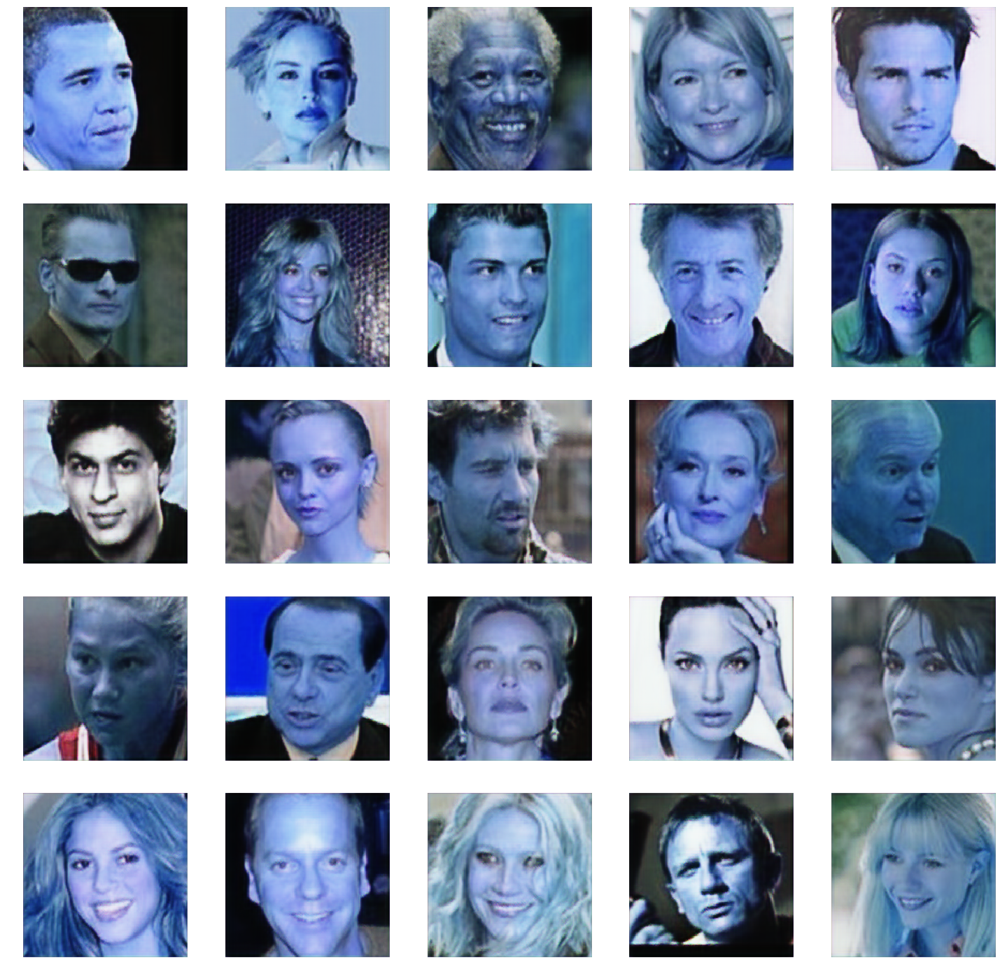

  4%|▍         | 202/5000 [02:48<2:25:24,  1.82s/it]

[0.0063443803, 0.0]


  4%|▍         | 203/5000 [02:49<1:59:21,  1.49s/it]

[0.0065556034, 0.0]


  4%|▍         | 204/5000 [02:50<1:40:49,  1.26s/it]

[0.005066054, 0.0]


  4%|▍         | 205/5000 [02:51<1:27:50,  1.10s/it]

[0.0045329654, 0.0]


  4%|▍         | 206/5000 [02:51<1:18:25,  1.02it/s]

[0.008063613, 0.0]


  4%|▍         | 207/5000 [02:52<1:12:02,  1.11it/s]

[0.0067455885, 0.0]


  4%|▍         | 208/5000 [02:53<1:07:23,  1.19it/s]

[0.010673601, 0.0]


  4%|▍         | 209/5000 [02:53<1:04:24,  1.24it/s]

[0.005529628, 0.0]


  4%|▍         | 210/5000 [02:54<1:02:02,  1.29it/s]

[0.0068594697, 0.0]


  4%|▍         | 211/5000 [02:55<1:00:39,  1.32it/s]

[0.009183194, 0.0]


  4%|▍         | 212/5000 [02:56<59:31,  1.34it/s]  

[0.006518239, 0.0]


  4%|▍         | 213/5000 [02:56<58:47,  1.36it/s]

[0.004635531, 0.0]


  4%|▍         | 214/5000 [02:57<58:04,  1.37it/s]

[0.004360432, 0.0]


  4%|▍         | 215/5000 [02:58<57:50,  1.38it/s]

[0.005758597, 0.0]


  4%|▍         | 216/5000 [02:58<57:19,  1.39it/s]

[0.0048063537, 0.0]


  4%|▍         | 217/5000 [02:59<57:16,  1.39it/s]

[0.004589987, 0.0]


  4%|▍         | 218/5000 [03:00<57:01,  1.40it/s]

[0.011188895, 0.0]


  4%|▍         | 219/5000 [03:01<57:02,  1.40it/s]

[0.005078031, 0.0]


  4%|▍         | 220/5000 [03:01<56:55,  1.40it/s]

[0.008100008, 0.0]


  4%|▍         | 221/5000 [03:02<56:57,  1.40it/s]

[0.0045609586, 0.0]


  4%|▍         | 222/5000 [03:03<56:50,  1.40it/s]

[0.0053302646, 0.0]


  4%|▍         | 223/5000 [03:03<56:58,  1.40it/s]

[0.00551699, 0.0]


  4%|▍         | 224/5000 [03:04<56:47,  1.40it/s]

[0.011858247, 0.0]


  4%|▍         | 225/5000 [03:05<56:51,  1.40it/s]

[0.0060939076, 0.0]


  5%|▍         | 226/5000 [03:06<56:42,  1.40it/s]

[0.004821384, 0.0]


  5%|▍         | 227/5000 [03:06<56:51,  1.40it/s]

[0.0061373194, 0.0]


  5%|▍         | 228/5000 [03:07<56:49,  1.40it/s]

[0.0048688306, 0.0]


  5%|▍         | 229/5000 [03:08<56:52,  1.40it/s]

[0.006552864, 0.0]


  5%|▍         | 230/5000 [03:08<56:38,  1.40it/s]

[0.0059633153, 0.0]


  5%|▍         | 231/5000 [03:09<56:50,  1.40it/s]

[0.010171661, 0.0]


  5%|▍         | 232/5000 [03:10<56:35,  1.40it/s]

[0.0046592816, 0.0]


  5%|▍         | 233/5000 [03:11<56:49,  1.40it/s]

[0.007347158, 0.0]


  5%|▍         | 234/5000 [03:11<56:36,  1.40it/s]

[0.0069756713, 0.0]


  5%|▍         | 235/5000 [03:12<56:43,  1.40it/s]

[0.0041637216, 0.0]


  5%|▍         | 236/5000 [03:13<56:33,  1.40it/s]

[0.0062606074, 0.0]


  5%|▍         | 237/5000 [03:13<56:43,  1.40it/s]

[0.0072238524, 0.0]


  5%|▍         | 238/5000 [03:14<56:27,  1.41it/s]

[0.0049146977, 0.0]


  5%|▍         | 239/5000 [03:15<56:42,  1.40it/s]

[0.005551776, 0.0]


  5%|▍         | 240/5000 [03:16<56:34,  1.40it/s]

[0.0047068084, 0.0]


  5%|▍         | 241/5000 [03:16<56:45,  1.40it/s]

[0.009984094, 0.0]


  5%|▍         | 242/5000 [03:17<56:40,  1.40it/s]

[0.004832675, 0.0]


  5%|▍         | 243/5000 [03:18<56:47,  1.40it/s]

[0.0067427144, 0.0]


  5%|▍         | 244/5000 [03:18<56:30,  1.40it/s]

[0.010954074, 0.0]


  5%|▍         | 245/5000 [03:19<56:48,  1.40it/s]

[0.004750958, 0.0]


  5%|▍         | 246/5000 [03:20<56:35,  1.40it/s]

[0.005736679, 0.0]


  5%|▍         | 247/5000 [03:21<56:49,  1.39it/s]

[0.0043995227, 0.0]


  5%|▍         | 248/5000 [03:21<56:39,  1.40it/s]

[0.00480984, 0.0]


  5%|▍         | 249/5000 [03:22<56:57,  1.39it/s]

[0.0070631322, 0.0]


  5%|▌         | 250/5000 [03:23<56:33,  1.40it/s]

[0.008775149, 0.0]


  5%|▌         | 251/5000 [03:23<56:43,  1.40it/s]

[0.0054253982, 0.0]
250 [G loss: 0.005425, G acc.: 0.00%]


  5%|▌         | 252/5000 [03:24<56:25,  1.40it/s]

[0.00494007, 0.0]


  5%|▌         | 253/5000 [03:25<56:30,  1.40it/s]

[0.005240367, 0.0]


  5%|▌         | 254/5000 [03:26<56:14,  1.41it/s]

[0.0091067385, 0.0]


  5%|▌         | 255/5000 [03:26<56:28,  1.40it/s]

[0.004695388, 0.0]


  5%|▌         | 256/5000 [03:27<56:13,  1.41it/s]

[0.0066665523, 0.0]


  5%|▌         | 257/5000 [03:28<56:26,  1.40it/s]

[0.0042538997, 0.0]


  5%|▌         | 258/5000 [03:28<56:08,  1.41it/s]

[0.007398261, 0.0]


  5%|▌         | 259/5000 [03:29<56:21,  1.40it/s]

[0.0063927714, 0.0]


  5%|▌         | 260/5000 [03:30<56:11,  1.41it/s]

[0.005373368, 0.0]


  5%|▌         | 261/5000 [03:31<56:26,  1.40it/s]

[0.0049751895, 0.0]


  5%|▌         | 262/5000 [03:31<56:13,  1.40it/s]

[0.0050183535, 0.0]


  5%|▌         | 263/5000 [03:32<56:24,  1.40it/s]

[0.00412938, 0.0]


  5%|▌         | 264/5000 [03:33<56:11,  1.40it/s]

[0.0039177937, 0.0]


  5%|▌         | 265/5000 [03:33<56:19,  1.40it/s]

[0.006304472, 0.0]


  5%|▌         | 266/5000 [03:34<56:11,  1.40it/s]

[0.003656769, 0.0]


  5%|▌         | 267/5000 [03:35<56:26,  1.40it/s]

[0.005135729, 0.0]


  5%|▌         | 268/5000 [03:36<56:12,  1.40it/s]

[0.0040781563, 0.0]


  5%|▌         | 269/5000 [03:36<56:24,  1.40it/s]

[0.006984759, 0.0]


  5%|▌         | 270/5000 [03:37<56:07,  1.40it/s]

[0.0052209496, 0.0]


  5%|▌         | 271/5000 [03:38<56:20,  1.40it/s]

[0.0038412637, 0.0]


  5%|▌         | 272/5000 [03:38<56:07,  1.40it/s]

[0.0042628883, 0.0]


  5%|▌         | 273/5000 [03:39<56:21,  1.40it/s]

[0.0051209074, 0.0]


  5%|▌         | 274/5000 [03:40<56:14,  1.40it/s]

[0.0050089085, 0.0]


  6%|▌         | 275/5000 [03:41<56:21,  1.40it/s]

[0.0041970946, 0.0]


  6%|▌         | 276/5000 [03:41<56:07,  1.40it/s]

[0.004518771, 0.0]


  6%|▌         | 277/5000 [03:42<56:16,  1.40it/s]

[0.004255065, 0.0]


  6%|▌         | 278/5000 [03:43<56:00,  1.41it/s]

[0.0043403064, 0.0]


  6%|▌         | 279/5000 [03:43<56:09,  1.40it/s]

[0.0042555006, 0.0]


  6%|▌         | 280/5000 [03:44<56:00,  1.40it/s]

[0.0053351177, 0.0]


  6%|▌         | 281/5000 [03:45<56:15,  1.40it/s]

[0.0042497567, 0.0]


  6%|▌         | 282/5000 [03:46<56:01,  1.40it/s]

[0.0036561291, 0.0]


  6%|▌         | 283/5000 [03:46<56:13,  1.40it/s]

[0.0075379927, 0.0]


  6%|▌         | 284/5000 [03:47<56:02,  1.40it/s]

[0.007815737, 0.0]


  6%|▌         | 285/5000 [03:48<56:10,  1.40it/s]

[0.004195191, 0.0]


  6%|▌         | 286/5000 [03:48<56:11,  1.40it/s]

[0.0044443053, 0.0]


  6%|▌         | 287/5000 [03:49<56:13,  1.40it/s]

[0.0041453056, 0.0]


  6%|▌         | 288/5000 [03:50<56:05,  1.40it/s]

[0.0049080686, 0.0]


  6%|▌         | 289/5000 [03:51<56:09,  1.40it/s]

[0.008735456, 0.0]


  6%|▌         | 290/5000 [03:52<1:01:36,  1.27it/s]

[0.0045034573, 0.0]


  6%|▌         | 291/5000 [03:52<1:00:06,  1.31it/s]

[0.0043945434, 0.0]


  6%|▌         | 292/5000 [03:53<58:51,  1.33it/s]  

[0.005670972, 0.0]


  6%|▌         | 293/5000 [03:54<58:05,  1.35it/s]

[0.0054178196, 0.0]


  6%|▌         | 294/5000 [03:54<57:22,  1.37it/s]

[0.003741889, 0.0]


  6%|▌         | 295/5000 [03:55<57:10,  1.37it/s]

[0.007389132, 0.0]


  6%|▌         | 296/5000 [03:56<56:39,  1.38it/s]

[0.0051673986, 0.0]


  6%|▌         | 297/5000 [03:57<56:29,  1.39it/s]

[0.0037008973, 0.0]


  6%|▌         | 298/5000 [03:57<56:11,  1.39it/s]

[0.012806303, 0.0]


  6%|▌         | 299/5000 [03:58<56:18,  1.39it/s]

[0.005724008, 0.0]


  6%|▌         | 300/5000 [03:59<56:05,  1.40it/s]

[0.0042002476, 0.0]


  6%|▌         | 301/5000 [03:59<56:15,  1.39it/s]

[0.006236474, 0.0]
300 [G loss: 0.006236, G acc.: 0.00%]


  6%|▌         | 302/5000 [04:00<56:00,  1.40it/s]

[0.00504469, 0.0]


  6%|▌         | 303/5000 [04:01<56:08,  1.39it/s]

[0.0039713467, 0.0]


  6%|▌         | 304/5000 [04:02<55:57,  1.40it/s]

[0.00681236, 0.0]


  6%|▌         | 305/5000 [04:02<56:06,  1.39it/s]

[0.0068888064, 0.0]


  6%|▌         | 306/5000 [04:03<55:47,  1.40it/s]

[0.0036117898, 0.0]


  6%|▌         | 307/5000 [04:04<56:04,  1.39it/s]

[0.004746215, 0.0]


  6%|▌         | 308/5000 [04:04<55:48,  1.40it/s]

[0.008991246, 0.0]


  6%|▌         | 309/5000 [04:05<56:00,  1.40it/s]

[0.006626036, 0.0]


  6%|▌         | 310/5000 [04:06<55:46,  1.40it/s]

[0.008694627, 0.0]


  6%|▌         | 311/5000 [04:07<56:00,  1.40it/s]

[0.0044624656, 0.0]


  6%|▌         | 312/5000 [04:07<55:51,  1.40it/s]

[0.007398486, 0.0]


  6%|▋         | 313/5000 [04:08<55:58,  1.40it/s]

[0.0041123526, 0.0]


  6%|▋         | 314/5000 [04:09<55:45,  1.40it/s]

[0.0053196824, 0.0]


  6%|▋         | 315/5000 [04:09<55:57,  1.40it/s]

[0.0046219835, 0.0]


  6%|▋         | 316/5000 [04:10<55:48,  1.40it/s]

[0.004632059, 0.0]


  6%|▋         | 317/5000 [04:11<56:02,  1.39it/s]

[0.008380631, 0.0]


  6%|▋         | 318/5000 [04:12<55:48,  1.40it/s]

[0.0045117056, 0.0]


  6%|▋         | 319/5000 [04:12<56:02,  1.39it/s]

[0.010153179, 0.0]


  6%|▋         | 320/5000 [04:13<55:44,  1.40it/s]

[0.004241927, 0.0]


  6%|▋         | 321/5000 [04:14<55:56,  1.39it/s]

[0.0043992056, 0.0]


  6%|▋         | 322/5000 [04:14<55:39,  1.40it/s]

[0.006123564, 0.0]


  6%|▋         | 323/5000 [04:15<55:53,  1.39it/s]

[0.0041233394, 0.0]


  6%|▋         | 324/5000 [04:16<55:51,  1.40it/s]

[0.0040209293, 0.0]


  6%|▋         | 325/5000 [04:17<55:54,  1.39it/s]

[0.004842358, 0.0]


  7%|▋         | 326/5000 [04:17<55:43,  1.40it/s]

[0.0046065873, 0.0]


  7%|▋         | 327/5000 [04:18<55:54,  1.39it/s]

[0.003524104, 0.0]


  7%|▋         | 328/5000 [04:19<55:42,  1.40it/s]

[0.0045157853, 0.0]


  7%|▋         | 329/5000 [04:19<55:47,  1.40it/s]

[0.0037323814, 0.0]


  7%|▋         | 330/5000 [04:20<55:36,  1.40it/s]

[0.0071112197, 0.0]


  7%|▋         | 331/5000 [04:21<55:41,  1.40it/s]

[0.0042840894, 0.0]


  7%|▋         | 332/5000 [04:22<55:28,  1.40it/s]

[0.0045095445, 0.0]


  7%|▋         | 333/5000 [04:22<55:37,  1.40it/s]

[0.006271726, 0.0]


  7%|▋         | 334/5000 [04:23<55:21,  1.40it/s]

[0.005313643, 0.0]


  7%|▋         | 335/5000 [04:24<55:28,  1.40it/s]

[0.0038820764, 0.0]


  7%|▋         | 336/5000 [04:24<55:18,  1.41it/s]

[0.005076537, 0.0]


  7%|▋         | 337/5000 [04:25<55:25,  1.40it/s]

[0.0051819975, 0.0]


  7%|▋         | 338/5000 [04:26<55:18,  1.41it/s]

[0.0042618113, 0.0]


  7%|▋         | 339/5000 [04:27<55:26,  1.40it/s]

[0.009014675, 0.0]


  7%|▋         | 340/5000 [04:27<55:14,  1.41it/s]

[0.004125962, 0.0]


  7%|▋         | 341/5000 [04:28<55:28,  1.40it/s]

[0.0049336716, 0.0]


  7%|▋         | 342/5000 [04:29<55:20,  1.40it/s]

[0.003763489, 0.0]


  7%|▋         | 343/5000 [04:29<55:31,  1.40it/s]

[0.0036800883, 0.0]


  7%|▋         | 344/5000 [04:30<55:24,  1.40it/s]

[0.0070057013, 0.0]


  7%|▋         | 345/5000 [04:31<55:33,  1.40it/s]

[0.0036215573, 0.0]


  7%|▋         | 346/5000 [04:32<55:22,  1.40it/s]

[0.003766032, 0.0]


  7%|▋         | 347/5000 [04:32<55:41,  1.39it/s]

[0.004881788, 0.0]


  7%|▋         | 348/5000 [04:33<55:32,  1.40it/s]

[0.0050319736, 0.0]


  7%|▋         | 349/5000 [04:34<55:42,  1.39it/s]

[0.0038362446, 0.0]


  7%|▋         | 350/5000 [04:34<55:25,  1.40it/s]

[0.0052717333, 0.0]


  7%|▋         | 351/5000 [04:35<55:34,  1.39it/s]

[0.003940716, 0.0]
350 [G loss: 0.003941, G acc.: 0.00%]


  7%|▋         | 352/5000 [04:36<55:21,  1.40it/s]

[0.004312762, 0.0]


  7%|▋         | 353/5000 [04:37<55:40,  1.39it/s]

[0.0041832146, 0.0]


  7%|▋         | 354/5000 [04:37<55:24,  1.40it/s]

[0.004521092, 0.0]


  7%|▋         | 355/5000 [04:38<55:28,  1.40it/s]

[0.0071998257, 0.0]


  7%|▋         | 356/5000 [04:39<55:19,  1.40it/s]

[0.004283616, 0.0]


  7%|▋         | 357/5000 [04:39<55:28,  1.39it/s]

[0.0037002761, 0.0]


  7%|▋         | 358/5000 [04:40<55:15,  1.40it/s]

[0.0041313274, 0.0]


  7%|▋         | 359/5000 [04:41<55:38,  1.39it/s]

[0.00982053, 0.0]


  7%|▋         | 360/5000 [04:42<55:22,  1.40it/s]

[0.0046006255, 0.0]


  7%|▋         | 361/5000 [04:42<55:24,  1.40it/s]

[0.0034041286, 0.0]


  7%|▋         | 362/5000 [04:43<55:05,  1.40it/s]

[0.0052376147, 0.0]


  7%|▋         | 363/5000 [04:44<55:15,  1.40it/s]

[0.0044011124, 0.0]


  7%|▋         | 364/5000 [04:44<54:58,  1.41it/s]

[0.003986094, 0.0]


  7%|▋         | 365/5000 [04:45<55:16,  1.40it/s]

[0.00394746, 0.0]


  7%|▋         | 366/5000 [04:46<55:04,  1.40it/s]

[0.0038727242, 0.0]


  7%|▋         | 367/5000 [04:47<55:13,  1.40it/s]

[0.0039310297, 0.0]


  7%|▋         | 368/5000 [04:47<55:04,  1.40it/s]

[0.004511168, 0.0]


  7%|▋         | 369/5000 [04:48<55:13,  1.40it/s]

[0.004492006, 0.0]


  7%|▋         | 370/5000 [04:49<55:09,  1.40it/s]

[0.005279806, 0.0]


  7%|▋         | 371/5000 [04:49<55:17,  1.40it/s]

[0.0038191786, 0.0]


  7%|▋         | 372/5000 [04:50<55:11,  1.40it/s]

[0.0038072378, 0.0]


  7%|▋         | 373/5000 [04:51<55:19,  1.39it/s]

[0.0034771739, 0.0]


  7%|▋         | 374/5000 [04:52<55:06,  1.40it/s]

[0.0037441147, 0.0]


  8%|▊         | 375/5000 [04:52<55:17,  1.39it/s]

[0.0037611448, 0.0]


  8%|▊         | 376/5000 [04:53<55:07,  1.40it/s]

[0.0070786914, 0.0]


  8%|▊         | 377/5000 [04:54<55:14,  1.39it/s]

[0.008239166, 0.0]


  8%|▊         | 378/5000 [04:54<54:57,  1.40it/s]

[0.0040049152, 0.0]


  8%|▊         | 379/5000 [04:55<55:06,  1.40it/s]

[0.004317468, 0.0]


  8%|▊         | 380/5000 [04:56<54:53,  1.40it/s]

[0.0048225946, 0.0]


  8%|▊         | 381/5000 [04:57<55:05,  1.40it/s]

[0.0038807841, 0.0]


  8%|▊         | 382/5000 [04:57<54:49,  1.40it/s]

[0.0040621962, 0.0]


  8%|▊         | 383/5000 [04:58<55:03,  1.40it/s]

[0.003489804, 0.0]


  8%|▊         | 384/5000 [04:59<54:54,  1.40it/s]

[0.0045584813, 0.0]


  8%|▊         | 385/5000 [04:59<55:05,  1.40it/s]

[0.003937135, 0.0]


  8%|▊         | 386/5000 [05:00<54:55,  1.40it/s]

[0.0069339075, 0.0]


  8%|▊         | 387/5000 [05:01<55:05,  1.40it/s]

[0.005456664, 0.0]


  8%|▊         | 388/5000 [05:02<54:59,  1.40it/s]

[0.003532832, 0.0]


  8%|▊         | 389/5000 [05:02<55:09,  1.39it/s]

[0.004945686, 0.0]


  8%|▊         | 390/5000 [05:03<55:03,  1.40it/s]

[0.0036225694, 0.0]


  8%|▊         | 391/5000 [05:04<55:09,  1.39it/s]

[0.005342104, 0.0]


  8%|▊         | 392/5000 [05:04<54:54,  1.40it/s]

[0.0030282298, 0.0]


  8%|▊         | 393/5000 [05:05<55:09,  1.39it/s]

[0.0040113805, 0.0]


  8%|▊         | 394/5000 [05:06<54:54,  1.40it/s]

[0.0071132244, 0.0]


  8%|▊         | 395/5000 [05:07<54:58,  1.40it/s]

[0.0034727799, 0.0]


  8%|▊         | 396/5000 [05:07<54:47,  1.40it/s]

[0.0035486154, 0.0]


  8%|▊         | 397/5000 [05:08<54:59,  1.39it/s]

[0.003566615, 0.0]


  8%|▊         | 398/5000 [05:09<54:43,  1.40it/s]

[0.003476889, 0.0]


  8%|▊         | 399/5000 [05:09<54:54,  1.40it/s]

[0.0041261185, 0.0]


  8%|▊         | 400/5000 [05:10<54:43,  1.40it/s]

[0.0048315623, 0.0]
[0.005523529, 0.0]
400 [G loss: 0.005524, G acc.: 0.00%]


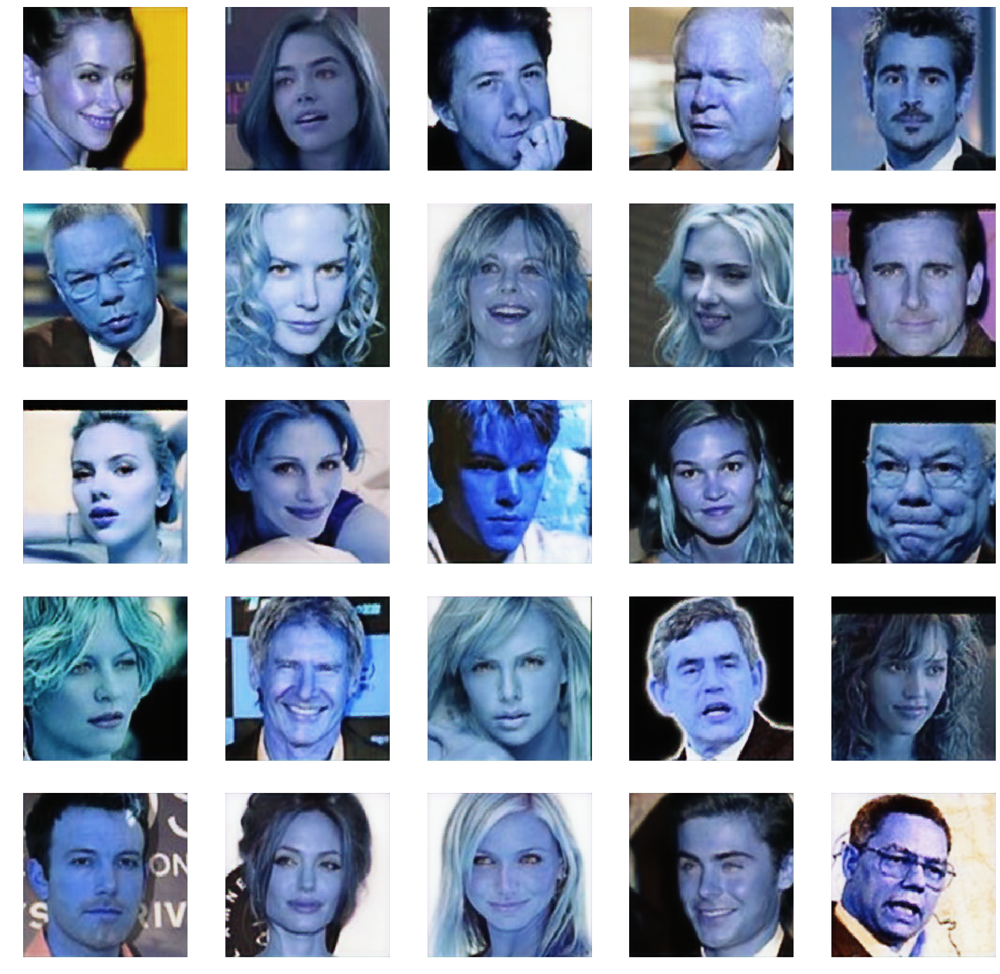

  8%|▊         | 402/5000 [05:17<2:15:03,  1.76s/it]

[0.0041452004, 0.0]


  8%|▊         | 403/5000 [05:17<1:51:32,  1.46s/it]

[0.0030419696, 0.0]


  8%|▊         | 404/5000 [05:18<1:34:35,  1.23s/it]

[0.0048254775, 0.0]


  8%|▊         | 405/5000 [05:19<1:22:49,  1.08s/it]

[0.004888076, 0.0]


  8%|▊         | 406/5000 [05:19<1:14:16,  1.03it/s]

[0.0051331716, 0.0]


  8%|▊         | 407/5000 [05:20<1:08:36,  1.12it/s]

[0.0029446986, 0.0]


  8%|▊         | 408/5000 [05:21<1:04:17,  1.19it/s]

[0.004145155, 0.0]


  8%|▊         | 409/5000 [05:22<1:01:34,  1.24it/s]

[0.0038385815, 0.0]


  8%|▊         | 410/5000 [05:22<59:28,  1.29it/s]  

[0.003398165, 0.0]


  8%|▊         | 411/5000 [05:23<58:11,  1.31it/s]

[0.0067555388, 0.0]


  8%|▊         | 412/5000 [05:24<56:59,  1.34it/s]

[0.0037459591, 0.0]


  8%|▊         | 413/5000 [05:25<56:25,  1.35it/s]

[0.0032157176, 0.0]


  8%|▊         | 414/5000 [05:25<55:47,  1.37it/s]

[0.0057356753, 0.0]


  8%|▊         | 415/5000 [05:26<55:32,  1.38it/s]

[0.0076523568, 0.0]


  8%|▊         | 416/5000 [05:27<55:10,  1.38it/s]

[0.00384503, 0.0]


  8%|▊         | 417/5000 [05:27<55:07,  1.39it/s]

[0.004175056, 0.0]


  8%|▊         | 418/5000 [05:28<54:49,  1.39it/s]

[0.0054420447, 0.0]


  8%|▊         | 419/5000 [05:29<54:55,  1.39it/s]

[0.003356465, 0.0]


  8%|▊         | 420/5000 [05:30<54:36,  1.40it/s]

[0.0043989513, 0.0]


  8%|▊         | 421/5000 [05:30<54:42,  1.39it/s]

[0.005437833, 0.0]


  8%|▊         | 422/5000 [05:31<54:32,  1.40it/s]

[0.005273405, 0.0]


  8%|▊         | 423/5000 [05:32<54:34,  1.40it/s]

[0.0033666699, 0.0]


  8%|▊         | 424/5000 [05:32<54:27,  1.40it/s]

[0.0049421787, 0.0]


  8%|▊         | 425/5000 [05:33<54:38,  1.40it/s]

[0.0034513567, 0.0]


  9%|▊         | 426/5000 [05:34<54:28,  1.40it/s]

[0.005257882, 0.0]


  9%|▊         | 427/5000 [05:35<54:33,  1.40it/s]

[0.0036782748, 0.0]


  9%|▊         | 428/5000 [05:35<54:23,  1.40it/s]

[0.003537349, 0.0]


  9%|▊         | 429/5000 [05:36<54:34,  1.40it/s]

[0.0032392133, 0.0]


  9%|▊         | 430/5000 [05:37<54:23,  1.40it/s]

[0.0087713, 0.0]


  9%|▊         | 431/5000 [05:37<54:30,  1.40it/s]

[0.003498977, 0.0]


  9%|▊         | 432/5000 [05:38<54:20,  1.40it/s]

[0.0047326633, 0.0]


  9%|▊         | 433/5000 [05:39<54:33,  1.40it/s]

[0.0029727963, 0.0]


  9%|▊         | 434/5000 [05:40<54:22,  1.40it/s]

[0.006974264, 0.0]


  9%|▊         | 435/5000 [05:40<54:32,  1.39it/s]

[0.006361721, 0.0]


  9%|▊         | 436/5000 [05:41<54:24,  1.40it/s]

[0.0033951153, 0.0]


  9%|▊         | 437/5000 [05:42<54:33,  1.39it/s]

[0.003791998, 0.0]


  9%|▉         | 438/5000 [05:42<54:16,  1.40it/s]

[0.007320365, 0.0]


  9%|▉         | 439/5000 [05:43<54:30,  1.39it/s]

[0.0032919606, 0.0]


  9%|▉         | 440/5000 [05:44<54:16,  1.40it/s]

[0.0029452743, 0.0]


  9%|▉         | 441/5000 [05:45<54:26,  1.40it/s]

[0.0037680608, 0.0]


  9%|▉         | 442/5000 [05:45<54:18,  1.40it/s]

[0.0031584976, 0.0]


  9%|▉         | 443/5000 [05:46<54:25,  1.40it/s]

[0.0036886486, 0.0]


  9%|▉         | 444/5000 [05:47<54:08,  1.40it/s]

[0.0041657924, 0.0]


  9%|▉         | 445/5000 [05:47<54:26,  1.39it/s]

[0.0043633315, 0.0]


  9%|▉         | 446/5000 [05:48<54:07,  1.40it/s]

[0.0039028078, 0.0]


  9%|▉         | 447/5000 [05:49<54:16,  1.40it/s]

[0.0028496285, 0.0]


  9%|▉         | 448/5000 [05:50<54:01,  1.40it/s]

[0.0036738215, 0.0]


  9%|▉         | 449/5000 [05:50<54:15,  1.40it/s]

[0.0064726775, 0.0]


  9%|▉         | 450/5000 [05:51<54:04,  1.40it/s]

[0.0035630707, 0.0]


  9%|▉         | 451/5000 [05:52<54:14,  1.40it/s]

[0.004278854, 0.0]
450 [G loss: 0.004279, G acc.: 0.00%]


  9%|▉         | 452/5000 [05:52<54:05,  1.40it/s]

[0.002713567, 0.0]


  9%|▉         | 453/5000 [05:53<54:10,  1.40it/s]

[0.0033788471, 0.0]


  9%|▉         | 454/5000 [05:54<54:03,  1.40it/s]

[0.0045459536, 0.0]


  9%|▉         | 455/5000 [05:55<54:12,  1.40it/s]

[0.003637787, 0.0]


  9%|▉         | 456/5000 [05:55<54:14,  1.40it/s]

[0.0033985735, 0.0]


  9%|▉         | 457/5000 [05:56<54:16,  1.40it/s]

[0.003596838, 0.0]


  9%|▉         | 458/5000 [05:57<54:05,  1.40it/s]

[0.0036119064, 0.0]


  9%|▉         | 459/5000 [05:57<54:18,  1.39it/s]

[0.003594375, 0.0]


  9%|▉         | 460/5000 [05:58<54:06,  1.40it/s]

[0.0050118254, 0.0]


  9%|▉         | 461/5000 [05:59<54:18,  1.39it/s]

[0.0031285114, 0.0]


  9%|▉         | 462/5000 [06:00<54:01,  1.40it/s]

[0.0028307226, 0.0]


  9%|▉         | 463/5000 [06:00<54:04,  1.40it/s]

[0.003369251, 0.0]


  9%|▉         | 464/5000 [06:01<53:57,  1.40it/s]

[0.0029313061, 0.0]


  9%|▉         | 465/5000 [06:02<54:04,  1.40it/s]

[0.003840568, 0.0]


  9%|▉         | 466/5000 [06:02<53:50,  1.40it/s]

[0.0030856149, 0.0]


  9%|▉         | 467/5000 [06:03<53:57,  1.40it/s]

[0.009119106, 0.0]


  9%|▉         | 468/5000 [06:04<53:47,  1.40it/s]

[0.0037290286, 0.0]


  9%|▉         | 469/5000 [06:05<53:57,  1.40it/s]

[0.0057570594, 0.0]


  9%|▉         | 470/5000 [06:05<53:53,  1.40it/s]

[0.0034325568, 0.0]


  9%|▉         | 471/5000 [06:06<54:05,  1.40it/s]

[0.008654647, 0.0]


  9%|▉         | 472/5000 [06:07<53:51,  1.40it/s]

[0.004065956, 0.0]


  9%|▉         | 473/5000 [06:07<54:06,  1.39it/s]

[0.0030748, 0.0]


  9%|▉         | 474/5000 [06:08<54:00,  1.40it/s]

[0.0030082115, 0.0]


 10%|▉         | 475/5000 [06:09<54:03,  1.40it/s]

[0.0029829838, 0.0]


 10%|▉         | 476/5000 [06:10<53:50,  1.40it/s]

[0.003640883, 0.0]


 10%|▉         | 477/5000 [06:10<53:58,  1.40it/s]

[0.0032103518, 0.0]


 10%|▉         | 478/5000 [06:11<53:45,  1.40it/s]

[0.006052747, 0.0]


 10%|▉         | 479/5000 [06:12<53:56,  1.40it/s]

[0.0033726671, 0.0]


 10%|▉         | 480/5000 [06:12<53:49,  1.40it/s]

[0.0034296392, 0.0]


 10%|▉         | 481/5000 [06:13<53:54,  1.40it/s]

[0.005609519, 0.0]


 10%|▉         | 482/5000 [06:14<53:43,  1.40it/s]

[0.004216203, 0.0]


 10%|▉         | 483/5000 [06:15<53:50,  1.40it/s]

[0.0034947314, 0.0]


 10%|▉         | 484/5000 [06:15<53:41,  1.40it/s]

[0.0035968532, 0.0]


 10%|▉         | 485/5000 [06:16<53:45,  1.40it/s]

[0.006467916, 0.0]


 10%|▉         | 486/5000 [06:17<53:46,  1.40it/s]

[0.0025704026, 0.0]


 10%|▉         | 487/5000 [06:17<53:48,  1.40it/s]

[0.003316643, 0.0]


 10%|▉         | 488/5000 [06:18<53:41,  1.40it/s]

[0.0031422854, 0.0]


 10%|▉         | 489/5000 [06:19<53:45,  1.40it/s]

[0.0035177201, 0.0]


 10%|▉         | 490/5000 [06:20<53:29,  1.41it/s]

[0.0040139183, 0.0]


 10%|▉         | 491/5000 [06:20<53:37,  1.40it/s]

[0.0031485718, 0.0]


 10%|▉         | 492/5000 [06:21<53:32,  1.40it/s]

[0.0036609618, 0.0]


 10%|▉         | 493/5000 [06:22<53:36,  1.40it/s]

[0.0027238945, 0.0]


 10%|▉         | 494/5000 [06:22<53:27,  1.40it/s]

[0.008340303, 0.0]


 10%|▉         | 495/5000 [06:23<53:37,  1.40it/s]

[0.003945539, 0.0]


 10%|▉         | 496/5000 [06:24<53:32,  1.40it/s]

[0.0039452277, 0.0]


 10%|▉         | 497/5000 [06:25<53:45,  1.40it/s]

[0.0044209925, 0.0]


 10%|▉         | 498/5000 [06:25<53:28,  1.40it/s]

[0.0051020887, 0.0]


 10%|▉         | 499/5000 [06:26<53:31,  1.40it/s]

[0.0032155009, 0.0]


 10%|█         | 500/5000 [06:27<53:19,  1.41it/s]

[0.0033744597, 0.0]


 10%|█         | 501/5000 [06:27<53:37,  1.40it/s]

[0.0026605616, 0.0]
500 [G loss: 0.002661, G acc.: 0.00%]


 10%|█         | 502/5000 [06:28<53:25,  1.40it/s]

[0.003133601, 0.0]


 10%|█         | 503/5000 [06:29<53:36,  1.40it/s]

[0.0033977942, 0.0]


 10%|█         | 504/5000 [06:30<53:23,  1.40it/s]

[0.0060570543, 0.0]


 10%|█         | 505/5000 [06:30<53:36,  1.40it/s]

[0.003044899, 0.0]


 10%|█         | 506/5000 [06:31<53:23,  1.40it/s]

[0.013349888, 0.0]


 10%|█         | 507/5000 [06:32<53:31,  1.40it/s]

[0.00916897, 0.0]


 10%|█         | 508/5000 [06:32<53:23,  1.40it/s]

[0.003264511, 0.0]


 10%|█         | 509/5000 [06:33<53:30,  1.40it/s]

[0.004796436, 0.0]


 10%|█         | 510/5000 [06:34<53:21,  1.40it/s]

[0.005702182, 0.0]


 10%|█         | 511/5000 [06:35<53:33,  1.40it/s]

[0.0042736284, 0.0]


 10%|█         | 512/5000 [06:35<53:56,  1.39it/s]

[0.0031018702, 0.0]


 10%|█         | 513/5000 [06:36<53:58,  1.39it/s]

[0.0044400753, 0.0]


 10%|█         | 514/5000 [06:37<53:37,  1.39it/s]

[0.003660695, 0.0]


 10%|█         | 515/5000 [06:37<53:45,  1.39it/s]

[0.011160652, 0.0]


 10%|█         | 516/5000 [06:38<53:32,  1.40it/s]

[0.010607863, 0.0]


 10%|█         | 517/5000 [06:39<53:36,  1.39it/s]

[0.003041467, 0.0]


 10%|█         | 518/5000 [06:40<53:25,  1.40it/s]

[0.0052527334, 0.0]


 10%|█         | 519/5000 [06:40<53:31,  1.40it/s]

[0.0036654058, 0.0]


 10%|█         | 520/5000 [06:41<53:21,  1.40it/s]

[0.004133758, 0.0]


 10%|█         | 521/5000 [06:42<53:26,  1.40it/s]

[0.0027071622, 0.0]


 10%|█         | 522/5000 [06:42<53:13,  1.40it/s]

[0.007379448, 0.0]


 10%|█         | 523/5000 [06:43<53:31,  1.39it/s]

[0.00402747, 0.0]


 10%|█         | 524/5000 [06:44<53:15,  1.40it/s]

[0.006596372, 0.0]


 10%|█         | 525/5000 [06:45<53:22,  1.40it/s]

[0.003285519, 0.0]


 11%|█         | 526/5000 [06:45<53:12,  1.40it/s]

[0.002524684, 0.0]


 11%|█         | 527/5000 [06:46<53:20,  1.40it/s]

[0.004279899, 0.0]


 11%|█         | 528/5000 [06:47<53:14,  1.40it/s]

[0.003400737, 0.0]


 11%|█         | 529/5000 [06:47<53:22,  1.40it/s]

[0.003945033, 0.0]


 11%|█         | 530/5000 [06:48<53:10,  1.40it/s]

[0.0041361493, 0.0]


 11%|█         | 531/5000 [06:49<53:16,  1.40it/s]

[0.0039351643, 0.0]


 11%|█         | 532/5000 [06:50<53:00,  1.40it/s]

[0.0031942872, 0.0]


 11%|█         | 533/5000 [06:50<53:17,  1.40it/s]

[0.003705329, 0.0]


 11%|█         | 534/5000 [06:51<53:01,  1.40it/s]

[0.0033115768, 0.0]


 11%|█         | 535/5000 [06:52<53:13,  1.40it/s]

[0.0037868363, 0.0]


 11%|█         | 536/5000 [06:52<53:00,  1.40it/s]

[0.0031485003, 0.0]


 11%|█         | 537/5000 [06:53<53:13,  1.40it/s]

[0.0047834753, 0.0]


 11%|█         | 538/5000 [06:54<53:04,  1.40it/s]

[0.0070300195, 0.0]


 11%|█         | 539/5000 [06:55<53:14,  1.40it/s]

[0.0054905233, 0.0]


 11%|█         | 540/5000 [06:55<53:01,  1.40it/s]

[0.0032410268, 0.0]


 11%|█         | 541/5000 [06:56<53:13,  1.40it/s]

[0.0035243658, 0.0]


 11%|█         | 542/5000 [06:57<52:58,  1.40it/s]

[0.008087712, 0.0]


 11%|█         | 543/5000 [06:57<53:16,  1.39it/s]

[0.002649241, 0.0]


 11%|█         | 544/5000 [06:58<53:08,  1.40it/s]

[0.005129653, 0.0]


 11%|█         | 545/5000 [06:59<53:20,  1.39it/s]

[0.0026820707, 0.0]


 11%|█         | 546/5000 [07:00<53:06,  1.40it/s]

[0.003375724, 0.0]


 11%|█         | 547/5000 [07:00<53:11,  1.40it/s]

[0.0055380976, 0.0]


 11%|█         | 548/5000 [07:01<52:57,  1.40it/s]

[0.0036145407, 0.0]


 11%|█         | 549/5000 [07:02<53:06,  1.40it/s]

[0.0028789123, 0.0]


 11%|█         | 550/5000 [07:02<52:54,  1.40it/s]

[0.0074886894, 0.0]


 11%|█         | 551/5000 [07:03<53:03,  1.40it/s]

[0.0034313241, 0.0]
550 [G loss: 0.003431, G acc.: 0.00%]


 11%|█         | 552/5000 [07:04<52:50,  1.40it/s]

[0.0030873972, 0.0]


 11%|█         | 553/5000 [07:05<53:09,  1.39it/s]

[0.0030531473, 0.0]


 11%|█         | 554/5000 [07:05<52:55,  1.40it/s]

[0.007644624, 0.0]


 11%|█         | 555/5000 [07:06<53:03,  1.40it/s]

[0.0027686935, 0.0]


 11%|█         | 556/5000 [07:07<52:49,  1.40it/s]

[0.0030219806, 0.0]


 11%|█         | 557/5000 [07:07<52:56,  1.40it/s]

[0.0030644785, 0.0]


 11%|█         | 558/5000 [07:08<52:42,  1.40it/s]

[0.00552845, 0.0]


 11%|█         | 559/5000 [07:09<52:56,  1.40it/s]

[0.0028240872, 0.0]


 11%|█         | 560/5000 [07:10<52:46,  1.40it/s]

[0.003373393, 0.0]


 11%|█         | 561/5000 [07:10<52:59,  1.40it/s]

[0.0031884997, 0.0]


 11%|█         | 562/5000 [07:11<52:52,  1.40it/s]

[0.004901166, 0.0]


 11%|█▏        | 563/5000 [07:12<53:03,  1.39it/s]

[0.0029973092, 0.0]


 11%|█▏        | 564/5000 [07:12<52:53,  1.40it/s]

[0.0043883976, 0.0]


 11%|█▏        | 565/5000 [07:13<53:03,  1.39it/s]

[0.003488002, 0.0]


 11%|█▏        | 566/5000 [07:14<52:49,  1.40it/s]

[0.00832335, 0.0]


 11%|█▏        | 567/5000 [07:15<52:57,  1.40it/s]

[0.0062684747, 0.0]


 11%|█▏        | 568/5000 [07:15<52:46,  1.40it/s]

[0.0028664046, 0.0]


 11%|█▏        | 569/5000 [07:16<52:53,  1.40it/s]

[0.005764004, 0.0]


 11%|█▏        | 570/5000 [07:17<52:44,  1.40it/s]

[0.0034351854, 0.0]


 11%|█▏        | 571/5000 [07:17<52:54,  1.39it/s]

[0.002857747, 0.0]


 11%|█▏        | 572/5000 [07:18<52:44,  1.40it/s]

[0.002677243, 0.0]


 11%|█▏        | 573/5000 [07:19<52:51,  1.40it/s]

[0.0028414407, 0.0]


 11%|█▏        | 574/5000 [07:20<52:37,  1.40it/s]

[0.0058770934, 0.0]


 12%|█▏        | 575/5000 [07:20<52:49,  1.40it/s]

[0.002722459, 0.0]


 12%|█▏        | 576/5000 [07:21<52:34,  1.40it/s]

[0.0033874214, 0.0]


 12%|█▏        | 577/5000 [07:22<52:51,  1.39it/s]

[0.0043649897, 0.0]


 12%|█▏        | 578/5000 [07:22<52:43,  1.40it/s]

[0.0036746848, 0.0]


 12%|█▏        | 579/5000 [07:23<52:53,  1.39it/s]

[0.0030080471, 0.0]


 12%|█▏        | 580/5000 [07:24<52:40,  1.40it/s]

[0.003526338, 0.0]


 12%|█▏        | 581/5000 [07:25<52:45,  1.40it/s]

[0.003264606, 0.0]


 12%|█▏        | 582/5000 [07:25<52:35,  1.40it/s]

[0.0029836048, 0.0]


 12%|█▏        | 583/5000 [07:26<52:40,  1.40it/s]

[0.0043529356, 0.0]


 12%|█▏        | 584/5000 [07:27<52:39,  1.40it/s]

[0.005073562, 0.0]


 12%|█▏        | 585/5000 [07:27<52:48,  1.39it/s]

[0.0031429145, 0.0]


 12%|█▏        | 586/5000 [07:28<52:37,  1.40it/s]

[0.003816081, 0.0]


 12%|█▏        | 587/5000 [07:29<52:43,  1.40it/s]

[0.0035793611, 0.0]


 12%|█▏        | 588/5000 [07:30<52:39,  1.40it/s]

[0.003346582, 0.0]


 12%|█▏        | 589/5000 [07:30<52:46,  1.39it/s]

[0.002917971, 0.0]


 12%|█▏        | 590/5000 [07:31<52:38,  1.40it/s]

[0.0030140397, 0.0]


 12%|█▏        | 591/5000 [07:32<52:45,  1.39it/s]

[0.0042248704, 0.0]


 12%|█▏        | 592/5000 [07:33<52:30,  1.40it/s]

[0.004696649, 0.0]


 12%|█▏        | 593/5000 [07:33<52:42,  1.39it/s]

[0.004270761, 0.0]


 12%|█▏        | 594/5000 [07:34<52:27,  1.40it/s]

[0.0043142065, 0.0]


 12%|█▏        | 595/5000 [07:35<52:35,  1.40it/s]

[0.002927162, 0.0]


 12%|█▏        | 596/5000 [07:35<52:22,  1.40it/s]

[0.0042439993, 0.0]


 12%|█▏        | 597/5000 [07:36<52:35,  1.40it/s]

[0.0051993863, 0.0]


 12%|█▏        | 598/5000 [07:37<52:20,  1.40it/s]

[0.0026337951, 0.0]


 12%|█▏        | 599/5000 [07:38<52:27,  1.40it/s]

[0.0040729344, 0.0]


 12%|█▏        | 600/5000 [07:38<52:23,  1.40it/s]

[0.00863166, 0.0]
[0.0031112947, 0.0]
600 [G loss: 0.003111, G acc.: 0.00%]


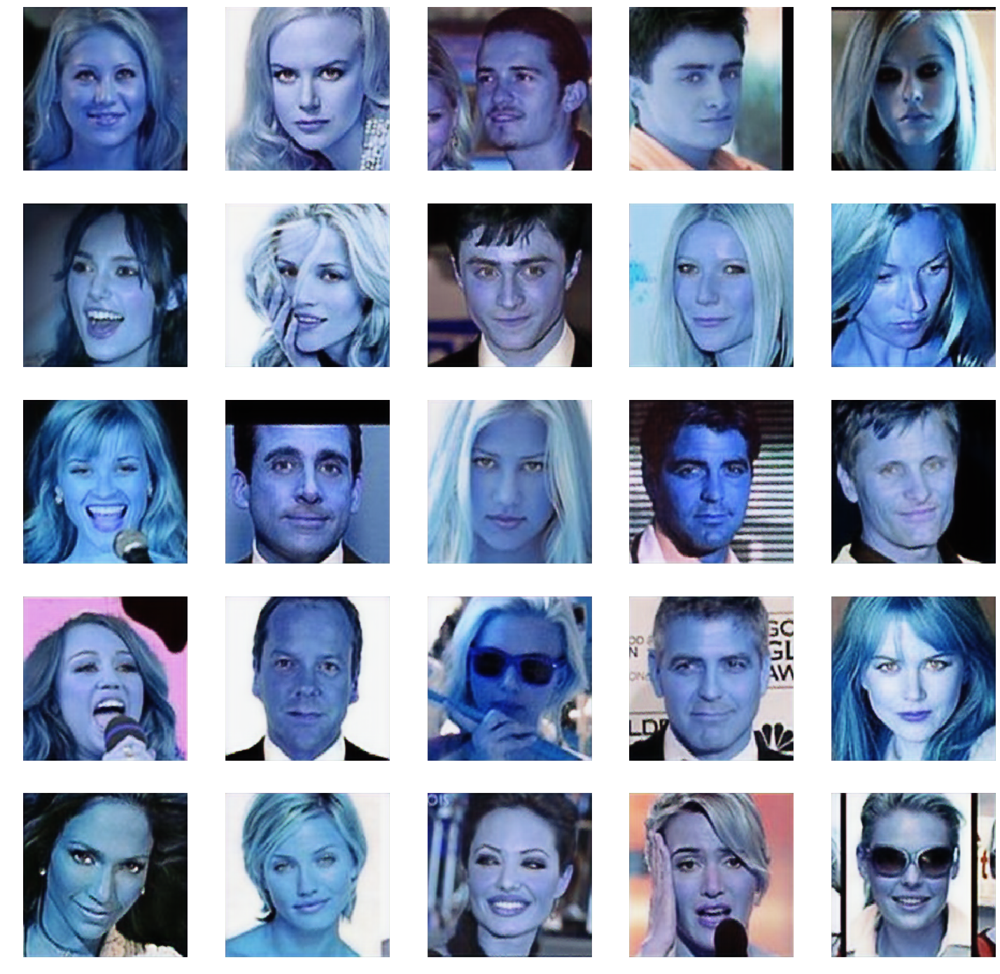

 12%|█▏        | 602/5000 [07:45<2:13:26,  1.82s/it]

[0.002968807, 0.0]


 12%|█▏        | 603/5000 [07:46<1:49:34,  1.50s/it]

[0.0046606264, 0.0]


 12%|█▏        | 604/5000 [07:46<1:32:27,  1.26s/it]

[0.0026075877, 0.0]


 12%|█▏        | 605/5000 [07:47<1:20:38,  1.10s/it]

[0.0043401434, 0.0]


 12%|█▏        | 606/5000 [07:48<1:12:00,  1.02it/s]

[0.0035459637, 0.0]


 12%|█▏        | 607/5000 [07:48<1:06:15,  1.10it/s]

[0.004879657, 0.0]


 12%|█▏        | 608/5000 [07:49<1:01:55,  1.18it/s]

[0.005225837, 0.0]


 12%|█▏        | 609/5000 [07:50<59:05,  1.24it/s]  

[0.0031013459, 0.0]


 12%|█▏        | 610/5000 [07:51<56:54,  1.29it/s]

[0.011814252, 0.0]


 12%|█▏        | 611/5000 [07:51<55:39,  1.31it/s]

[0.003535983, 0.0]


 12%|█▏        | 612/5000 [07:52<54:27,  1.34it/s]

[0.0035696805, 0.0]


 12%|█▏        | 613/5000 [07:53<53:57,  1.36it/s]

[0.0038603412, 0.0]


 12%|█▏        | 614/5000 [07:53<53:17,  1.37it/s]

[0.0043410244, 0.0]


 12%|█▏        | 615/5000 [07:54<53:03,  1.38it/s]

[0.0028548576, 0.0]


 12%|█▏        | 616/5000 [07:55<52:42,  1.39it/s]

[0.0026112348, 0.0]


 12%|█▏        | 617/5000 [07:56<52:35,  1.39it/s]

[0.0046451385, 0.0]


 12%|█▏        | 618/5000 [07:56<52:21,  1.39it/s]

[0.0035082418, 0.0]


 12%|█▏        | 619/5000 [07:57<52:24,  1.39it/s]

[0.007900273, 0.0]


 12%|█▏        | 620/5000 [07:58<52:15,  1.40it/s]

[0.0041660457, 0.0]


 12%|█▏        | 621/5000 [07:58<52:19,  1.39it/s]

[0.002955897, 0.0]


 12%|█▏        | 622/5000 [07:59<52:04,  1.40it/s]

[0.0064574056, 0.0]


 12%|█▏        | 623/5000 [08:00<52:11,  1.40it/s]

[0.002755806, 0.0]


 12%|█▏        | 624/5000 [08:01<52:02,  1.40it/s]

[0.008513092, 0.0]


 12%|█▎        | 625/5000 [08:01<52:35,  1.39it/s]

[0.0024986055, 0.0]


 13%|█▎        | 626/5000 [08:02<52:20,  1.39it/s]

[0.003706583, 0.0]


 13%|█▎        | 627/5000 [08:03<52:29,  1.39it/s]

[0.0034759673, 0.0]


 13%|█▎        | 628/5000 [08:04<52:11,  1.40it/s]

[0.0037389742, 0.0]


 13%|█▎        | 629/5000 [08:04<52:08,  1.40it/s]

[0.0029310626, 0.0]


 13%|█▎        | 630/5000 [08:05<52:02,  1.40it/s]

[0.003414052, 0.0]


 13%|█▎        | 631/5000 [08:06<52:08,  1.40it/s]

[0.0027379564, 0.0]


 13%|█▎        | 632/5000 [08:06<51:59,  1.40it/s]

[0.0077977353, 0.0]


 13%|█▎        | 633/5000 [08:07<52:11,  1.39it/s]

[0.010020073, 0.0]


 13%|█▎        | 634/5000 [08:08<51:57,  1.40it/s]

[0.0026883793, 0.0]


 13%|█▎        | 635/5000 [08:09<52:15,  1.39it/s]

[0.0070628542, 0.0]


 13%|█▎        | 636/5000 [08:09<51:58,  1.40it/s]

[0.003303213, 0.0]


 13%|█▎        | 637/5000 [08:10<52:00,  1.40it/s]

[0.0037519315, 0.0]


 13%|█▎        | 638/5000 [08:11<51:54,  1.40it/s]

[0.006754723, 0.0]


 13%|█▎        | 639/5000 [08:11<52:07,  1.39it/s]

[0.003809766, 0.0]


 13%|█▎        | 640/5000 [08:12<51:58,  1.40it/s]

[0.0028444137, 0.0]


 13%|█▎        | 641/5000 [08:13<52:10,  1.39it/s]

[0.0063410006, 0.0]


 13%|█▎        | 642/5000 [08:14<51:53,  1.40it/s]

[0.0043663336, 0.0]


 13%|█▎        | 643/5000 [08:14<51:54,  1.40it/s]

[0.0034514852, 0.0]


 13%|█▎        | 644/5000 [08:15<51:46,  1.40it/s]

[0.0036189072, 0.0]


 13%|█▎        | 645/5000 [08:16<51:49,  1.40it/s]

[0.004586904, 0.0]


 13%|█▎        | 646/5000 [08:16<51:34,  1.41it/s]

[0.003565262, 0.0]


 13%|█▎        | 647/5000 [08:17<51:42,  1.40it/s]

[0.0046370467, 0.0]


 13%|█▎        | 648/5000 [08:18<51:38,  1.40it/s]

[0.005147652, 0.0]


 13%|█▎        | 649/5000 [08:19<51:46,  1.40it/s]

[0.0033436588, 0.0]


 13%|█▎        | 650/5000 [08:19<51:35,  1.41it/s]

[0.0029077032, 0.0]


 13%|█▎        | 651/5000 [08:20<51:50,  1.40it/s]

[0.002664144, 0.0]
650 [G loss: 0.002664, G acc.: 0.00%]


 13%|█▎        | 652/5000 [08:21<51:43,  1.40it/s]

[0.0024878709, 0.0]


 13%|█▎        | 653/5000 [08:21<51:49,  1.40it/s]

[0.003155009, 0.0]


 13%|█▎        | 654/5000 [08:22<51:42,  1.40it/s]

[0.0046193385, 0.0]


 13%|█▎        | 655/5000 [08:23<51:52,  1.40it/s]

[0.0029328617, 0.0]


 13%|█▎        | 656/5000 [08:24<51:48,  1.40it/s]

[0.002843936, 0.0]


 13%|█▎        | 657/5000 [08:24<52:21,  1.38it/s]

[0.0026228623, 0.0]


 13%|█▎        | 658/5000 [08:25<52:03,  1.39it/s]

[0.003132651, 0.0]


 13%|█▎        | 659/5000 [08:26<52:00,  1.39it/s]

[0.004731185, 0.0]


 13%|█▎        | 660/5000 [08:26<51:43,  1.40it/s]

[0.0023803131, 0.0]


 13%|█▎        | 661/5000 [08:27<51:52,  1.39it/s]

[0.0064226096, 0.0]


 13%|█▎        | 662/5000 [08:28<51:40,  1.40it/s]

[0.0036643515, 0.0]


 13%|█▎        | 663/5000 [08:29<51:48,  1.40it/s]

[0.00350996, 0.0]


 13%|█▎        | 664/5000 [08:29<51:37,  1.40it/s]

[0.0026262293, 0.0]


 13%|█▎        | 665/5000 [08:30<51:44,  1.40it/s]

[0.0027886513, 0.0]


 13%|█▎        | 666/5000 [08:31<51:33,  1.40it/s]

[0.0035333403, 0.0]


 13%|█▎        | 667/5000 [08:31<51:42,  1.40it/s]

[0.004199678, 0.0]


 13%|█▎        | 668/5000 [08:32<51:29,  1.40it/s]

[0.003979877, 0.0]


 13%|█▎        | 669/5000 [08:33<51:37,  1.40it/s]

[0.0023377752, 0.0]


 13%|█▎        | 670/5000 [08:34<51:28,  1.40it/s]

[0.0046792845, 0.0]


 13%|█▎        | 671/5000 [08:34<51:43,  1.40it/s]

[0.0036065648, 0.0]


 13%|█▎        | 672/5000 [08:35<51:31,  1.40it/s]

[0.0037870945, 0.0]


 13%|█▎        | 673/5000 [08:36<51:38,  1.40it/s]

[0.0022832775, 0.0]


 13%|█▎        | 674/5000 [08:36<51:33,  1.40it/s]

[0.0036500394, 0.0]


 14%|█▎        | 675/5000 [08:37<51:42,  1.39it/s]

[0.0045516468, 0.0]


 14%|█▎        | 676/5000 [08:38<51:28,  1.40it/s]

[0.0029732517, 0.0]


 14%|█▎        | 677/5000 [08:39<51:35,  1.40it/s]

[0.0026566028, 0.0]


 14%|█▎        | 678/5000 [08:39<51:20,  1.40it/s]

[0.0037314792, 0.0]


 14%|█▎        | 679/5000 [08:40<51:28,  1.40it/s]

[0.0028340872, 0.0]


 14%|█▎        | 680/5000 [08:41<51:10,  1.41it/s]

[0.0036926628, 0.0]


 14%|█▎        | 681/5000 [08:41<51:21,  1.40it/s]

[0.0033171508, 0.0]


 14%|█▎        | 682/5000 [08:42<51:16,  1.40it/s]

[0.0022673754, 0.0]


 14%|█▎        | 683/5000 [08:43<51:26,  1.40it/s]

[0.0028213272, 0.0]


 14%|█▎        | 684/5000 [08:44<51:10,  1.41it/s]

[0.002987692, 0.0]


 14%|█▎        | 685/5000 [08:44<51:20,  1.40it/s]

[0.003533725, 0.0]


 14%|█▎        | 686/5000 [08:45<51:13,  1.40it/s]

[0.0050772456, 0.0]


 14%|█▎        | 687/5000 [08:46<51:26,  1.40it/s]

[0.0068942173, 0.0]


 14%|█▍        | 688/5000 [08:46<51:16,  1.40it/s]

[0.0030430465, 0.0]


 14%|█▍        | 689/5000 [08:47<51:28,  1.40it/s]

[0.0026623555, 0.0]


 14%|█▍        | 690/5000 [08:48<51:13,  1.40it/s]

[0.0035767797, 0.0]


 14%|█▍        | 691/5000 [08:49<51:27,  1.40it/s]

[0.0028681231, 0.0]


 14%|█▍        | 692/5000 [08:49<51:15,  1.40it/s]

[0.004194285, 0.0]


 14%|█▍        | 693/5000 [08:50<51:23,  1.40it/s]

[0.0037938803, 0.0]


 14%|█▍        | 694/5000 [08:51<51:17,  1.40it/s]

[0.0034373743, 0.0]


 14%|█▍        | 695/5000 [08:51<51:28,  1.39it/s]

[0.003820544, 0.0]


 14%|█▍        | 696/5000 [08:52<51:16,  1.40it/s]

[0.0038354415, 0.0]


 14%|█▍        | 697/5000 [08:53<51:19,  1.40it/s]

[0.0024379252, 0.0]


 14%|█▍        | 698/5000 [08:54<51:12,  1.40it/s]

[0.004128726, 0.0]


 14%|█▍        | 699/5000 [08:54<51:23,  1.39it/s]

[0.003266606, 0.0]


 14%|█▍        | 700/5000 [08:55<51:10,  1.40it/s]

[0.0023398383, 0.0]


 14%|█▍        | 701/5000 [08:56<51:24,  1.39it/s]

[0.002619779, 0.0]
700 [G loss: 0.002620, G acc.: 0.00%]


 14%|█▍        | 702/5000 [08:56<51:14,  1.40it/s]

[0.003580165, 0.0]


 14%|█▍        | 703/5000 [08:57<51:21,  1.39it/s]

[0.0055204374, 0.0]


 14%|█▍        | 704/5000 [08:58<51:05,  1.40it/s]

[0.0057917, 0.0]


 14%|█▍        | 705/5000 [08:59<51:18,  1.40it/s]

[0.0025630463, 0.0]


 14%|█▍        | 706/5000 [08:59<51:08,  1.40it/s]

[0.002705707, 0.0]


 14%|█▍        | 707/5000 [09:00<51:19,  1.39it/s]

[0.004869375, 0.0]


 14%|█▍        | 708/5000 [09:01<51:07,  1.40it/s]

[0.0052737813, 0.0]


 14%|█▍        | 709/5000 [09:01<51:12,  1.40it/s]

[0.0026033567, 0.0]


 14%|█▍        | 710/5000 [09:02<51:02,  1.40it/s]

[0.0038176922, 0.0]


 14%|█▍        | 711/5000 [09:03<51:17,  1.39it/s]

[0.0047088964, 0.0]


 14%|█▍        | 712/5000 [09:04<50:59,  1.40it/s]

[0.005207378, 0.0]


 14%|█▍        | 713/5000 [09:04<51:08,  1.40it/s]

[0.0034264224, 0.0]


 14%|█▍        | 714/5000 [09:05<51:03,  1.40it/s]

[0.0029866826, 0.0]


 14%|█▍        | 715/5000 [09:06<51:05,  1.40it/s]

[0.0024418642, 0.0]


 14%|█▍        | 716/5000 [09:06<50:59,  1.40it/s]

[0.0030914543, 0.0]


 14%|█▍        | 717/5000 [09:07<51:14,  1.39it/s]

[0.0054342574, 0.0]


 14%|█▍        | 718/5000 [09:08<51:02,  1.40it/s]

[0.0024527735, 0.0]


 14%|█▍        | 719/5000 [09:09<51:15,  1.39it/s]

[0.002183215, 0.0]


 14%|█▍        | 720/5000 [09:09<51:03,  1.40it/s]

[0.006181655, 0.0]


 14%|█▍        | 721/5000 [09:10<51:07,  1.40it/s]

[0.0058763702, 0.0]


 14%|█▍        | 722/5000 [09:11<50:53,  1.40it/s]

[0.0033889073, 0.0]


 14%|█▍        | 723/5000 [09:11<51:03,  1.40it/s]

[0.002358268, 0.0]


 14%|█▍        | 724/5000 [09:12<50:52,  1.40it/s]

[0.0038387715, 0.0]


 14%|█▍        | 725/5000 [09:13<51:03,  1.40it/s]

[0.0027676038, 0.0]


 15%|█▍        | 726/5000 [09:14<50:57,  1.40it/s]

[0.0037540344, 0.0]


 15%|█▍        | 727/5000 [09:14<50:52,  1.40it/s]

[0.0027739983, 0.0]


 15%|█▍        | 728/5000 [09:15<50:39,  1.41it/s]

[0.0048699416, 0.0]


 15%|█▍        | 729/5000 [09:16<50:49,  1.40it/s]

[0.0029980936, 0.0]


 15%|█▍        | 730/5000 [09:16<50:36,  1.41it/s]

[0.003156798, 0.0]


 15%|█▍        | 731/5000 [09:17<50:53,  1.40it/s]

[0.0028437944, 0.0]


 15%|█▍        | 732/5000 [09:18<50:49,  1.40it/s]

[0.0026485152, 0.0]


 15%|█▍        | 733/5000 [09:19<50:55,  1.40it/s]

[0.0031876315, 0.0]


 15%|█▍        | 734/5000 [09:19<50:51,  1.40it/s]

[0.0026497673, 0.0]


 15%|█▍        | 735/5000 [09:20<51:05,  1.39it/s]

[0.003480367, 0.0]


 15%|█▍        | 736/5000 [09:21<50:49,  1.40it/s]

[0.004092908, 0.0]


 15%|█▍        | 737/5000 [09:21<50:51,  1.40it/s]

[0.0042857104, 0.0]


 15%|█▍        | 738/5000 [09:22<50:36,  1.40it/s]

[0.0036995122, 0.0]


 15%|█▍        | 739/5000 [09:23<50:43,  1.40it/s]

[0.00533505, 0.0]


 15%|█▍        | 740/5000 [09:24<50:37,  1.40it/s]

[0.0046826205, 0.0]


 15%|█▍        | 741/5000 [09:24<50:53,  1.39it/s]

[0.0036865864, 0.0]


 15%|█▍        | 742/5000 [09:25<50:42,  1.40it/s]

[0.0027142116, 0.0]


 15%|█▍        | 743/5000 [09:26<51:01,  1.39it/s]

[0.0027142642, 0.0]


 15%|█▍        | 744/5000 [09:26<50:48,  1.40it/s]

[0.003096476, 0.0]


 15%|█▍        | 745/5000 [09:27<50:52,  1.39it/s]

[0.0027604036, 0.0]


 15%|█▍        | 746/5000 [09:28<50:35,  1.40it/s]

[0.0030932426, 0.0]


 15%|█▍        | 747/5000 [09:29<50:43,  1.40it/s]

[0.0034260352, 0.0]


 15%|█▍        | 748/5000 [09:29<50:31,  1.40it/s]

[0.004273344, 0.0]


 15%|█▍        | 749/5000 [09:30<50:37,  1.40it/s]

[0.0025540583, 0.0]


 15%|█▌        | 750/5000 [09:31<50:32,  1.40it/s]

[0.0025219587, 0.0]


 15%|█▌        | 751/5000 [09:31<50:47,  1.39it/s]

[0.0025040891, 0.0]
750 [G loss: 0.002504, G acc.: 0.00%]


 15%|█▌        | 752/5000 [09:32<50:37,  1.40it/s]

[0.0025799463, 0.0]


 15%|█▌        | 753/5000 [09:33<50:39,  1.40it/s]

[0.0029287848, 0.0]


 15%|█▌        | 754/5000 [09:34<50:34,  1.40it/s]

[0.0046195253, 0.0]


 15%|█▌        | 755/5000 [09:34<50:40,  1.40it/s]

[0.0040211077, 0.0]


 15%|█▌        | 756/5000 [09:35<50:41,  1.40it/s]

[0.0028800704, 0.0]


 15%|█▌        | 757/5000 [09:36<50:56,  1.39it/s]

[0.0034456986, 0.0]


 15%|█▌        | 758/5000 [09:36<50:44,  1.39it/s]

[0.004117965, 0.0]


 15%|█▌        | 759/5000 [09:37<50:46,  1.39it/s]

[0.0027579803, 0.0]


 15%|█▌        | 760/5000 [09:38<50:38,  1.40it/s]

[0.003705369, 0.0]


 15%|█▌        | 761/5000 [09:39<50:33,  1.40it/s]

[0.0042993487, 0.0]


 15%|█▌        | 762/5000 [09:39<50:20,  1.40it/s]

[0.0034219362, 0.0]


 15%|█▌        | 763/5000 [09:40<50:32,  1.40it/s]

[0.0026736655, 0.0]


 15%|█▌        | 764/5000 [09:41<50:19,  1.40it/s]

[0.0043027033, 0.0]


 15%|█▌        | 765/5000 [09:41<50:31,  1.40it/s]

[0.0034812225, 0.0]


 15%|█▌        | 766/5000 [09:42<50:23,  1.40it/s]

[0.003105073, 0.0]


 15%|█▌        | 767/5000 [09:43<50:28,  1.40it/s]

[0.002573256, 0.0]


 15%|█▌        | 768/5000 [09:44<50:16,  1.40it/s]

[0.004271413, 0.0]


 15%|█▌        | 769/5000 [09:44<50:15,  1.40it/s]

[0.0027664492, 0.0]


 15%|█▌        | 770/5000 [09:45<50:10,  1.41it/s]

[0.003011345, 0.0]


 15%|█▌        | 771/5000 [09:46<50:22,  1.40it/s]

[0.0033374054, 0.0]


 15%|█▌        | 772/5000 [09:46<50:13,  1.40it/s]

[0.005613276, 0.0]


 15%|█▌        | 773/5000 [09:47<50:26,  1.40it/s]

[0.0037793827, 0.0]


 15%|█▌        | 774/5000 [09:48<50:16,  1.40it/s]

[0.0029176078, 0.0]


 16%|█▌        | 775/5000 [09:49<50:30,  1.39it/s]

[0.0025077472, 0.0]


 16%|█▌        | 776/5000 [09:49<50:17,  1.40it/s]

[0.0031761862, 0.0]


 16%|█▌        | 777/5000 [09:50<50:25,  1.40it/s]

[0.00626605, 0.0]


 16%|█▌        | 778/5000 [09:51<50:13,  1.40it/s]

[0.002970214, 0.0]


 16%|█▌        | 779/5000 [09:51<50:19,  1.40it/s]

[0.0050094444, 0.0]


 16%|█▌        | 780/5000 [09:52<50:10,  1.40it/s]

[0.0024943403, 0.0]


 16%|█▌        | 781/5000 [09:53<50:22,  1.40it/s]

[0.0023306839, 0.0]


 16%|█▌        | 782/5000 [09:54<50:13,  1.40it/s]

[0.002995949, 0.0]


 16%|█▌        | 783/5000 [09:54<50:16,  1.40it/s]

[0.005809707, 0.0]


 16%|█▌        | 784/5000 [09:55<50:10,  1.40it/s]

[0.0027326483, 0.0]


 16%|█▌        | 785/5000 [09:56<50:20,  1.40it/s]

[0.0024071587, 0.0]


 16%|█▌        | 786/5000 [09:56<50:09,  1.40it/s]

[0.0032946232, 0.0]


 16%|█▌        | 787/5000 [09:57<50:27,  1.39it/s]

[0.0024299463, 0.0]


 16%|█▌        | 788/5000 [09:58<50:16,  1.40it/s]

[0.002933237, 0.0]


 16%|█▌        | 789/5000 [09:59<50:29,  1.39it/s]

[0.0038890364, 0.0]


 16%|█▌        | 790/5000 [09:59<50:08,  1.40it/s]

[0.002078381, 0.0]


 16%|█▌        | 791/5000 [10:00<50:14,  1.40it/s]

[0.009776692, 0.0]


 16%|█▌        | 792/5000 [10:01<50:04,  1.40it/s]

[0.0058727767, 0.0]


 16%|█▌        | 793/5000 [10:02<50:15,  1.40it/s]

[0.004203547, 0.0]


 16%|█▌        | 794/5000 [10:02<50:07,  1.40it/s]

[0.0025228423, 0.0]


 16%|█▌        | 795/5000 [10:03<50:12,  1.40it/s]

[0.0024646164, 0.0]


 16%|█▌        | 796/5000 [10:04<50:01,  1.40it/s]

[0.0032707793, 0.0]


 16%|█▌        | 797/5000 [10:04<49:58,  1.40it/s]

[0.0025457288, 0.0]


 16%|█▌        | 798/5000 [10:05<49:54,  1.40it/s]

[0.0068308148, 0.0]


 16%|█▌        | 799/5000 [10:06<50:03,  1.40it/s]

[0.0027461334, 0.0]


 16%|█▌        | 800/5000 [10:07<49:55,  1.40it/s]

[0.0030270037, 0.0]
[0.0067544165, 0.0]
800 [G loss: 0.006754, G acc.: 0.00%]


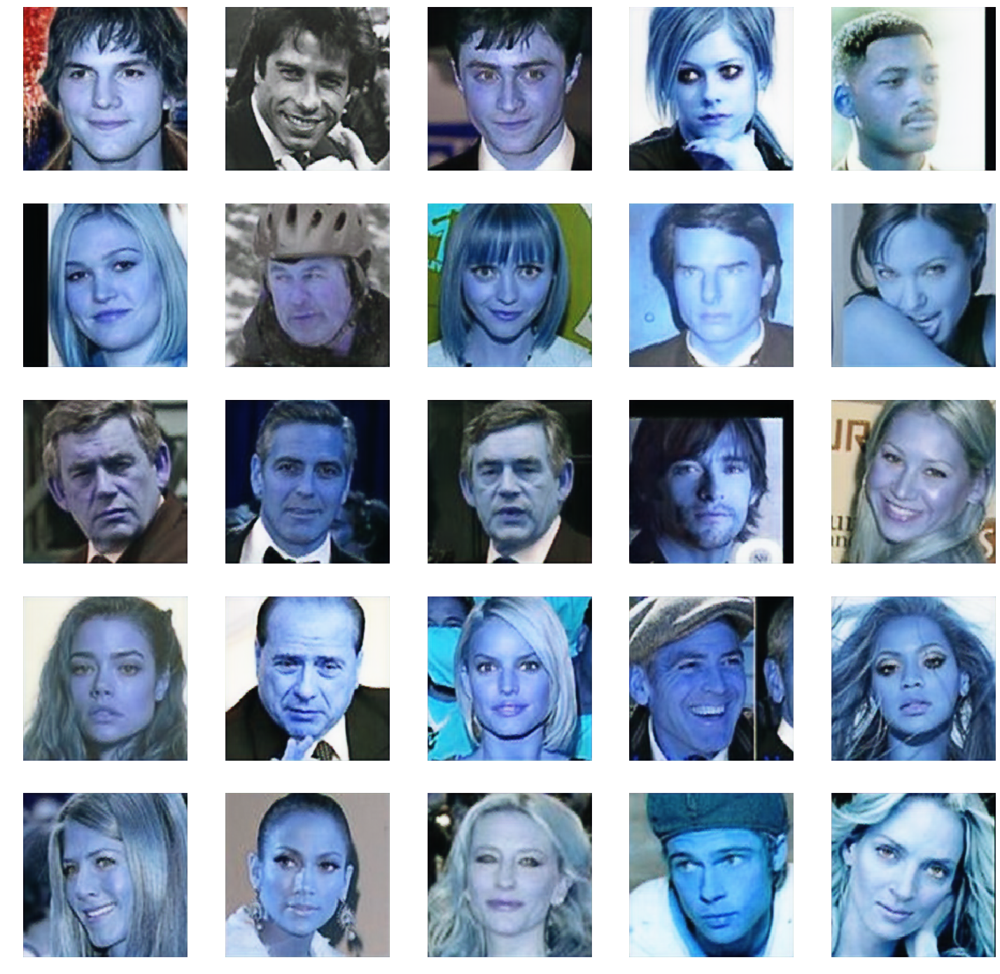

 16%|█▌        | 802/5000 [10:13<2:11:02,  1.87s/it]

[0.0058940602, 0.0]


 16%|█▌        | 803/5000 [10:14<1:46:59,  1.53s/it]

[0.002552509, 0.0]


 16%|█▌        | 804/5000 [10:15<1:29:56,  1.29s/it]

[0.0031519013, 0.0]


 16%|█▌        | 805/5000 [10:16<1:18:01,  1.12s/it]

[0.0026502905, 0.0]


 16%|█▌        | 806/5000 [10:16<1:09:27,  1.01it/s]

[0.0036130515, 0.0]


 16%|█▌        | 807/5000 [10:17<1:03:44,  1.10it/s]

[0.0029366016, 0.0]


 16%|█▌        | 808/5000 [10:18<59:24,  1.18it/s]  

[0.002621758, 0.0]


 16%|█▌        | 809/5000 [10:18<56:40,  1.23it/s]

[0.006401585, 0.0]


 16%|█▌        | 810/5000 [10:19<54:21,  1.28it/s]

[0.008003994, 0.0]


 16%|█▌        | 811/5000 [10:20<53:09,  1.31it/s]

[0.01102271, 0.0]


 16%|█▌        | 812/5000 [10:21<51:57,  1.34it/s]

[0.0032009017, 0.0]


 16%|█▋        | 813/5000 [10:21<51:31,  1.35it/s]

[0.006327973, 0.0]


 16%|█▋        | 814/5000 [10:22<50:53,  1.37it/s]

[0.0055362605, 0.0]


 16%|█▋        | 815/5000 [10:23<50:45,  1.37it/s]

[0.0023497103, 0.0]


 16%|█▋        | 816/5000 [10:23<50:15,  1.39it/s]

[0.0029723516, 0.0]


 16%|█▋        | 817/5000 [10:24<50:09,  1.39it/s]

[0.0025217847, 0.0]


 16%|█▋        | 818/5000 [10:25<49:51,  1.40it/s]

[0.004461286, 0.0]


 16%|█▋        | 819/5000 [10:26<49:54,  1.40it/s]

[0.0060186004, 0.0]


 16%|█▋        | 820/5000 [10:26<49:45,  1.40it/s]

[0.0034627356, 0.0]


 16%|█▋        | 821/5000 [10:27<49:57,  1.39it/s]

[0.002794257, 0.0]


 16%|█▋        | 822/5000 [10:28<49:43,  1.40it/s]

[0.0025016598, 0.0]


 16%|█▋        | 823/5000 [10:28<50:01,  1.39it/s]

[0.003329886, 0.0]


 16%|█▋        | 824/5000 [10:29<49:52,  1.40it/s]

[0.002995345, 0.0]


 16%|█▋        | 825/5000 [10:30<50:01,  1.39it/s]

[0.003431056, 0.0]


 17%|█▋        | 826/5000 [10:31<49:50,  1.40it/s]

[0.007874704, 0.0]


 17%|█▋        | 827/5000 [10:31<49:59,  1.39it/s]

[0.002681256, 0.0]


 17%|█▋        | 828/5000 [10:32<49:46,  1.40it/s]

[0.0025853277, 0.0]


 17%|█▋        | 829/5000 [10:33<49:56,  1.39it/s]

[0.0024801272, 0.0]


 17%|█▋        | 830/5000 [10:33<49:42,  1.40it/s]

[0.008222881, 0.0]


 17%|█▋        | 831/5000 [10:34<49:39,  1.40it/s]

[0.0021481575, 0.0]


 17%|█▋        | 832/5000 [10:35<49:30,  1.40it/s]

[0.002859104, 0.0]


 17%|█▋        | 833/5000 [10:36<49:37,  1.40it/s]

[0.0029582619, 0.0]


 17%|█▋        | 834/5000 [10:36<49:28,  1.40it/s]

[0.0023172032, 0.0]


 17%|█▋        | 835/5000 [10:37<49:35,  1.40it/s]

[0.0030959079, 0.0]


 17%|█▋        | 836/5000 [10:38<49:25,  1.40it/s]

[0.004626733, 0.0]


 17%|█▋        | 837/5000 [10:38<49:31,  1.40it/s]

[0.0046334644, 0.0]


 17%|█▋        | 838/5000 [10:39<49:18,  1.41it/s]

[0.0028964726, 0.0]


 17%|█▋        | 839/5000 [10:40<49:23,  1.40it/s]

[0.0027495064, 0.0]


 17%|█▋        | 840/5000 [10:41<49:20,  1.41it/s]

[0.0023862945, 0.0]


 17%|█▋        | 841/5000 [10:41<49:33,  1.40it/s]

[0.0035127683, 0.0]


 17%|█▋        | 842/5000 [10:42<49:25,  1.40it/s]

[0.0027313274, 0.0]


 17%|█▋        | 843/5000 [10:43<49:34,  1.40it/s]

[0.0049510016, 0.0]


 17%|█▋        | 844/5000 [10:43<49:22,  1.40it/s]

[0.0022646878, 0.0]


 17%|█▋        | 845/5000 [10:44<49:26,  1.40it/s]

[0.0022235876, 0.0]


 17%|█▋        | 846/5000 [10:45<49:16,  1.41it/s]

[0.0022344755, 0.0]


 17%|█▋        | 847/5000 [10:46<49:29,  1.40it/s]

[0.0020654993, 0.0]


 17%|█▋        | 848/5000 [10:46<49:23,  1.40it/s]

[0.0020486198, 0.0]


 17%|█▋        | 849/5000 [10:47<49:33,  1.40it/s]

[0.004369621, 0.0]


 17%|█▋        | 850/5000 [10:48<49:20,  1.40it/s]

[0.003862393, 0.0]


 17%|█▋        | 851/5000 [10:48<49:31,  1.40it/s]

[0.0023486149, 0.0]
850 [G loss: 0.002349, G acc.: 0.00%]


 17%|█▋        | 852/5000 [10:49<49:09,  1.41it/s]

[0.0024369485, 0.0]


 17%|█▋        | 853/5000 [10:50<49:16,  1.40it/s]

[0.0024132046, 0.0]


 17%|█▋        | 854/5000 [10:51<49:08,  1.41it/s]

[0.002246851, 0.0]


 17%|█▋        | 855/5000 [10:51<49:22,  1.40it/s]

[0.0021220641, 0.0]


 17%|█▋        | 856/5000 [10:52<49:14,  1.40it/s]

[0.002162592, 0.0]


 17%|█▋        | 857/5000 [10:53<49:21,  1.40it/s]

[0.0023849313, 0.0]


 17%|█▋        | 858/5000 [10:53<49:09,  1.40it/s]

[0.0028099543, 0.0]


 17%|█▋        | 859/5000 [10:54<49:16,  1.40it/s]

[0.004093077, 0.0]


 17%|█▋        | 860/5000 [10:55<49:19,  1.40it/s]

[0.002814178, 0.0]


 17%|█▋        | 861/5000 [10:56<49:23,  1.40it/s]

[0.012535734, 0.0]


 17%|█▋        | 862/5000 [10:56<49:12,  1.40it/s]

[0.0024952216, 0.0]


 17%|█▋        | 863/5000 [10:57<49:25,  1.40it/s]

[0.011210453, 0.0]


 17%|█▋        | 864/5000 [10:58<49:12,  1.40it/s]

[0.0030908994, 0.0]


 17%|█▋        | 865/5000 [10:58<49:21,  1.40it/s]

[0.0060808673, 0.0]


 17%|█▋        | 866/5000 [10:59<49:09,  1.40it/s]

[0.0060308655, 0.0]


 17%|█▋        | 867/5000 [11:00<49:19,  1.40it/s]

[0.0027270657, 0.0]


 17%|█▋        | 868/5000 [11:01<49:08,  1.40it/s]

[0.0021653802, 0.0]


 17%|█▋        | 869/5000 [11:01<49:18,  1.40it/s]

[0.0031492717, 0.0]


 17%|█▋        | 870/5000 [11:02<49:08,  1.40it/s]

[0.0034730686, 0.0]


 17%|█▋        | 871/5000 [11:03<49:16,  1.40it/s]

[0.005061448, 0.0]


 17%|█▋        | 872/5000 [11:03<49:10,  1.40it/s]

[0.002264228, 0.0]


 17%|█▋        | 873/5000 [11:04<49:16,  1.40it/s]

[0.0026140788, 0.0]


 17%|█▋        | 874/5000 [11:05<49:04,  1.40it/s]

[0.0033309064, 0.0]


 18%|█▊        | 875/5000 [11:06<49:13,  1.40it/s]

[0.0048014997, 0.0]


 18%|█▊        | 876/5000 [11:06<49:01,  1.40it/s]

[0.00441603, 0.0]


 18%|█▊        | 877/5000 [11:07<49:12,  1.40it/s]

[0.0030288824, 0.0]


 18%|█▊        | 878/5000 [11:08<49:03,  1.40it/s]

[0.0024352532, 0.0]


 18%|█▊        | 879/5000 [11:08<49:07,  1.40it/s]

[0.005753357, 0.0]


 18%|█▊        | 880/5000 [11:09<48:58,  1.40it/s]

[0.0048804497, 0.0]


 18%|█▊        | 881/5000 [11:10<49:02,  1.40it/s]

[0.002726818, 0.0]


 18%|█▊        | 882/5000 [11:11<48:48,  1.41it/s]

[0.0034573406, 0.0]


 18%|█▊        | 883/5000 [11:11<49:06,  1.40it/s]

[0.0025946558, 0.0]


 18%|█▊        | 884/5000 [11:12<48:55,  1.40it/s]

[0.003396539, 0.0]


 18%|█▊        | 885/5000 [11:13<49:05,  1.40it/s]

[0.0025320766, 0.0]


 18%|█▊        | 886/5000 [11:13<48:58,  1.40it/s]

[0.002503214, 0.0]


 18%|█▊        | 887/5000 [11:14<49:05,  1.40it/s]

[0.0025409327, 0.0]


 18%|█▊        | 888/5000 [11:15<48:45,  1.41it/s]

[0.005871946, 0.0]


 18%|█▊        | 889/5000 [11:16<48:58,  1.40it/s]

[0.008950652, 0.0]


 18%|█▊        | 890/5000 [11:16<48:47,  1.40it/s]

[0.0027801164, 0.0]


 18%|█▊        | 891/5000 [11:17<48:57,  1.40it/s]

[0.0023040678, 0.0]


 18%|█▊        | 892/5000 [11:18<48:50,  1.40it/s]

[0.0039632623, 0.0]


 18%|█▊        | 893/5000 [11:18<49:00,  1.40it/s]

[0.004770681, 0.0]


 18%|█▊        | 894/5000 [11:19<48:52,  1.40it/s]

[0.002719937, 0.0]


 18%|█▊        | 895/5000 [11:20<48:55,  1.40it/s]

[0.0027982234, 0.0]


 18%|█▊        | 896/5000 [11:21<48:46,  1.40it/s]

[0.004121477, 0.0]


 18%|█▊        | 897/5000 [11:21<49:00,  1.40it/s]

[0.0034843613, 0.0]


 18%|█▊        | 898/5000 [11:22<48:51,  1.40it/s]

[0.012562208, 0.0]


 18%|█▊        | 899/5000 [11:23<48:54,  1.40it/s]

[0.0049147545, 0.0]


 18%|█▊        | 900/5000 [11:23<48:48,  1.40it/s]

[0.0026669088, 0.0]


 18%|█▊        | 901/5000 [11:24<48:57,  1.40it/s]

[0.0026652932, 0.0]
900 [G loss: 0.002665, G acc.: 0.00%]


 18%|█▊        | 902/5000 [11:25<48:41,  1.40it/s]

[0.0021261703, 0.0]


 18%|█▊        | 903/5000 [11:26<48:53,  1.40it/s]

[0.0035278162, 0.0]


 18%|█▊        | 904/5000 [11:26<48:46,  1.40it/s]

[0.0034126122, 0.0]


 18%|█▊        | 905/5000 [11:27<48:58,  1.39it/s]

[0.0036075844, 0.0]


 18%|█▊        | 906/5000 [11:28<48:47,  1.40it/s]

[0.0029975853, 0.0]


 18%|█▊        | 907/5000 [11:28<48:54,  1.39it/s]

[0.0030106024, 0.0]


 18%|█▊        | 908/5000 [11:29<48:40,  1.40it/s]

[0.0029649497, 0.0]


 18%|█▊        | 909/5000 [11:30<48:43,  1.40it/s]

[0.0026219566, 0.0]


 18%|█▊        | 910/5000 [11:31<48:35,  1.40it/s]

[0.0046865973, 0.0]


 18%|█▊        | 911/5000 [11:31<48:45,  1.40it/s]

[0.00522943, 0.0]


 18%|█▊        | 912/5000 [11:32<48:38,  1.40it/s]

[0.0022106967, 0.0]


 18%|█▊        | 913/5000 [11:33<48:51,  1.39it/s]

[0.0021659366, 0.0]


 18%|█▊        | 914/5000 [11:33<48:36,  1.40it/s]

[0.002562006, 0.0]


 18%|█▊        | 915/5000 [11:34<48:47,  1.40it/s]

[0.0027187285, 0.0]


 18%|█▊        | 916/5000 [11:35<48:36,  1.40it/s]

[0.0023352474, 0.0]


 18%|█▊        | 917/5000 [11:36<48:47,  1.39it/s]

[0.002274413, 0.0]


 18%|█▊        | 918/5000 [11:36<48:34,  1.40it/s]

[0.003081858, 0.0]


 18%|█▊        | 919/5000 [11:37<48:44,  1.40it/s]

[0.004508715, 0.0]


 18%|█▊        | 920/5000 [11:38<48:32,  1.40it/s]

[0.003212776, 0.0]


 18%|█▊        | 921/5000 [11:38<48:41,  1.40it/s]

[0.0052655623, 0.0]


 18%|█▊        | 922/5000 [11:39<48:24,  1.40it/s]

[0.0024314083, 0.0]


 18%|█▊        | 923/5000 [11:40<48:30,  1.40it/s]

[0.006585159, 0.0]


 18%|█▊        | 924/5000 [11:41<48:19,  1.41it/s]

[0.0031881917, 0.0]


 18%|█▊        | 925/5000 [11:41<48:38,  1.40it/s]

[0.0027462593, 0.0]


 19%|█▊        | 926/5000 [11:42<48:28,  1.40it/s]

[0.002918036, 0.0]


 19%|█▊        | 927/5000 [11:43<48:35,  1.40it/s]

[0.0033908894, 0.0]


 19%|█▊        | 928/5000 [11:43<48:30,  1.40it/s]

[0.0021793174, 0.0]


 19%|█▊        | 929/5000 [11:44<48:38,  1.40it/s]

[0.011677066, 0.0]


 19%|█▊        | 930/5000 [11:45<48:27,  1.40it/s]

[0.008796969, 0.0]


 19%|█▊        | 931/5000 [11:46<48:37,  1.39it/s]

[0.0022304608, 0.0]


 19%|█▊        | 932/5000 [11:46<48:27,  1.40it/s]

[0.0044570244, 0.0]


 19%|█▊        | 933/5000 [11:47<48:37,  1.39it/s]

[0.0028696514, 0.0]


 19%|█▊        | 934/5000 [11:48<48:29,  1.40it/s]

[0.0024137807, 0.0]


 19%|█▊        | 935/5000 [11:48<48:40,  1.39it/s]

[0.0030482272, 0.0]


 19%|█▊        | 936/5000 [11:49<48:24,  1.40it/s]

[0.0025685625, 0.0]


 19%|█▊        | 937/5000 [11:50<48:31,  1.40it/s]

[0.0026980035, 0.0]


 19%|█▉        | 938/5000 [11:51<48:23,  1.40it/s]

[0.003077629, 0.0]


 19%|█▉        | 939/5000 [11:51<48:34,  1.39it/s]

[0.0032279424, 0.0]


 19%|█▉        | 940/5000 [11:52<48:22,  1.40it/s]

[0.0036829081, 0.0]


 19%|█▉        | 941/5000 [11:53<48:25,  1.40it/s]

[0.003580153, 0.0]


 19%|█▉        | 942/5000 [11:53<48:17,  1.40it/s]

[0.006961114, 0.0]


 19%|█▉        | 943/5000 [11:54<48:26,  1.40it/s]

[0.0031609517, 0.0]


 19%|█▉        | 944/5000 [11:55<48:08,  1.40it/s]

[0.0070220227, 0.0]


 19%|█▉        | 945/5000 [11:56<48:22,  1.40it/s]

[0.0031576254, 0.0]


 19%|█▉        | 946/5000 [11:56<48:14,  1.40it/s]

[0.0032701525, 0.0]


 19%|█▉        | 947/5000 [11:57<48:22,  1.40it/s]

[0.002822753, 0.0]


 19%|█▉        | 948/5000 [11:58<48:09,  1.40it/s]

[0.0046311324, 0.0]


 19%|█▉        | 949/5000 [11:58<48:18,  1.40it/s]

[0.0042221206, 0.0]


 19%|█▉        | 950/5000 [11:59<48:09,  1.40it/s]

[0.0037721524, 0.0]


 19%|█▉        | 951/5000 [12:00<48:23,  1.39it/s]

[0.009215125, 0.0]
950 [G loss: 0.009215, G acc.: 0.00%]


 19%|█▉        | 952/5000 [12:01<48:17,  1.40it/s]

[0.002492977, 0.0]


 19%|█▉        | 953/5000 [12:01<48:23,  1.39it/s]

[0.0040131565, 0.0]


 19%|█▉        | 954/5000 [12:02<48:10,  1.40it/s]

[0.0029452355, 0.0]


 19%|█▉        | 955/5000 [12:03<48:16,  1.40it/s]

[0.0039459653, 0.0]


 19%|█▉        | 956/5000 [12:03<48:00,  1.40it/s]

[0.0044931397, 0.0]


 19%|█▉        | 957/5000 [12:04<48:10,  1.40it/s]

[0.005035728, 0.0]


 19%|█▉        | 958/5000 [12:05<47:55,  1.41it/s]

[0.003306805, 0.0]


 19%|█▉        | 959/5000 [12:06<48:04,  1.40it/s]

[0.0032607731, 0.0]


 19%|█▉        | 960/5000 [12:06<47:54,  1.41it/s]

[0.0025246067, 0.0]


 19%|█▉        | 961/5000 [12:07<48:02,  1.40it/s]

[0.0029056754, 0.0]


 19%|█▉        | 962/5000 [12:08<47:52,  1.41it/s]

[0.0021310167, 0.0]


 19%|█▉        | 963/5000 [12:08<48:02,  1.40it/s]

[0.007830676, 0.0]


 19%|█▉        | 964/5000 [12:09<47:54,  1.40it/s]

[0.0028326404, 0.0]


 19%|█▉        | 965/5000 [12:10<48:01,  1.40it/s]

[0.0021627517, 0.0]


 19%|█▉        | 966/5000 [12:11<47:53,  1.40it/s]

[0.0022699188, 0.0]


 19%|█▉        | 967/5000 [12:11<48:03,  1.40it/s]

[0.0027060572, 0.0]


 19%|█▉        | 968/5000 [12:12<47:52,  1.40it/s]

[0.0025585066, 0.0]


 19%|█▉        | 969/5000 [12:13<48:00,  1.40it/s]

[0.002622679, 0.0]


 19%|█▉        | 970/5000 [12:13<47:55,  1.40it/s]

[0.0030007837, 0.0]


 19%|█▉        | 971/5000 [12:14<48:10,  1.39it/s]

[0.0023754372, 0.0]


 19%|█▉        | 972/5000 [12:15<47:53,  1.40it/s]

[0.002346621, 0.0]


 19%|█▉        | 973/5000 [12:16<47:58,  1.40it/s]

[0.00542352, 0.0]


 19%|█▉        | 974/5000 [12:16<47:50,  1.40it/s]

[0.0021885536, 0.0]


 20%|█▉        | 975/5000 [12:17<48:08,  1.39it/s]

[0.004306935, 0.0]


 20%|█▉        | 976/5000 [12:18<47:52,  1.40it/s]

[0.0022996056, 0.0]


 20%|█▉        | 977/5000 [12:18<48:03,  1.40it/s]

[0.0054340814, 0.0]


 20%|█▉        | 978/5000 [12:19<47:50,  1.40it/s]

[0.0026593942, 0.0]


 20%|█▉        | 979/5000 [12:20<47:59,  1.40it/s]

[0.0022699567, 0.0]


 20%|█▉        | 980/5000 [12:21<47:47,  1.40it/s]

[0.0035169371, 0.0]


 20%|█▉        | 981/5000 [12:21<47:56,  1.40it/s]

[0.0064229593, 0.0]


 20%|█▉        | 982/5000 [12:22<47:45,  1.40it/s]

[0.002915411, 0.0]


 20%|█▉        | 983/5000 [12:23<47:53,  1.40it/s]

[0.0021968305, 0.0]


 20%|█▉        | 984/5000 [12:23<47:46,  1.40it/s]

[0.002904935, 0.0]


 20%|█▉        | 985/5000 [12:24<47:54,  1.40it/s]

[0.0022523678, 0.0]


 20%|█▉        | 986/5000 [12:25<47:39,  1.40it/s]

[0.0022371514, 0.0]


 20%|█▉        | 987/5000 [12:26<47:48,  1.40it/s]

[0.0031601605, 0.0]


 20%|█▉        | 988/5000 [12:26<47:39,  1.40it/s]

[0.0021876532, 0.0]


 20%|█▉        | 989/5000 [12:27<47:50,  1.40it/s]

[0.004995838, 0.0]


 20%|█▉        | 990/5000 [12:28<47:41,  1.40it/s]

[0.0027964266, 0.0]


 20%|█▉        | 991/5000 [12:28<47:44,  1.40it/s]

[0.0024604835, 0.0]


 20%|█▉        | 992/5000 [12:29<47:34,  1.40it/s]

[0.002963281, 0.0]


 20%|█▉        | 993/5000 [12:30<47:39,  1.40it/s]

[0.004314773, 0.0]


 20%|█▉        | 994/5000 [12:31<47:29,  1.41it/s]

[0.005358299, 0.0]


 20%|█▉        | 995/5000 [12:31<47:37,  1.40it/s]

[0.006975101, 0.0]


 20%|█▉        | 996/5000 [12:32<47:24,  1.41it/s]

[0.009817736, 0.0]


 20%|█▉        | 997/5000 [12:33<47:36,  1.40it/s]

[0.0064900564, 0.0]


 20%|█▉        | 998/5000 [12:33<47:25,  1.41it/s]

[0.003551418, 0.0]


 20%|█▉        | 999/5000 [12:34<47:36,  1.40it/s]

[0.003217398, 0.0]


 20%|██        | 1000/5000 [12:35<47:24,  1.41it/s]

[0.0019286624, 0.0]
[0.0022902598, 0.0]
1000 [G loss: 0.002290, G acc.: 0.00%]


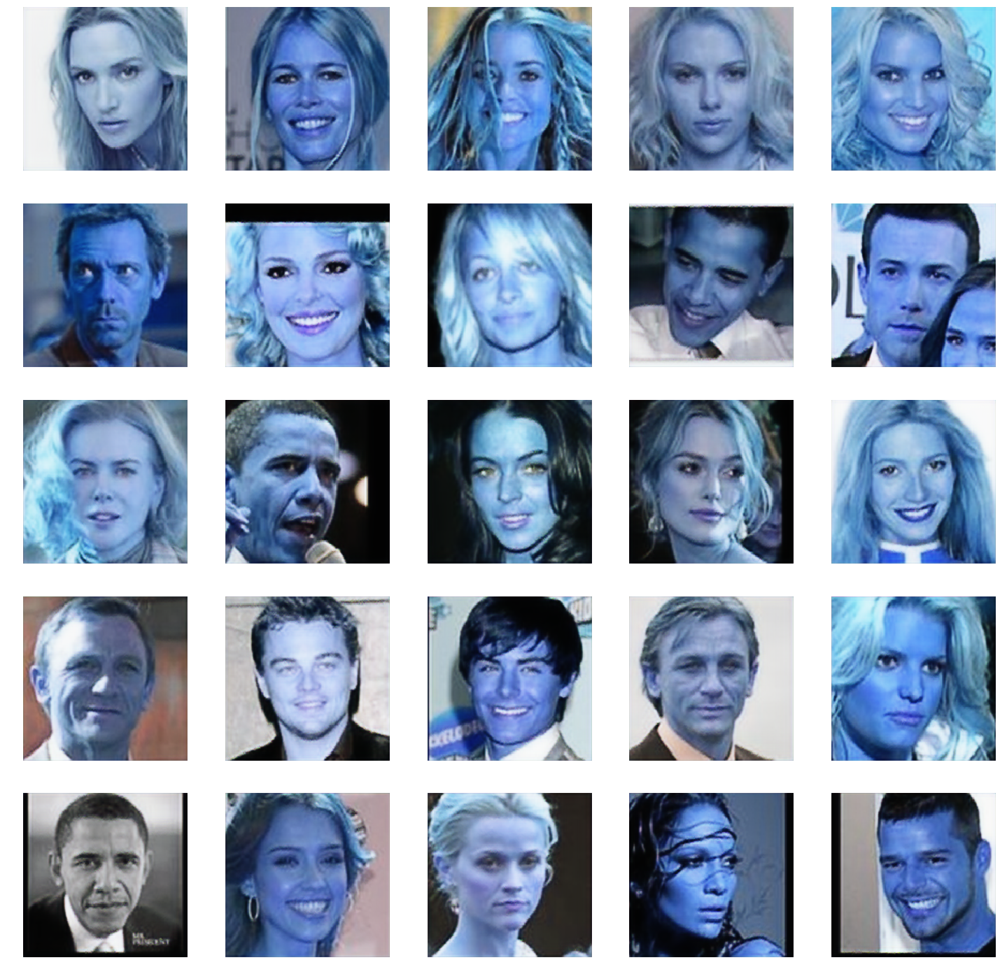

 20%|██        | 1002/5000 [12:42<2:02:06,  1.83s/it]

[0.0019330452, 0.0]


 20%|██        | 1003/5000 [12:42<1:40:12,  1.50s/it]

[0.0028869438, 0.0]


 20%|██        | 1004/5000 [12:43<1:24:25,  1.27s/it]

[0.0024295524, 0.0]


 20%|██        | 1005/5000 [12:44<1:13:29,  1.10s/it]

[0.0025473735, 0.0]


 20%|██        | 1006/5000 [12:44<1:05:37,  1.01it/s]

[0.0022625383, 0.0]


 20%|██        | 1007/5000 [12:45<1:00:20,  1.10it/s]

[0.0054777446, 0.0]


 20%|██        | 1008/5000 [12:46<56:24,  1.18it/s]  

[0.0025023439, 0.0]


 20%|██        | 1009/5000 [12:47<53:51,  1.24it/s]

[0.0028297852, 0.0]


 20%|██        | 1010/5000 [12:47<51:47,  1.28it/s]

[0.0024138757, 0.0]


 20%|██        | 1011/5000 [12:48<50:41,  1.31it/s]

[0.003843715, 0.0]


 20%|██        | 1012/5000 [12:49<49:35,  1.34it/s]

[0.005977051, 0.0]


 20%|██        | 1013/5000 [12:49<49:01,  1.36it/s]

[0.002300848, 0.0]


 20%|██        | 1014/5000 [12:50<48:24,  1.37it/s]

[0.0049368315, 0.0]


 20%|██        | 1015/5000 [12:51<48:15,  1.38it/s]

[0.0028500052, 0.0]


 20%|██        | 1016/5000 [12:52<47:53,  1.39it/s]

[0.00463687, 0.0]


 20%|██        | 1017/5000 [12:52<47:57,  1.38it/s]

[0.0027996507, 0.0]


 20%|██        | 1018/5000 [12:53<47:42,  1.39it/s]

[0.003607098, 0.0]


 20%|██        | 1019/5000 [12:54<47:41,  1.39it/s]

[0.0034892582, 0.0]


 20%|██        | 1020/5000 [12:54<47:23,  1.40it/s]

[0.0021189926, 0.0]


 20%|██        | 1021/5000 [12:55<47:24,  1.40it/s]

[0.0049254494, 0.0]


 20%|██        | 1022/5000 [12:56<47:15,  1.40it/s]

[0.0022243343, 0.0]


 20%|██        | 1023/5000 [12:57<47:21,  1.40it/s]

[0.0034472633, 0.0]


 20%|██        | 1024/5000 [12:57<47:12,  1.40it/s]

[0.0019875313, 0.0]


 20%|██        | 1025/5000 [12:58<47:20,  1.40it/s]

[0.006092851, 0.0]


 21%|██        | 1026/5000 [12:59<47:15,  1.40it/s]

[0.003238009, 0.0]


 21%|██        | 1027/5000 [12:59<47:19,  1.40it/s]

[0.0023135864, 0.0]


 21%|██        | 1028/5000 [13:00<47:09,  1.40it/s]

[0.0018223574, 0.0]


 21%|██        | 1029/5000 [13:01<47:15,  1.40it/s]

[0.0023564622, 0.0]


 21%|██        | 1030/5000 [13:02<47:01,  1.41it/s]

[0.002179438, 0.0]


 21%|██        | 1031/5000 [13:02<47:08,  1.40it/s]

[0.0019541837, 0.0]


 21%|██        | 1032/5000 [13:03<47:03,  1.41it/s]

[0.004156711, 0.0]


 21%|██        | 1033/5000 [13:04<47:12,  1.40it/s]

[0.0045319363, 0.0]


 21%|██        | 1034/5000 [13:04<46:56,  1.41it/s]

[0.0035264043, 0.0]


 21%|██        | 1035/5000 [13:05<47:07,  1.40it/s]

[0.0021849894, 0.0]


 21%|██        | 1036/5000 [13:06<47:00,  1.41it/s]

[0.0027664932, 0.0]


 21%|██        | 1037/5000 [13:07<47:09,  1.40it/s]

[0.0025864767, 0.0]


 21%|██        | 1038/5000 [13:07<47:05,  1.40it/s]

[0.004512948, 0.0]


 21%|██        | 1039/5000 [13:08<47:15,  1.40it/s]

[0.0027960602, 0.0]


 21%|██        | 1040/5000 [13:09<47:08,  1.40it/s]

[0.0025331734, 0.0]


 21%|██        | 1041/5000 [13:09<47:04,  1.40it/s]

[0.0031301293, 0.0]


 21%|██        | 1042/5000 [13:10<46:55,  1.41it/s]

[0.0025337725, 0.0]


 21%|██        | 1043/5000 [13:11<47:09,  1.40it/s]

[0.0022106487, 0.0]


 21%|██        | 1044/5000 [13:12<47:05,  1.40it/s]

[0.0057122647, 0.0]


 21%|██        | 1045/5000 [13:12<47:14,  1.40it/s]

[0.002148922, 0.0]


 21%|██        | 1046/5000 [13:13<47:08,  1.40it/s]

[0.004196911, 0.0]


 21%|██        | 1047/5000 [13:14<47:15,  1.39it/s]

[0.0038852794, 0.0]


 21%|██        | 1048/5000 [13:14<47:00,  1.40it/s]

[0.0020739252, 0.0]


 21%|██        | 1049/5000 [13:15<47:12,  1.40it/s]

[0.0038573153, 0.0]


 21%|██        | 1050/5000 [13:16<46:59,  1.40it/s]

[0.0074851904, 0.0]


 21%|██        | 1051/5000 [13:17<47:05,  1.40it/s]

[0.005781631, 0.0]
1050 [G loss: 0.005782, G acc.: 0.00%]


 21%|██        | 1052/5000 [13:17<46:51,  1.40it/s]

[0.0032435672, 0.0]


 21%|██        | 1053/5000 [13:18<47:00,  1.40it/s]

[0.0042015184, 0.0]


 21%|██        | 1054/5000 [13:19<46:52,  1.40it/s]

[0.004900814, 0.0]


 21%|██        | 1055/5000 [13:19<46:57,  1.40it/s]

[0.0023144542, 0.0]


 21%|██        | 1056/5000 [13:20<46:46,  1.41it/s]

[0.002360594, 0.0]


 21%|██        | 1057/5000 [13:21<46:55,  1.40it/s]

[0.002679955, 0.0]


 21%|██        | 1058/5000 [13:22<46:44,  1.41it/s]

[0.0026838384, 0.0]


 21%|██        | 1059/5000 [13:22<46:56,  1.40it/s]

[0.005050058, 0.0]


 21%|██        | 1060/5000 [13:23<46:49,  1.40it/s]

[0.010446001, 0.0]


 21%|██        | 1061/5000 [13:24<47:01,  1.40it/s]

[0.0038297055, 0.0]


 21%|██        | 1062/5000 [13:24<46:47,  1.40it/s]

[0.0035884134, 0.0]


 21%|██▏       | 1063/5000 [13:25<46:51,  1.40it/s]

[0.002251224, 0.0]


 21%|██▏       | 1064/5000 [13:26<46:40,  1.41it/s]

[0.0027957978, 0.0]


 21%|██▏       | 1065/5000 [13:27<46:54,  1.40it/s]

[0.0023088949, 0.0]


 21%|██▏       | 1066/5000 [13:27<46:43,  1.40it/s]

[0.0037258025, 0.0]


 21%|██▏       | 1067/5000 [13:28<46:55,  1.40it/s]

[0.0037255012, 0.0]


 21%|██▏       | 1068/5000 [13:29<46:46,  1.40it/s]

[0.0028528532, 0.0]


 21%|██▏       | 1069/5000 [13:29<46:51,  1.40it/s]

[0.0023096376, 0.0]


 21%|██▏       | 1070/5000 [13:30<46:37,  1.40it/s]

[0.009721792, 0.0]


 21%|██▏       | 1071/5000 [13:31<46:59,  1.39it/s]

[0.0033989062, 0.0]


 21%|██▏       | 1072/5000 [13:32<46:46,  1.40it/s]

[0.0066186525, 0.0]


 21%|██▏       | 1073/5000 [13:32<46:54,  1.40it/s]

[0.002088209, 0.0]


 21%|██▏       | 1074/5000 [13:33<46:41,  1.40it/s]

[0.0023209974, 0.0]


 22%|██▏       | 1075/5000 [13:34<46:49,  1.40it/s]

[0.0021807395, 0.0]


 22%|██▏       | 1076/5000 [13:34<46:48,  1.40it/s]

[0.003651039, 0.0]


 22%|██▏       | 1077/5000 [13:35<46:52,  1.39it/s]

[0.0044568195, 0.0]


 22%|██▏       | 1078/5000 [13:36<46:41,  1.40it/s]

[0.002068775, 0.0]


 22%|██▏       | 1079/5000 [13:37<46:53,  1.39it/s]

[0.0029891243, 0.0]


 22%|██▏       | 1080/5000 [13:37<46:44,  1.40it/s]

[0.0018732022, 0.0]


 22%|██▏       | 1081/5000 [13:38<46:50,  1.39it/s]

[0.0025864793, 0.0]


 22%|██▏       | 1082/5000 [13:39<46:36,  1.40it/s]

[0.0038081813, 0.0]


 22%|██▏       | 1083/5000 [13:39<46:41,  1.40it/s]

[0.0043240977, 0.0]


 22%|██▏       | 1084/5000 [13:40<46:30,  1.40it/s]

[0.0034837662, 0.0]


 22%|██▏       | 1085/5000 [13:41<46:44,  1.40it/s]

[0.0030296978, 0.0]


 22%|██▏       | 1086/5000 [13:42<46:36,  1.40it/s]

[0.003052628, 0.0]


 22%|██▏       | 1087/5000 [13:42<46:47,  1.39it/s]

[0.0022093253, 0.0]


 22%|██▏       | 1088/5000 [13:43<46:36,  1.40it/s]

[0.0020965452, 0.0]


 22%|██▏       | 1089/5000 [13:44<46:40,  1.40it/s]

[0.005981444, 0.0]


 22%|██▏       | 1090/5000 [13:44<46:31,  1.40it/s]

[0.0025342847, 0.0]


 22%|██▏       | 1091/5000 [13:45<46:39,  1.40it/s]

[0.0026857883, 0.0]


 22%|██▏       | 1092/5000 [13:46<46:28,  1.40it/s]

[0.0036479516, 0.0]


 22%|██▏       | 1093/5000 [13:47<46:38,  1.40it/s]

[0.0044600354, 0.0]


 22%|██▏       | 1094/5000 [13:47<46:26,  1.40it/s]

[0.002621461, 0.0]


 22%|██▏       | 1095/5000 [13:48<46:35,  1.40it/s]

[0.0023927814, 0.0]


 22%|██▏       | 1096/5000 [13:49<46:17,  1.41it/s]

[0.0027633726, 0.0]


 22%|██▏       | 1097/5000 [13:49<46:28,  1.40it/s]

[0.0022992217, 0.0]


 22%|██▏       | 1098/5000 [13:50<46:22,  1.40it/s]

[0.001831754, 0.0]


 22%|██▏       | 1099/5000 [13:51<46:30,  1.40it/s]

[0.0024609931, 0.0]


 22%|██▏       | 1100/5000 [13:52<46:23,  1.40it/s]

[0.0031114183, 0.0]


 22%|██▏       | 1101/5000 [13:52<46:28,  1.40it/s]

[0.0032059886, 0.0]
1100 [G loss: 0.003206, G acc.: 0.00%]


 22%|██▏       | 1102/5000 [13:53<46:25,  1.40it/s]

[0.0028598534, 0.0]


 22%|██▏       | 1103/5000 [13:54<46:29,  1.40it/s]

[0.0048941635, 0.0]


 22%|██▏       | 1104/5000 [13:54<46:16,  1.40it/s]

[0.0031360534, 0.0]


 22%|██▏       | 1105/5000 [13:55<46:23,  1.40it/s]

[0.002382367, 0.0]


 22%|██▏       | 1106/5000 [13:56<46:12,  1.40it/s]

[0.01016439, 0.0]


 22%|██▏       | 1107/5000 [13:57<46:24,  1.40it/s]

[0.002635895, 0.0]


 22%|██▏       | 1108/5000 [13:57<46:17,  1.40it/s]

[0.003576687, 0.0]


 22%|██▏       | 1109/5000 [13:58<46:23,  1.40it/s]

[0.004963149, 0.0]


 22%|██▏       | 1110/5000 [13:59<46:15,  1.40it/s]

[0.0033265061, 0.0]


 22%|██▏       | 1111/5000 [13:59<46:20,  1.40it/s]

[0.0026871853, 0.0]


 22%|██▏       | 1112/5000 [14:00<46:11,  1.40it/s]

[0.0018610993, 0.0]


 22%|██▏       | 1113/5000 [14:01<46:18,  1.40it/s]

[0.0020663189, 0.0]


 22%|██▏       | 1114/5000 [14:02<46:08,  1.40it/s]

[0.002231614, 0.0]


 22%|██▏       | 1115/5000 [14:02<46:16,  1.40it/s]

[0.0027653156, 0.0]


 22%|██▏       | 1116/5000 [14:03<46:07,  1.40it/s]

[0.004632839, 0.0]


 22%|██▏       | 1117/5000 [14:04<46:15,  1.40it/s]

[0.0048188088, 0.0]


 22%|██▏       | 1118/5000 [14:04<46:07,  1.40it/s]

[0.0030329437, 0.0]


 22%|██▏       | 1119/5000 [14:05<46:12,  1.40it/s]

[0.002746826, 0.0]


 22%|██▏       | 1120/5000 [14:06<46:01,  1.40it/s]

[0.0034995466, 0.0]


 22%|██▏       | 1121/5000 [14:07<46:11,  1.40it/s]

[0.0023127142, 0.0]


 22%|██▏       | 1122/5000 [14:07<46:02,  1.40it/s]

[0.0053074006, 0.0]


 22%|██▏       | 1123/5000 [14:08<46:10,  1.40it/s]

[0.005379588, 0.0]


 22%|██▏       | 1124/5000 [14:09<46:00,  1.40it/s]

[0.0025462178, 0.0]


 22%|██▎       | 1125/5000 [14:09<46:07,  1.40it/s]

[0.0036611257, 0.0]


 23%|██▎       | 1126/5000 [14:10<45:56,  1.41it/s]

[0.0025916505, 0.0]


 23%|██▎       | 1127/5000 [14:11<46:09,  1.40it/s]

[0.0021386626, 0.0]


 23%|██▎       | 1128/5000 [14:12<46:02,  1.40it/s]

[0.00400171, 0.0]


 23%|██▎       | 1129/5000 [14:12<46:09,  1.40it/s]

[0.0023044236, 0.0]


 23%|██▎       | 1130/5000 [14:13<45:56,  1.40it/s]

[0.002975734, 0.0]


 23%|██▎       | 1131/5000 [14:14<46:14,  1.39it/s]

[0.0032281736, 0.0]


 23%|██▎       | 1132/5000 [14:14<46:01,  1.40it/s]

[0.0034281206, 0.0]


 23%|██▎       | 1133/5000 [14:15<46:07,  1.40it/s]

[0.0021436128, 0.0]


 23%|██▎       | 1134/5000 [14:16<45:56,  1.40it/s]

[0.004117865, 0.0]


 23%|██▎       | 1135/5000 [14:17<46:04,  1.40it/s]

[0.0028555382, 0.0]


 23%|██▎       | 1136/5000 [14:17<45:53,  1.40it/s]

[0.0047822497, 0.0]


 23%|██▎       | 1137/5000 [14:18<46:04,  1.40it/s]

[0.0038840643, 0.0]


 23%|██▎       | 1138/5000 [14:19<45:57,  1.40it/s]

[0.0021456582, 0.0]


 23%|██▎       | 1139/5000 [14:19<46:05,  1.40it/s]

[0.0032164373, 0.0]


 23%|██▎       | 1140/5000 [14:20<45:45,  1.41it/s]

[0.0025370957, 0.0]


 23%|██▎       | 1141/5000 [14:21<45:59,  1.40it/s]

[0.0018787901, 0.0]


 23%|██▎       | 1142/5000 [14:22<45:52,  1.40it/s]

[0.002346225, 0.0]


 23%|██▎       | 1143/5000 [14:22<46:01,  1.40it/s]

[0.010307965, 0.0]


 23%|██▎       | 1144/5000 [14:23<45:54,  1.40it/s]

[0.0040918603, 0.0]


 23%|██▎       | 1145/5000 [14:24<46:01,  1.40it/s]

[0.0020671708, 0.0]


 23%|██▎       | 1146/5000 [14:24<45:52,  1.40it/s]

[0.0027361724, 0.0]


 23%|██▎       | 1147/5000 [14:25<46:10,  1.39it/s]

[0.0024362302, 0.0]


 23%|██▎       | 1148/5000 [14:26<45:55,  1.40it/s]

[0.0024369312, 0.0]


 23%|██▎       | 1149/5000 [14:27<46:02,  1.39it/s]

[0.0039216313, 0.0]


 23%|██▎       | 1150/5000 [14:27<45:46,  1.40it/s]

[0.0027583493, 0.0]


 23%|██▎       | 1151/5000 [14:28<45:54,  1.40it/s]

[0.003092461, 0.0]
1150 [G loss: 0.003092, G acc.: 0.00%]


 23%|██▎       | 1152/5000 [14:29<45:43,  1.40it/s]

[0.002383903, 0.0]


 23%|██▎       | 1153/5000 [14:29<45:48,  1.40it/s]

[0.0030185373, 0.0]


 23%|██▎       | 1154/5000 [14:30<45:35,  1.41it/s]

[0.0020259537, 0.0]


 23%|██▎       | 1155/5000 [14:31<45:55,  1.40it/s]

[0.002633508, 0.0]


 23%|██▎       | 1156/5000 [14:32<45:47,  1.40it/s]

[0.005214072, 0.0]


 23%|██▎       | 1157/5000 [14:32<45:54,  1.40it/s]

[0.0031204035, 0.0]


 23%|██▎       | 1158/5000 [14:33<45:49,  1.40it/s]

[0.0024066367, 0.0]


 23%|██▎       | 1159/5000 [14:34<45:57,  1.39it/s]

[0.0033422576, 0.0]


 23%|██▎       | 1160/5000 [14:34<45:45,  1.40it/s]

[0.0025391767, 0.0]


 23%|██▎       | 1161/5000 [14:35<45:47,  1.40it/s]

[0.0031849346, 0.0]


 23%|██▎       | 1162/5000 [14:36<45:38,  1.40it/s]

[0.0037880866, 0.0]


 23%|██▎       | 1163/5000 [14:37<45:50,  1.39it/s]

[0.0023132341, 0.0]


 23%|██▎       | 1164/5000 [14:37<45:37,  1.40it/s]

[0.004638348, 0.0]


 23%|██▎       | 1165/5000 [14:38<45:47,  1.40it/s]

[0.0034023572, 0.0]


 23%|██▎       | 1166/5000 [14:39<45:50,  1.39it/s]

[0.0026630631, 0.0]


 23%|██▎       | 1167/5000 [14:40<45:48,  1.39it/s]

[0.0029361953, 0.0]


 23%|██▎       | 1168/5000 [14:40<45:44,  1.40it/s]

[0.0025194662, 0.0]


 23%|██▎       | 1169/5000 [14:41<45:49,  1.39it/s]

[0.0037383118, 0.0]


 23%|██▎       | 1170/5000 [14:42<45:40,  1.40it/s]

[0.0059151384, 0.0]


 23%|██▎       | 1171/5000 [14:42<45:50,  1.39it/s]

[0.0032616726, 0.0]


 23%|██▎       | 1172/5000 [14:43<45:37,  1.40it/s]

[0.0019392692, 0.0]


 23%|██▎       | 1173/5000 [14:44<45:42,  1.40it/s]

[0.0025853107, 0.0]


 23%|██▎       | 1174/5000 [14:45<45:29,  1.40it/s]

[0.002500522, 0.0]


 24%|██▎       | 1175/5000 [14:45<45:37,  1.40it/s]

[0.0024582117, 0.0]


 24%|██▎       | 1176/5000 [14:46<45:37,  1.40it/s]

[0.0018595267, 0.0]


 24%|██▎       | 1177/5000 [14:47<45:44,  1.39it/s]

[0.0023087205, 0.0]


 24%|██▎       | 1178/5000 [14:47<45:35,  1.40it/s]

[0.0025281939, 0.0]


 24%|██▎       | 1179/5000 [14:48<45:41,  1.39it/s]

[0.0038804382, 0.0]


 24%|██▎       | 1180/5000 [14:49<45:28,  1.40it/s]

[0.0033978985, 0.0]


 24%|██▎       | 1181/5000 [14:50<45:30,  1.40it/s]

[0.006509634, 0.0]


 24%|██▎       | 1182/5000 [14:50<45:21,  1.40it/s]

[0.0022297492, 0.0]


 24%|██▎       | 1183/5000 [14:51<45:29,  1.40it/s]

[0.0035317077, 0.0]


 24%|██▎       | 1184/5000 [14:52<45:22,  1.40it/s]

[0.0036703239, 0.0]


 24%|██▎       | 1185/5000 [14:52<45:30,  1.40it/s]

[0.0022362832, 0.0]


 24%|██▎       | 1186/5000 [14:53<45:24,  1.40it/s]

[0.00461756, 0.0]


 24%|██▎       | 1187/5000 [14:54<45:28,  1.40it/s]

[0.0031142903, 0.0]


 24%|██▍       | 1188/5000 [14:55<45:15,  1.40it/s]

[0.0018862581, 0.0]


 24%|██▍       | 1189/5000 [14:55<45:19,  1.40it/s]

[0.009875122, 0.0]


 24%|██▍       | 1190/5000 [14:56<45:14,  1.40it/s]

[0.002007002, 0.0]


 24%|██▍       | 1191/5000 [14:57<45:18,  1.40it/s]

[0.0021208432, 0.0]


 24%|██▍       | 1192/5000 [14:57<45:11,  1.40it/s]

[0.002495981, 0.0]


 24%|██▍       | 1193/5000 [14:58<45:15,  1.40it/s]

[0.0074036736, 0.0]


 24%|██▍       | 1194/5000 [14:59<45:08,  1.41it/s]

[0.0030816703, 0.0]


 24%|██▍       | 1195/5000 [15:00<45:12,  1.40it/s]

[0.0034030695, 0.0]


 24%|██▍       | 1196/5000 [15:00<45:06,  1.41it/s]

[0.0026270715, 0.0]


 24%|██▍       | 1197/5000 [15:01<45:14,  1.40it/s]

[0.0054546315, 0.0]


 24%|██▍       | 1198/5000 [15:02<45:09,  1.40it/s]

[0.00565268, 0.0]


 24%|██▍       | 1199/5000 [15:02<45:19,  1.40it/s]

[0.0024930695, 0.0]


 24%|██▍       | 1200/5000 [15:03<45:06,  1.40it/s]

[0.002311727, 0.0]
[0.0038701715, 0.0]
1200 [G loss: 0.003870, G acc.: 0.00%]


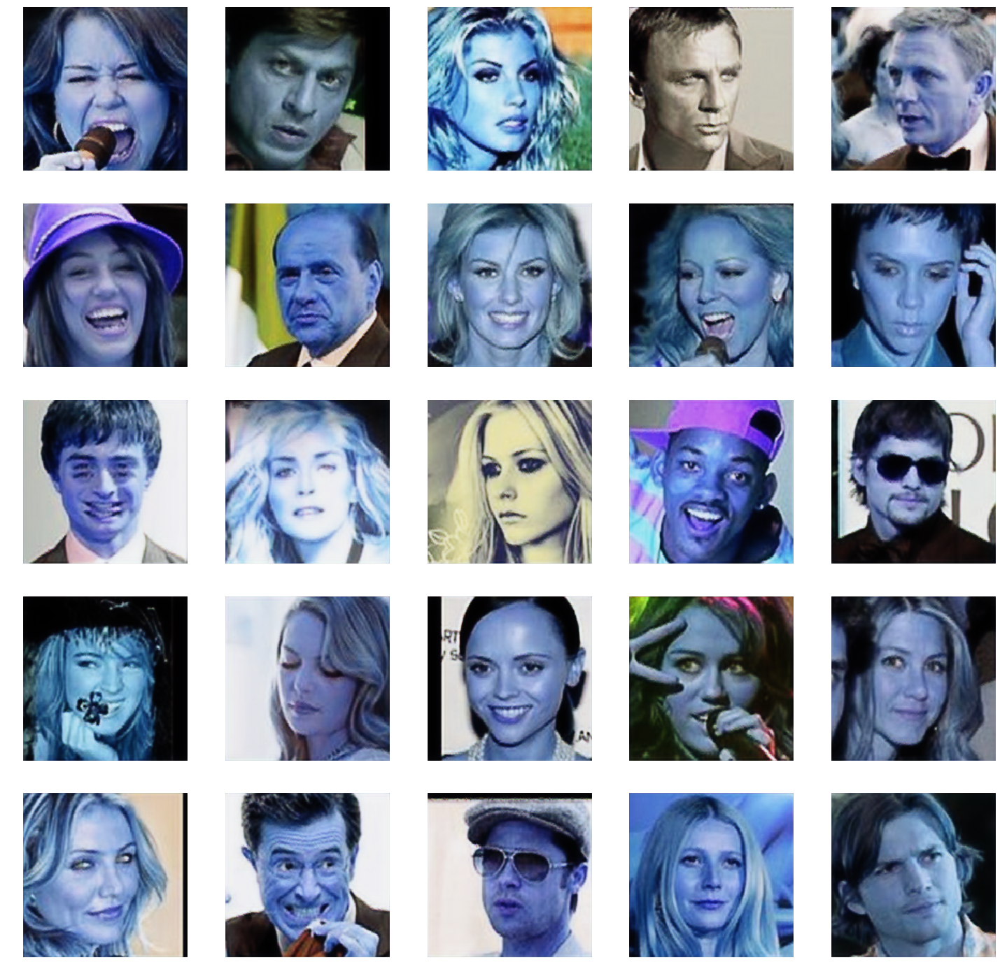

 24%|██▍       | 1202/5000 [15:09<1:51:54,  1.77s/it]

[0.0020982558, 0.0]


 24%|██▍       | 1203/5000 [15:10<1:32:11,  1.46s/it]

[0.003345157, 0.0]


 24%|██▍       | 1204/5000 [15:11<1:18:05,  1.23s/it]

[0.0031095713, 0.0]


 24%|██▍       | 1205/5000 [15:12<1:08:22,  1.08s/it]

[0.0023272566, 0.0]


 24%|██▍       | 1206/5000 [15:12<1:01:19,  1.03it/s]

[0.008485635, 0.0]


 24%|██▍       | 1207/5000 [15:13<56:30,  1.12it/s]  

[0.0054983855, 0.0]


 24%|██▍       | 1208/5000 [15:14<52:55,  1.19it/s]

[0.0026056299, 0.0]


 24%|██▍       | 1209/5000 [15:14<50:39,  1.25it/s]

[0.0023027172, 0.0]


 24%|██▍       | 1210/5000 [15:15<48:59,  1.29it/s]

[0.005577525, 0.0]


 24%|██▍       | 1211/5000 [15:16<47:56,  1.32it/s]

[0.0021751237, 0.0]


 24%|██▍       | 1212/5000 [15:17<46:54,  1.35it/s]

[0.0029757034, 0.0]


 24%|██▍       | 1213/5000 [15:17<46:25,  1.36it/s]

[0.0022054962, 0.0]


 24%|██▍       | 1214/5000 [15:18<45:55,  1.37it/s]

[0.002599248, 0.0]


 24%|██▍       | 1215/5000 [15:19<45:46,  1.38it/s]

[0.0030797191, 0.0]


 24%|██▍       | 1216/5000 [15:19<45:22,  1.39it/s]

[0.006017632, 0.0]


 24%|██▍       | 1217/5000 [15:20<45:18,  1.39it/s]

[0.0038232873, 0.0]


 24%|██▍       | 1218/5000 [15:21<45:05,  1.40it/s]

[0.006064202, 0.0]


 24%|██▍       | 1219/5000 [15:22<45:07,  1.40it/s]

[0.0028620013, 0.0]


 24%|██▍       | 1220/5000 [15:22<44:56,  1.40it/s]

[0.0018415333, 0.0]


 24%|██▍       | 1221/5000 [15:23<45:04,  1.40it/s]

[0.0018585328, 0.0]


 24%|██▍       | 1222/5000 [15:24<44:49,  1.40it/s]

[0.003282378, 0.0]


 24%|██▍       | 1223/5000 [15:24<44:58,  1.40it/s]

[0.0033515552, 0.0]


 24%|██▍       | 1224/5000 [15:25<44:50,  1.40it/s]

[0.0027822123, 0.0]


 24%|██▍       | 1225/5000 [15:26<44:59,  1.40it/s]

[0.0022581546, 0.0]


 25%|██▍       | 1226/5000 [15:27<44:45,  1.41it/s]

[0.004853119, 0.0]


 25%|██▍       | 1227/5000 [15:27<44:51,  1.40it/s]

[0.0047544776, 0.0]


 25%|██▍       | 1228/5000 [15:28<44:44,  1.41it/s]

[0.004109253, 0.0]


 25%|██▍       | 1229/5000 [15:29<44:50,  1.40it/s]

[0.0035325992, 0.0]


 25%|██▍       | 1230/5000 [15:29<44:42,  1.41it/s]

[0.0023790766, 0.0]


 25%|██▍       | 1231/5000 [15:30<44:51,  1.40it/s]

[0.002350431, 0.0]


 25%|██▍       | 1232/5000 [15:31<44:38,  1.41it/s]

[0.0018506681, 0.0]


 25%|██▍       | 1233/5000 [15:32<44:47,  1.40it/s]

[0.0032845305, 0.0]


 25%|██▍       | 1234/5000 [15:32<44:36,  1.41it/s]

[0.0020673408, 0.0]


 25%|██▍       | 1235/5000 [15:33<44:48,  1.40it/s]

[0.0051455996, 0.0]


 25%|██▍       | 1236/5000 [15:34<44:37,  1.41it/s]

[0.0033518986, 0.0]


 25%|██▍       | 1237/5000 [15:34<44:50,  1.40it/s]

[0.0025591282, 0.0]


 25%|██▍       | 1238/5000 [15:35<44:38,  1.40it/s]

[0.002862781, 0.0]


 25%|██▍       | 1239/5000 [15:36<44:45,  1.40it/s]

[0.0027812868, 0.0]


 25%|██▍       | 1240/5000 [15:37<44:36,  1.41it/s]

[0.0036790553, 0.0]


 25%|██▍       | 1241/5000 [15:37<44:42,  1.40it/s]

[0.0027139694, 0.0]


 25%|██▍       | 1242/5000 [15:38<44:33,  1.41it/s]

[0.0021963243, 0.0]


 25%|██▍       | 1243/5000 [15:39<44:44,  1.40it/s]

[0.0019822936, 0.0]


 25%|██▍       | 1244/5000 [15:39<44:35,  1.40it/s]

[0.0035541991, 0.0]


 25%|██▍       | 1245/5000 [15:40<44:44,  1.40it/s]

[0.0021884136, 0.0]


 25%|██▍       | 1246/5000 [15:41<44:38,  1.40it/s]

[0.0019291491, 0.0]


 25%|██▍       | 1247/5000 [15:42<44:51,  1.39it/s]

[0.0017700907, 0.0]


 25%|██▍       | 1248/5000 [15:42<44:47,  1.40it/s]

[0.0026812388, 0.0]


 25%|██▍       | 1249/5000 [15:43<44:57,  1.39it/s]

[0.001942024, 0.0]


 25%|██▌       | 1250/5000 [15:44<44:45,  1.40it/s]

[0.002562257, 0.0]


 25%|██▌       | 1251/5000 [15:44<44:51,  1.39it/s]

[0.0025188327, 0.0]
1250 [G loss: 0.002519, G acc.: 0.00%]


 25%|██▌       | 1252/5000 [15:45<44:39,  1.40it/s]

[0.0017251722, 0.0]


 25%|██▌       | 1253/5000 [15:46<44:47,  1.39it/s]

[0.0052651325, 0.0]


 25%|██▌       | 1254/5000 [15:47<44:39,  1.40it/s]

[0.0068644164, 0.0]


 25%|██▌       | 1255/5000 [15:47<44:43,  1.40it/s]

[0.0022301383, 0.0]


 25%|██▌       | 1256/5000 [15:48<44:33,  1.40it/s]

[0.0071669784, 0.0]


 25%|██▌       | 1257/5000 [15:49<44:41,  1.40it/s]

[0.0038643954, 0.0]


 25%|██▌       | 1258/5000 [15:49<44:31,  1.40it/s]

[0.0025607317, 0.0]


 25%|██▌       | 1259/5000 [15:50<44:48,  1.39it/s]

[0.002100507, 0.0]


 25%|██▌       | 1260/5000 [15:51<44:36,  1.40it/s]

[0.0023722895, 0.0]


 25%|██▌       | 1261/5000 [15:52<44:40,  1.40it/s]

[0.004411543, 0.0]


 25%|██▌       | 1262/5000 [15:52<44:28,  1.40it/s]

[0.0026935844, 0.0]


 25%|██▌       | 1263/5000 [15:53<44:40,  1.39it/s]

[0.0039789355, 0.0]


 25%|██▌       | 1264/5000 [15:54<44:24,  1.40it/s]

[0.002450074, 0.0]


 25%|██▌       | 1265/5000 [15:54<44:30,  1.40it/s]

[0.0023836303, 0.0]


 25%|██▌       | 1266/5000 [15:55<44:15,  1.41it/s]

[0.0034123745, 0.0]


 25%|██▌       | 1267/5000 [15:56<44:38,  1.39it/s]

[0.00222947, 0.0]


 25%|██▌       | 1268/5000 [15:57<44:21,  1.40it/s]

[0.0018424282, 0.0]


 25%|██▌       | 1269/5000 [15:57<44:25,  1.40it/s]

[0.0061653988, 0.0]


 25%|██▌       | 1270/5000 [15:58<44:14,  1.41it/s]

[0.0016616045, 0.0]


 25%|██▌       | 1271/5000 [15:59<44:28,  1.40it/s]

[0.0019325924, 0.0]


 25%|██▌       | 1272/5000 [15:59<44:16,  1.40it/s]

[0.002529594, 0.0]


 25%|██▌       | 1273/5000 [16:00<44:19,  1.40it/s]

[0.002862397, 0.0]


 25%|██▌       | 1274/5000 [16:01<44:10,  1.41it/s]

[0.0041755554, 0.0]


 26%|██▌       | 1275/5000 [16:02<44:21,  1.40it/s]

[0.0021842131, 0.0]


 26%|██▌       | 1276/5000 [16:02<44:07,  1.41it/s]

[0.0023307728, 0.0]


 26%|██▌       | 1277/5000 [16:03<44:14,  1.40it/s]

[0.0038653354, 0.0]


 26%|██▌       | 1278/5000 [16:04<44:03,  1.41it/s]

[0.0024246438, 0.0]


 26%|██▌       | 1279/5000 [16:04<44:16,  1.40it/s]

[0.002332891, 0.0]


 26%|██▌       | 1280/5000 [16:05<44:03,  1.41it/s]

[0.0037295234, 0.0]


 26%|██▌       | 1281/5000 [16:06<44:18,  1.40it/s]

[0.0031214813, 0.0]


 26%|██▌       | 1282/5000 [16:07<44:11,  1.40it/s]

[0.0030877064, 0.0]


 26%|██▌       | 1283/5000 [16:07<44:21,  1.40it/s]

[0.0052675945, 0.0]


 26%|██▌       | 1284/5000 [16:08<44:10,  1.40it/s]

[0.0029428077, 0.0]


 26%|██▌       | 1285/5000 [16:09<44:21,  1.40it/s]

[0.002847517, 0.0]


 26%|██▌       | 1286/5000 [16:09<44:12,  1.40it/s]

[0.0020531171, 0.0]


 26%|██▌       | 1287/5000 [16:10<44:17,  1.40it/s]

[0.0030828456, 0.0]


 26%|██▌       | 1288/5000 [16:11<44:12,  1.40it/s]

[0.0032914414, 0.0]


 26%|██▌       | 1289/5000 [16:12<44:22,  1.39it/s]

[0.0051503526, 0.0]


 26%|██▌       | 1290/5000 [16:12<44:14,  1.40it/s]

[0.0022776055, 0.0]


 26%|██▌       | 1291/5000 [16:13<44:15,  1.40it/s]

[0.010038222, 0.0]


 26%|██▌       | 1292/5000 [16:14<44:10,  1.40it/s]

[0.010355083, 0.0]


 26%|██▌       | 1293/5000 [16:14<44:14,  1.40it/s]

[0.002272603, 0.0]


 26%|██▌       | 1294/5000 [16:15<44:10,  1.40it/s]

[0.0038527865, 0.0]


 26%|██▌       | 1295/5000 [16:16<44:14,  1.40it/s]

[0.004427949, 0.0]


 26%|██▌       | 1296/5000 [16:17<43:59,  1.40it/s]

[0.0051848944, 0.0]


 26%|██▌       | 1297/5000 [16:17<44:09,  1.40it/s]

[0.0025816623, 0.0]


 26%|██▌       | 1298/5000 [16:18<44:00,  1.40it/s]

[0.0023666373, 0.0]


 26%|██▌       | 1299/5000 [16:19<43:57,  1.40it/s]

[0.0033428501, 0.0]


 26%|██▌       | 1300/5000 [16:19<43:48,  1.41it/s]

[0.0035984018, 0.0]


 26%|██▌       | 1301/5000 [16:20<44:28,  1.39it/s]

[0.00509882, 0.0]
1300 [G loss: 0.005099, G acc.: 0.00%]


 26%|██▌       | 1302/5000 [16:21<44:19,  1.39it/s]

[0.0020134188, 0.0]


 26%|██▌       | 1303/5000 [16:22<44:19,  1.39it/s]

[0.0028076011, 0.0]


 26%|██▌       | 1304/5000 [16:22<44:00,  1.40it/s]

[0.0029878588, 0.0]


 26%|██▌       | 1305/5000 [16:23<44:09,  1.39it/s]

[0.0017847981, 0.0]


 26%|██▌       | 1306/5000 [16:24<43:57,  1.40it/s]

[0.004112739, 0.0]


 26%|██▌       | 1307/5000 [16:25<44:01,  1.40it/s]

[0.0026848265, 0.0]


 26%|██▌       | 1308/5000 [16:25<43:50,  1.40it/s]

[0.0025833475, 0.0]


 26%|██▌       | 1309/5000 [16:26<43:47,  1.40it/s]

[0.0020913891, 0.0]


 26%|██▌       | 1310/5000 [16:27<43:34,  1.41it/s]

[0.0047999765, 0.0]


 26%|██▌       | 1311/5000 [16:27<43:44,  1.41it/s]

[0.0021290614, 0.0]


 26%|██▌       | 1312/5000 [16:28<43:41,  1.41it/s]

[0.0034137073, 0.0]


 26%|██▋       | 1313/5000 [16:29<43:51,  1.40it/s]

[0.0025811414, 0.0]


 26%|██▋       | 1314/5000 [16:29<43:41,  1.41it/s]

[0.006511388, 0.0]


 26%|██▋       | 1315/5000 [16:30<43:46,  1.40it/s]

[0.004185825, 0.0]


 26%|██▋       | 1316/5000 [16:31<43:38,  1.41it/s]

[0.0021902807, 0.0]


 26%|██▋       | 1317/5000 [16:32<43:45,  1.40it/s]

[0.003190436, 0.0]


 26%|██▋       | 1318/5000 [16:32<43:42,  1.40it/s]

[0.0024368307, 0.0]


 26%|██▋       | 1319/5000 [16:33<43:43,  1.40it/s]

[0.0023344583, 0.0]


 26%|██▋       | 1320/5000 [16:34<43:40,  1.40it/s]

[0.0019392292, 0.0]


 26%|██▋       | 1321/5000 [16:34<43:52,  1.40it/s]

[0.0018920572, 0.0]


 26%|██▋       | 1322/5000 [16:35<43:45,  1.40it/s]

[0.0018933913, 0.0]


 26%|██▋       | 1323/5000 [16:36<43:56,  1.39it/s]

[0.0022465282, 0.0]


 26%|██▋       | 1324/5000 [16:37<43:51,  1.40it/s]

[0.008542415, 0.0]


 26%|██▋       | 1325/5000 [16:37<43:54,  1.40it/s]

[0.004659448, 0.0]


 27%|██▋       | 1326/5000 [16:38<43:42,  1.40it/s]

[0.0020092363, 0.0]


 27%|██▋       | 1327/5000 [16:39<43:44,  1.40it/s]

[0.0027448507, 0.0]


 27%|██▋       | 1328/5000 [16:39<43:33,  1.41it/s]

[0.0025260518, 0.0]


 27%|██▋       | 1329/5000 [16:40<43:36,  1.40it/s]

[0.0044008205, 0.0]


 27%|██▋       | 1330/5000 [16:41<43:25,  1.41it/s]

[0.0020233167, 0.0]


 27%|██▋       | 1331/5000 [16:42<43:38,  1.40it/s]

[0.0069182413, 0.0]


 27%|██▋       | 1332/5000 [16:42<43:33,  1.40it/s]

[0.0020541376, 0.0]


 27%|██▋       | 1333/5000 [16:43<43:39,  1.40it/s]

[0.0021968198, 0.0]


 27%|██▋       | 1334/5000 [16:44<43:30,  1.40it/s]

[0.0027595807, 0.0]


 27%|██▋       | 1335/5000 [16:44<43:36,  1.40it/s]

[0.0025472264, 0.0]


 27%|██▋       | 1336/5000 [16:45<43:22,  1.41it/s]

[0.005251827, 0.0]


 27%|██▋       | 1337/5000 [16:46<43:23,  1.41it/s]

[0.0024577014, 0.0]


 27%|██▋       | 1338/5000 [16:47<43:17,  1.41it/s]

[0.0020840145, 0.0]


 27%|██▋       | 1339/5000 [16:47<43:28,  1.40it/s]

[0.003395963, 0.0]


 27%|██▋       | 1340/5000 [16:48<43:23,  1.41it/s]

[0.0020915908, 0.0]


 27%|██▋       | 1341/5000 [16:49<43:29,  1.40it/s]

[0.006859918, 0.0]


 27%|██▋       | 1342/5000 [16:49<43:18,  1.41it/s]

[0.005298746, 0.0]


 27%|██▋       | 1343/5000 [16:50<43:24,  1.40it/s]

[0.002580418, 0.0]


 27%|██▋       | 1344/5000 [16:51<43:15,  1.41it/s]

[0.0020296457, 0.0]


 27%|██▋       | 1345/5000 [16:52<43:25,  1.40it/s]

[0.0030527133, 0.0]


 27%|██▋       | 1346/5000 [16:52<43:16,  1.41it/s]

[0.0024633482, 0.0]


 27%|██▋       | 1347/5000 [16:53<43:30,  1.40it/s]

[0.001812438, 0.0]


 27%|██▋       | 1348/5000 [16:54<43:15,  1.41it/s]

[0.0022359062, 0.0]


 27%|██▋       | 1349/5000 [16:54<43:25,  1.40it/s]

[0.009046123, 0.0]


 27%|██▋       | 1350/5000 [16:55<43:17,  1.41it/s]

[0.0024379734, 0.0]


 27%|██▋       | 1351/5000 [16:56<43:26,  1.40it/s]

[0.0023293723, 0.0]
1350 [G loss: 0.002329, G acc.: 0.00%]


 27%|██▋       | 1352/5000 [16:57<43:18,  1.40it/s]

[0.016058534, 0.0]


 27%|██▋       | 1353/5000 [16:57<43:26,  1.40it/s]

[0.0021341974, 0.0]


 27%|██▋       | 1354/5000 [16:58<43:15,  1.40it/s]

[0.0026573788, 0.0]


 27%|██▋       | 1355/5000 [16:59<43:24,  1.40it/s]

[0.0019564817, 0.0]


 27%|██▋       | 1356/5000 [16:59<43:15,  1.40it/s]

[0.0071609877, 0.0]


 27%|██▋       | 1357/5000 [17:00<43:30,  1.40it/s]

[0.0041594515, 0.0]


 27%|██▋       | 1358/5000 [17:01<43:18,  1.40it/s]

[0.001925763, 0.0]


 27%|██▋       | 1359/5000 [17:02<43:21,  1.40it/s]

[0.0042867255, 0.0]


 27%|██▋       | 1360/5000 [17:02<43:16,  1.40it/s]

[0.009983185, 0.0]


 27%|██▋       | 1361/5000 [17:03<43:19,  1.40it/s]

[0.0021792708, 0.0]


 27%|██▋       | 1362/5000 [17:04<43:09,  1.40it/s]

[0.0034764258, 0.0]


 27%|██▋       | 1363/5000 [17:04<43:15,  1.40it/s]

[0.0033681295, 0.0]


 27%|██▋       | 1364/5000 [17:05<43:06,  1.41it/s]

[0.0019938964, 0.0]


 27%|██▋       | 1365/5000 [17:06<43:07,  1.40it/s]

[0.0028974724, 0.0]


 27%|██▋       | 1366/5000 [17:07<42:59,  1.41it/s]

[0.0027260177, 0.0]


 27%|██▋       | 1367/5000 [17:07<43:10,  1.40it/s]

[0.0032558425, 0.0]


 27%|██▋       | 1368/5000 [17:08<43:04,  1.41it/s]

[0.0029060952, 0.0]


 27%|██▋       | 1369/5000 [17:09<43:14,  1.40it/s]

[0.0017268145, 0.0]


 27%|██▋       | 1370/5000 [17:09<43:05,  1.40it/s]

[0.0020650711, 0.0]


 27%|██▋       | 1371/5000 [17:10<43:08,  1.40it/s]

[0.0048317807, 0.0]


 27%|██▋       | 1372/5000 [17:11<43:01,  1.41it/s]

[0.0035527577, 0.0]


 27%|██▋       | 1373/5000 [17:12<43:07,  1.40it/s]

[0.0021711749, 0.0]


 27%|██▋       | 1374/5000 [17:12<43:00,  1.41it/s]

[0.0028039766, 0.0]


 28%|██▊       | 1375/5000 [17:13<43:06,  1.40it/s]

[0.0025623755, 0.0]


 28%|██▊       | 1376/5000 [17:14<43:00,  1.40it/s]

[0.0027734193, 0.0]


 28%|██▊       | 1377/5000 [17:14<43:04,  1.40it/s]

[0.008343319, 0.0]


 28%|██▊       | 1378/5000 [17:15<43:02,  1.40it/s]

[0.0032558185, 0.0]


 28%|██▊       | 1379/5000 [17:16<43:12,  1.40it/s]

[0.0026888747, 0.0]


 28%|██▊       | 1380/5000 [17:17<43:01,  1.40it/s]

[0.0053680525, 0.0]


 28%|██▊       | 1381/5000 [17:17<43:10,  1.40it/s]

[0.0063483096, 0.0]


 28%|██▊       | 1382/5000 [17:18<42:59,  1.40it/s]

[0.0021164087, 0.0]


 28%|██▊       | 1383/5000 [17:19<43:05,  1.40it/s]

[0.002548868, 0.0]


 28%|██▊       | 1384/5000 [17:19<42:50,  1.41it/s]

[0.0021170669, 0.0]


 28%|██▊       | 1385/5000 [17:20<42:55,  1.40it/s]

[0.001904801, 0.0]


 28%|██▊       | 1386/5000 [17:21<42:45,  1.41it/s]

[0.0024476303, 0.0]


 28%|██▊       | 1387/5000 [17:22<42:51,  1.40it/s]

[0.0044408157, 0.0]


 28%|██▊       | 1388/5000 [17:22<42:43,  1.41it/s]

[0.0033008102, 0.0]


 28%|██▊       | 1389/5000 [17:23<42:48,  1.41it/s]

[0.0031931289, 0.0]


 28%|██▊       | 1390/5000 [17:24<42:42,  1.41it/s]

[0.0017133685, 0.0]


 28%|██▊       | 1391/5000 [17:24<42:49,  1.40it/s]

[0.0021147123, 0.0]


 28%|██▊       | 1392/5000 [17:25<42:55,  1.40it/s]

[0.002722028, 0.0]


 28%|██▊       | 1393/5000 [17:26<42:58,  1.40it/s]

[0.0018651765, 0.0]


 28%|██▊       | 1394/5000 [17:26<42:48,  1.40it/s]

[0.0021318572, 0.0]


 28%|██▊       | 1395/5000 [17:27<42:52,  1.40it/s]

[0.0051431106, 0.0]


 28%|██▊       | 1396/5000 [17:28<42:42,  1.41it/s]

[0.0033775903, 0.0]


 28%|██▊       | 1397/5000 [17:29<42:49,  1.40it/s]

[0.0019387336, 0.0]


 28%|██▊       | 1398/5000 [17:29<42:47,  1.40it/s]

[0.0019447505, 0.0]


 28%|██▊       | 1399/5000 [17:30<42:53,  1.40it/s]

[0.0035686903, 0.0]


 28%|██▊       | 1400/5000 [17:31<42:41,  1.41it/s]

[0.0027385612, 0.0]
[0.004320945, 0.0]
1400 [G loss: 0.004321, G acc.: 0.00%]


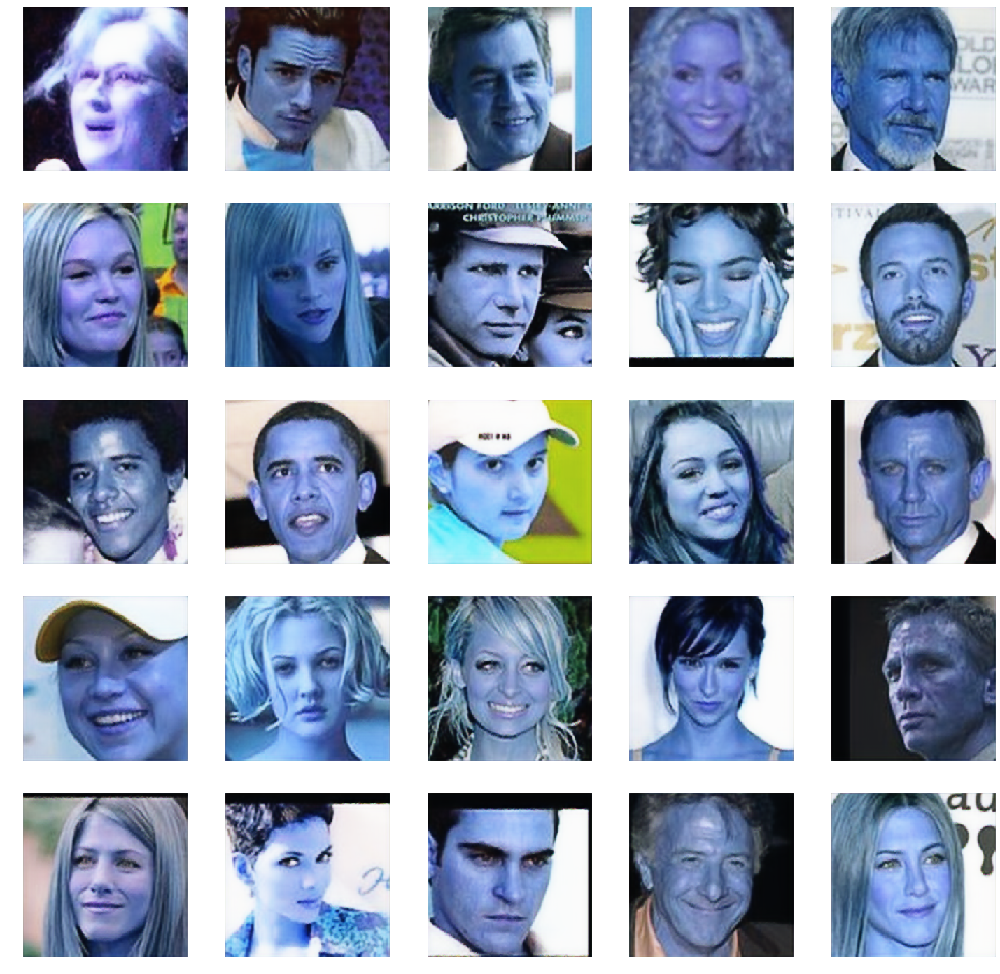

 28%|██▊       | 1402/5000 [17:38<1:53:08,  1.89s/it]

[0.005158867, 0.0]


 28%|██▊       | 1403/5000 [17:38<1:32:04,  1.54s/it]

[0.0023408802, 0.0]


 28%|██▊       | 1404/5000 [17:39<1:17:20,  1.29s/it]

[0.0046178163, 0.0]


 28%|██▊       | 1405/5000 [17:40<1:06:47,  1.11s/it]

[0.0029057683, 0.0]


 28%|██▊       | 1406/5000 [17:41<59:35,  1.01it/s]  

[0.007221608, 0.0]


 28%|██▊       | 1407/5000 [17:41<54:19,  1.10it/s]

[0.0033333811, 0.0]


 28%|██▊       | 1408/5000 [17:42<50:57,  1.17it/s]

[0.0028047357, 0.0]


 28%|██▊       | 1409/5000 [17:43<48:16,  1.24it/s]

[0.0043696663, 0.0]


 28%|██▊       | 1410/5000 [17:43<46:37,  1.28it/s]

[0.004758296, 0.0]


 28%|██▊       | 1411/5000 [17:44<45:17,  1.32it/s]

[0.0028698333, 0.0]


 28%|██▊       | 1412/5000 [17:45<44:36,  1.34it/s]

[0.0052355067, 0.0]


 28%|██▊       | 1413/5000 [17:46<43:47,  1.37it/s]

[0.0025735449, 0.0]


 28%|██▊       | 1414/5000 [17:46<43:32,  1.37it/s]

[0.0034860992, 0.0]


 28%|██▊       | 1415/5000 [17:47<43:04,  1.39it/s]

[0.0021350312, 0.0]


 28%|██▊       | 1416/5000 [17:48<43:07,  1.39it/s]

[0.005213572, 0.0]


 28%|██▊       | 1417/5000 [17:48<42:50,  1.39it/s]

[0.0025672237, 0.0]


 28%|██▊       | 1418/5000 [17:49<42:54,  1.39it/s]

[0.0021849188, 0.0]


 28%|██▊       | 1419/5000 [17:50<42:40,  1.40it/s]

[0.0066051246, 0.0]


 28%|██▊       | 1420/5000 [17:51<42:39,  1.40it/s]

[0.0021814245, 0.0]


 28%|██▊       | 1421/5000 [17:51<42:28,  1.40it/s]

[0.0028089248, 0.0]


 28%|██▊       | 1422/5000 [17:52<42:39,  1.40it/s]

[0.0023526528, 0.0]


 28%|██▊       | 1423/5000 [17:53<42:26,  1.40it/s]

[0.004500385, 0.0]


 28%|██▊       | 1424/5000 [17:53<42:32,  1.40it/s]

[0.002490547, 0.0]


 28%|██▊       | 1425/5000 [17:54<42:19,  1.41it/s]

[0.0034897448, 0.0]


 29%|██▊       | 1426/5000 [17:55<42:26,  1.40it/s]

[0.0032330337, 0.0]


 29%|██▊       | 1427/5000 [17:56<42:11,  1.41it/s]

[0.0025410545, 0.0]


 29%|██▊       | 1428/5000 [17:56<42:21,  1.41it/s]

[0.0049769855, 0.0]


 29%|██▊       | 1429/5000 [17:57<42:13,  1.41it/s]

[0.0018760632, 0.0]


 29%|██▊       | 1430/5000 [17:58<42:15,  1.41it/s]

[0.001995138, 0.0]


 29%|██▊       | 1431/5000 [17:58<42:10,  1.41it/s]

[0.0065877037, 0.0]


 29%|██▊       | 1432/5000 [17:59<42:20,  1.40it/s]

[0.0022164655, 0.0]


 29%|██▊       | 1433/5000 [18:00<42:13,  1.41it/s]

[0.0063714273, 0.0]


 29%|██▊       | 1434/5000 [18:01<42:18,  1.40it/s]

[0.0020140943, 0.0]


 29%|██▊       | 1435/5000 [18:01<42:13,  1.41it/s]

[0.002067423, 0.0]


 29%|██▊       | 1436/5000 [18:02<42:18,  1.40it/s]

[0.002567022, 0.0]


 29%|██▊       | 1437/5000 [18:03<42:12,  1.41it/s]

[0.0016953134, 0.0]


 29%|██▉       | 1438/5000 [18:03<42:13,  1.41it/s]

[0.0027263828, 0.0]


 29%|██▉       | 1439/5000 [18:04<42:06,  1.41it/s]

[0.0025057322, 0.0]


 29%|██▉       | 1440/5000 [18:05<42:12,  1.41it/s]

[0.006059806, 0.0]


 29%|██▉       | 1441/5000 [18:05<42:05,  1.41it/s]

[0.00537376, 0.0]


 29%|██▉       | 1442/5000 [18:06<42:11,  1.41it/s]

[0.008471869, 0.0]


 29%|██▉       | 1443/5000 [18:07<42:03,  1.41it/s]

[0.0023247702, 0.0]


 29%|██▉       | 1444/5000 [18:08<42:12,  1.40it/s]

[0.002015661, 0.0]


 29%|██▉       | 1445/5000 [18:08<42:05,  1.41it/s]

[0.0028017254, 0.0]


 29%|██▉       | 1446/5000 [18:09<42:11,  1.40it/s]

[0.011449634, 0.0]


 29%|██▉       | 1447/5000 [18:10<42:04,  1.41it/s]

[0.001927046, 0.0]


 29%|██▉       | 1448/5000 [18:10<42:08,  1.40it/s]

[0.002003217, 0.0]


 29%|██▉       | 1449/5000 [18:11<42:02,  1.41it/s]

[0.0075329132, 0.0]


 29%|██▉       | 1450/5000 [18:12<42:07,  1.40it/s]

[0.001888051, 0.0]


 29%|██▉       | 1451/5000 [18:13<41:58,  1.41it/s]

[0.001962835, 0.0]
1450 [G loss: 0.001963, G acc.: 0.00%]


 29%|██▉       | 1452/5000 [18:13<42:05,  1.41it/s]

[0.0025035497, 0.0]


 29%|██▉       | 1453/5000 [18:14<41:56,  1.41it/s]

[0.0035624814, 0.0]


 29%|██▉       | 1454/5000 [18:15<42:03,  1.41it/s]

[0.002244104, 0.0]


 29%|██▉       | 1455/5000 [18:15<41:51,  1.41it/s]

[0.0018546175, 0.0]


 29%|██▉       | 1456/5000 [18:16<42:00,  1.41it/s]

[0.0047854343, 0.0]


 29%|██▉       | 1457/5000 [18:17<41:49,  1.41it/s]

[0.0020350204, 0.0]


 29%|██▉       | 1458/5000 [18:18<41:56,  1.41it/s]

[0.0027093464, 0.0]


 29%|██▉       | 1459/5000 [18:18<41:51,  1.41it/s]

[0.0026561199, 0.0]


 29%|██▉       | 1460/5000 [18:19<41:58,  1.41it/s]

[0.0024936406, 0.0]


 29%|██▉       | 1461/5000 [18:20<41:54,  1.41it/s]

[0.002968328, 0.0]


 29%|██▉       | 1462/5000 [18:20<42:00,  1.40it/s]

[0.0030151159, 0.0]


 29%|██▉       | 1463/5000 [18:21<41:52,  1.41it/s]

[0.009613265, 0.0]


 29%|██▉       | 1464/5000 [18:22<42:00,  1.40it/s]

[0.001841046, 0.0]


 29%|██▉       | 1465/5000 [18:23<41:48,  1.41it/s]

[0.002440795, 0.0]


 29%|██▉       | 1466/5000 [18:23<41:59,  1.40it/s]

[0.0021689339, 0.0]


 29%|██▉       | 1467/5000 [18:24<41:47,  1.41it/s]

[0.005192934, 0.0]


 29%|██▉       | 1468/5000 [18:25<41:52,  1.41it/s]

[0.00199444, 0.0]


 29%|██▉       | 1469/5000 [18:25<41:42,  1.41it/s]

[0.001996205, 0.0]


 29%|██▉       | 1470/5000 [18:26<41:48,  1.41it/s]

[0.0045517283, 0.0]


 29%|██▉       | 1471/5000 [18:27<41:41,  1.41it/s]

[0.0025493433, 0.0]


 29%|██▉       | 1472/5000 [18:28<41:46,  1.41it/s]

[0.00311577, 0.0]


 29%|██▉       | 1473/5000 [18:28<41:44,  1.41it/s]

[0.0018672883, 0.0]


 29%|██▉       | 1474/5000 [18:29<41:53,  1.40it/s]

[0.0019943176, 0.0]


 30%|██▉       | 1475/5000 [18:30<41:42,  1.41it/s]

[0.007566541, 0.0]


 30%|██▉       | 1476/5000 [18:30<41:51,  1.40it/s]

[0.001760754, 0.0]


 30%|██▉       | 1477/5000 [18:31<41:42,  1.41it/s]

[0.0019510407, 0.0]


 30%|██▉       | 1478/5000 [18:32<41:52,  1.40it/s]

[0.0034842743, 0.0]


 30%|██▉       | 1479/5000 [18:32<41:46,  1.40it/s]

[0.00448085, 0.0]


 30%|██▉       | 1480/5000 [18:33<41:49,  1.40it/s]

[0.003164079, 0.0]


 30%|██▉       | 1481/5000 [18:34<41:36,  1.41it/s]

[0.002984951, 0.0]


 30%|██▉       | 1482/5000 [18:35<41:40,  1.41it/s]

[0.005826525, 0.0]


 30%|██▉       | 1483/5000 [18:35<41:31,  1.41it/s]

[0.0020805588, 0.0]


 30%|██▉       | 1484/5000 [18:36<41:43,  1.40it/s]

[0.0030007046, 0.0]


 30%|██▉       | 1485/5000 [18:37<41:36,  1.41it/s]

[0.003590418, 0.0]


 30%|██▉       | 1486/5000 [18:37<41:48,  1.40it/s]

[0.002987534, 0.0]


 30%|██▉       | 1487/5000 [18:38<41:37,  1.41it/s]

[0.007532655, 0.0]


 30%|██▉       | 1488/5000 [18:39<41:45,  1.40it/s]

[0.004822961, 0.0]


 30%|██▉       | 1489/5000 [18:40<41:37,  1.41it/s]

[0.00270848, 0.0]


 30%|██▉       | 1490/5000 [18:40<41:41,  1.40it/s]

[0.006562183, 0.0]


 30%|██▉       | 1491/5000 [18:41<41:36,  1.41it/s]

[0.0048223655, 0.0]


 30%|██▉       | 1492/5000 [18:42<41:39,  1.40it/s]

[0.0021710217, 0.0]


 30%|██▉       | 1493/5000 [18:42<41:30,  1.41it/s]

[0.0030020727, 0.0]


 30%|██▉       | 1494/5000 [18:43<41:41,  1.40it/s]

[0.004209484, 0.0]


 30%|██▉       | 1495/5000 [18:44<41:28,  1.41it/s]

[0.0060054823, 0.0]


 30%|██▉       | 1496/5000 [18:45<41:33,  1.41it/s]

[0.0021853554, 0.0]


 30%|██▉       | 1497/5000 [18:45<41:32,  1.41it/s]

[0.0029222467, 0.0]


 30%|██▉       | 1498/5000 [18:46<41:39,  1.40it/s]

[0.0044975695, 0.0]


 30%|██▉       | 1499/5000 [18:47<41:31,  1.40it/s]

[0.002374465, 0.0]


 30%|███       | 1500/5000 [18:47<41:40,  1.40it/s]

[0.0056758146, 0.0]


 30%|███       | 1501/5000 [18:48<41:27,  1.41it/s]

[0.0022016345, 0.0]
1500 [G loss: 0.002202, G acc.: 0.00%]


 30%|███       | 1502/5000 [18:49<41:41,  1.40it/s]

[0.0061844243, 0.0]


 30%|███       | 1503/5000 [18:50<41:29,  1.40it/s]

[0.0021068605, 0.0]


 30%|███       | 1504/5000 [18:50<41:43,  1.40it/s]

[0.002902126, 0.0]


 30%|███       | 1505/5000 [18:51<41:32,  1.40it/s]

[0.0017928589, 0.0]


 30%|███       | 1506/5000 [18:52<41:47,  1.39it/s]

[0.0056535336, 0.0]


 30%|███       | 1507/5000 [18:52<41:43,  1.40it/s]

[0.0031740586, 0.0]


 30%|███       | 1508/5000 [18:53<41:45,  1.39it/s]

[0.003386187, 0.0]


 30%|███       | 1509/5000 [18:54<41:28,  1.40it/s]

[0.0021955185, 0.0]


 30%|███       | 1510/5000 [18:55<41:31,  1.40it/s]

[0.002715799, 0.0]


 30%|███       | 1511/5000 [18:55<41:22,  1.41it/s]

[0.0018054598, 0.0]


 30%|███       | 1512/5000 [18:56<41:26,  1.40it/s]

[0.0030467815, 0.0]


 30%|███       | 1513/5000 [18:57<41:15,  1.41it/s]

[0.004942866, 0.0]


 30%|███       | 1514/5000 [18:57<41:21,  1.40it/s]

[0.0022325711, 0.0]


 30%|███       | 1515/5000 [18:58<41:10,  1.41it/s]

[0.0029201012, 0.0]


 30%|███       | 1516/5000 [18:59<41:17,  1.41it/s]

[0.006453884, 0.0]


 30%|███       | 1517/5000 [19:00<41:22,  1.40it/s]

[0.0022538302, 0.0]


 30%|███       | 1518/5000 [19:00<41:37,  1.39it/s]

[0.002161568, 0.0]


 30%|███       | 1519/5000 [19:01<41:20,  1.40it/s]

[0.0025633425, 0.0]


 30%|███       | 1520/5000 [19:02<41:24,  1.40it/s]

[0.0023728844, 0.0]


 30%|███       | 1521/5000 [19:02<41:09,  1.41it/s]

[0.0019594543, 0.0]


 30%|███       | 1522/5000 [19:03<41:17,  1.40it/s]

[0.002994406, 0.0]


 30%|███       | 1523/5000 [19:04<41:05,  1.41it/s]

[0.002442408, 0.0]


 30%|███       | 1524/5000 [19:05<41:12,  1.41it/s]

[0.0033872395, 0.0]


 30%|███       | 1525/5000 [19:05<41:05,  1.41it/s]

[0.0025068088, 0.0]


 31%|███       | 1526/5000 [19:06<41:11,  1.41it/s]

[0.0018111924, 0.0]


 31%|███       | 1527/5000 [19:07<41:03,  1.41it/s]

[0.0045452244, 0.0]


 31%|███       | 1528/5000 [19:07<41:09,  1.41it/s]

[0.0017358755, 0.0]


 31%|███       | 1529/5000 [19:08<41:03,  1.41it/s]

[0.0021345834, 0.0]


 31%|███       | 1530/5000 [19:09<41:12,  1.40it/s]

[0.005108853, 0.0]


 31%|███       | 1531/5000 [19:10<41:02,  1.41it/s]

[0.0032243682, 0.0]


 31%|███       | 1532/5000 [19:10<41:08,  1.40it/s]

[0.0027571083, 0.0]


 31%|███       | 1533/5000 [19:11<41:00,  1.41it/s]

[0.0033903054, 0.0]


 31%|███       | 1534/5000 [19:12<41:02,  1.41it/s]

[0.003798641, 0.0]


 31%|███       | 1535/5000 [19:12<40:54,  1.41it/s]

[0.0099470485, 0.0]


 31%|███       | 1536/5000 [19:13<41:03,  1.41it/s]

[0.00177913, 0.0]


 31%|███       | 1537/5000 [19:14<40:57,  1.41it/s]

[0.0030130942, 0.0]


 31%|███       | 1538/5000 [19:14<40:58,  1.41it/s]

[0.005257446, 0.0]


 31%|███       | 1539/5000 [19:15<40:54,  1.41it/s]

[0.0019715368, 0.0]


 31%|███       | 1540/5000 [19:16<41:01,  1.41it/s]

[0.0028696635, 0.0]


 31%|███       | 1541/5000 [19:17<40:54,  1.41it/s]

[0.0017951338, 0.0]


 31%|███       | 1542/5000 [19:17<41:00,  1.41it/s]

[0.0028402784, 0.0]


 31%|███       | 1543/5000 [19:18<40:51,  1.41it/s]

[0.0026910105, 0.0]


 31%|███       | 1544/5000 [19:19<40:55,  1.41it/s]

[0.0033972014, 0.0]


 31%|███       | 1545/5000 [19:19<40:49,  1.41it/s]

[0.0021159772, 0.0]


 31%|███       | 1546/5000 [19:20<40:53,  1.41it/s]

[0.0018686742, 0.0]


 31%|███       | 1547/5000 [19:21<40:48,  1.41it/s]

[0.0019038315, 0.0]


 31%|███       | 1548/5000 [19:22<40:52,  1.41it/s]

[0.0039084293, 0.0]


 31%|███       | 1549/5000 [19:22<40:46,  1.41it/s]

[0.0023260335, 0.0]


 31%|███       | 1550/5000 [19:23<40:54,  1.41it/s]

[0.009562694, 0.0]


 31%|███       | 1551/5000 [19:24<40:45,  1.41it/s]

[0.0071031186, 0.0]
1550 [G loss: 0.007103, G acc.: 0.00%]


 31%|███       | 1552/5000 [19:24<40:47,  1.41it/s]

[0.0034929118, 0.0]


 31%|███       | 1553/5000 [19:25<40:40,  1.41it/s]

[0.0024926378, 0.0]


 31%|███       | 1554/5000 [19:26<40:48,  1.41it/s]

[0.0027739378, 0.0]


 31%|███       | 1555/5000 [19:27<40:39,  1.41it/s]

[0.005025679, 0.0]


 31%|███       | 1556/5000 [19:27<40:47,  1.41it/s]

[0.0036434869, 0.0]


 31%|███       | 1557/5000 [19:28<40:43,  1.41it/s]

[0.004694599, 0.0]


 31%|███       | 1558/5000 [19:29<40:45,  1.41it/s]

[0.0032288192, 0.0]


 31%|███       | 1559/5000 [19:29<40:38,  1.41it/s]

[0.0027221104, 0.0]


 31%|███       | 1560/5000 [19:30<40:45,  1.41it/s]

[0.0025274435, 0.0]


 31%|███       | 1561/5000 [19:31<40:34,  1.41it/s]

[0.0049726414, 0.0]


 31%|███       | 1562/5000 [19:32<40:43,  1.41it/s]

[0.01121411, 0.0]


 31%|███▏      | 1563/5000 [19:32<40:38,  1.41it/s]

[0.0030543115, 0.0]


 31%|███▏      | 1564/5000 [19:33<40:43,  1.41it/s]

[0.012217006, 0.0]


 31%|███▏      | 1565/5000 [19:34<40:37,  1.41it/s]

[0.0047158436, 0.0]


 31%|███▏      | 1566/5000 [19:34<40:46,  1.40it/s]

[0.0030671475, 0.0]


 31%|███▏      | 1567/5000 [19:35<40:36,  1.41it/s]

[0.0042928383, 0.0]


 31%|███▏      | 1568/5000 [19:36<40:40,  1.41it/s]

[0.0017559552, 0.0]


 31%|███▏      | 1569/5000 [19:37<40:30,  1.41it/s]

[0.0027477392, 0.0]


 31%|███▏      | 1570/5000 [19:37<40:39,  1.41it/s]

[0.0019066526, 0.0]


 31%|███▏      | 1571/5000 [19:38<40:31,  1.41it/s]

[0.0029650957, 0.0]


 31%|███▏      | 1572/5000 [19:39<40:36,  1.41it/s]

[0.004271824, 0.0]


 31%|███▏      | 1573/5000 [19:39<40:34,  1.41it/s]

[0.0031443674, 0.0]


 31%|███▏      | 1574/5000 [19:40<40:39,  1.40it/s]

[0.003520589, 0.0]


 32%|███▏      | 1575/5000 [19:41<40:30,  1.41it/s]

[0.0049556647, 0.0]


 32%|███▏      | 1576/5000 [19:41<40:35,  1.41it/s]

[0.0017752103, 0.0]


 32%|███▏      | 1577/5000 [19:42<40:27,  1.41it/s]

[0.002087556, 0.0]


 32%|███▏      | 1578/5000 [19:43<40:30,  1.41it/s]

[0.00885262, 0.0]


 32%|███▏      | 1579/5000 [19:44<40:19,  1.41it/s]

[0.005782952, 0.0]


 32%|███▏      | 1580/5000 [19:44<40:32,  1.41it/s]

[0.0030678306, 0.0]


 32%|███▏      | 1581/5000 [19:45<40:22,  1.41it/s]

[0.0026793054, 0.0]


 32%|███▏      | 1582/5000 [19:46<40:28,  1.41it/s]

[0.0020775017, 0.0]


 32%|███▏      | 1583/5000 [19:46<40:18,  1.41it/s]

[0.0020354188, 0.0]


 32%|███▏      | 1584/5000 [19:47<40:25,  1.41it/s]

[0.0028540876, 0.0]


 32%|███▏      | 1585/5000 [19:48<40:20,  1.41it/s]

[0.0021675837, 0.0]


 32%|███▏      | 1586/5000 [19:49<40:29,  1.41it/s]

[0.0019294228, 0.0]


 32%|███▏      | 1587/5000 [19:49<40:27,  1.41it/s]

[0.0032111146, 0.0]


 32%|███▏      | 1588/5000 [19:50<40:36,  1.40it/s]

[0.0019470991, 0.0]


 32%|███▏      | 1589/5000 [19:51<40:22,  1.41it/s]

[0.0077511007, 0.0]


 32%|███▏      | 1590/5000 [19:51<40:26,  1.41it/s]

[0.0021654614, 0.0]


 32%|███▏      | 1591/5000 [19:52<40:19,  1.41it/s]

[0.002539677, 0.0]


 32%|███▏      | 1592/5000 [19:53<40:25,  1.40it/s]

[0.007236852, 0.0]


 32%|███▏      | 1593/5000 [19:54<40:14,  1.41it/s]

[0.0027441613, 0.0]


 32%|███▏      | 1594/5000 [19:54<40:25,  1.40it/s]

[0.0021012854, 0.0]


 32%|███▏      | 1595/5000 [19:55<40:16,  1.41it/s]

[0.0029352366, 0.0]


 32%|███▏      | 1596/5000 [19:56<40:20,  1.41it/s]

[0.0031278862, 0.0]


 32%|███▏      | 1597/5000 [19:56<40:12,  1.41it/s]

[0.0022341996, 0.0]


 32%|███▏      | 1598/5000 [19:57<40:21,  1.41it/s]

[0.0057053305, 0.0]


 32%|███▏      | 1599/5000 [19:58<40:13,  1.41it/s]

[0.0033970536, 0.0]


 32%|███▏      | 1600/5000 [19:59<40:22,  1.40it/s]

[0.0023517774, 0.0]
[0.0033560067, 0.0]
1600 [G loss: 0.003356, G acc.: 0.00%]


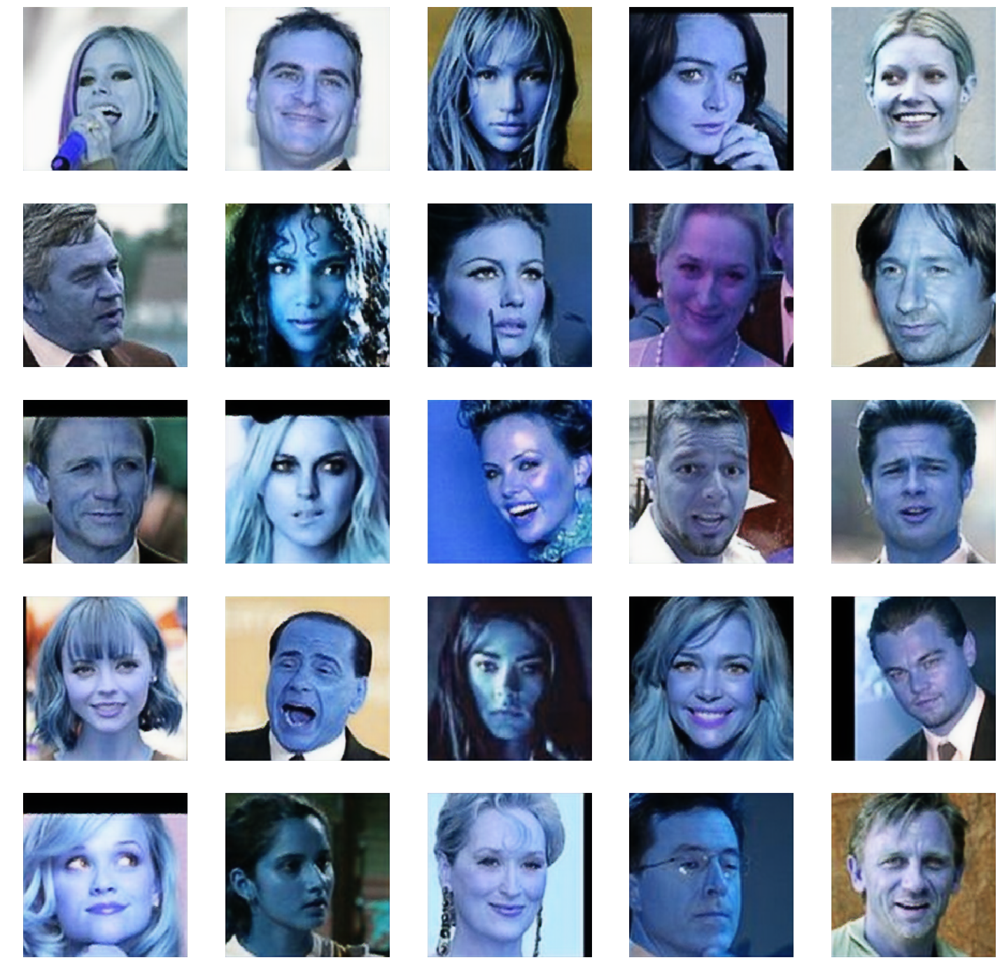

 32%|███▏      | 1602/5000 [20:05<1:43:42,  1.83s/it]

[0.0018534581, 0.0]


 32%|███▏      | 1603/5000 [20:06<1:24:43,  1.50s/it]

[0.002168853, 0.0]


 32%|███▏      | 1604/5000 [20:07<1:11:40,  1.27s/it]

[0.002236253, 0.0]


 32%|███▏      | 1605/5000 [20:07<1:02:15,  1.10s/it]

[0.0018808801, 0.0]


 32%|███▏      | 1606/5000 [20:08<55:43,  1.02it/s]  

[0.0017482063, 0.0]


 32%|███▏      | 1607/5000 [20:09<50:55,  1.11it/s]

[0.002468992, 0.0]


 32%|███▏      | 1608/5000 [20:10<47:44,  1.18it/s]

[0.0035569482, 0.0]


 32%|███▏      | 1609/5000 [20:10<45:21,  1.25it/s]

[0.0019266562, 0.0]


 32%|███▏      | 1610/5000 [20:11<43:50,  1.29it/s]

[0.0028679136, 0.0]


 32%|███▏      | 1611/5000 [20:12<42:40,  1.32it/s]

[0.0020882557, 0.0]


 32%|███▏      | 1612/5000 [20:12<41:58,  1.35it/s]

[0.001987564, 0.0]


 32%|███▏      | 1613/5000 [20:13<41:20,  1.37it/s]

[0.003265109, 0.0]


 32%|███▏      | 1614/5000 [20:14<41:05,  1.37it/s]

[0.001547961, 0.0]


 32%|███▏      | 1615/5000 [20:15<40:41,  1.39it/s]

[0.0036125323, 0.0]


 32%|███▏      | 1616/5000 [20:15<40:38,  1.39it/s]

[0.0019426331, 0.0]


 32%|███▏      | 1617/5000 [20:16<40:21,  1.40it/s]

[0.0021298719, 0.0]


 32%|███▏      | 1618/5000 [20:17<40:20,  1.40it/s]

[0.00182296, 0.0]


 32%|███▏      | 1619/5000 [20:17<40:09,  1.40it/s]

[0.0017381415, 0.0]


 32%|███▏      | 1620/5000 [20:18<40:12,  1.40it/s]

[0.0018070781, 0.0]


 32%|███▏      | 1621/5000 [20:19<39:55,  1.41it/s]

[0.0034182724, 0.0]


 32%|███▏      | 1622/5000 [20:19<40:01,  1.41it/s]

[0.0020232068, 0.0]


 32%|███▏      | 1623/5000 [20:20<39:57,  1.41it/s]

[0.0033049213, 0.0]


 32%|███▏      | 1624/5000 [20:21<40:05,  1.40it/s]

[0.0021752007, 0.0]


 32%|███▎      | 1625/5000 [20:22<40:02,  1.40it/s]

[0.0024590946, 0.0]


 33%|███▎      | 1626/5000 [20:22<40:10,  1.40it/s]

[0.002409911, 0.0]


 33%|███▎      | 1627/5000 [20:23<39:56,  1.41it/s]

[0.0023877241, 0.0]


 33%|███▎      | 1628/5000 [20:24<40:06,  1.40it/s]

[0.0017753505, 0.0]


 33%|███▎      | 1629/5000 [20:24<40:08,  1.40it/s]

[0.0032624244, 0.0]


 33%|███▎      | 1630/5000 [20:25<40:11,  1.40it/s]

[0.003175848, 0.0]


 33%|███▎      | 1631/5000 [20:26<40:03,  1.40it/s]

[0.0031288492, 0.0]


 33%|███▎      | 1632/5000 [20:27<40:05,  1.40it/s]

[0.0019455613, 0.0]


 33%|███▎      | 1633/5000 [20:27<39:55,  1.41it/s]

[0.002836044, 0.0]


 33%|███▎      | 1634/5000 [20:28<40:04,  1.40it/s]

[0.0023218424, 0.0]


 33%|███▎      | 1635/5000 [20:29<40:09,  1.40it/s]

[0.004691359, 0.0]


 33%|███▎      | 1636/5000 [20:29<40:16,  1.39it/s]

[0.0017850474, 0.0]


 33%|███▎      | 1637/5000 [20:30<39:59,  1.40it/s]

[0.005340469, 0.0]


 33%|███▎      | 1638/5000 [20:31<40:09,  1.40it/s]

[0.0015554663, 0.0]


 33%|███▎      | 1639/5000 [20:32<40:01,  1.40it/s]

[0.0026142707, 0.0]


 33%|███▎      | 1640/5000 [20:32<40:02,  1.40it/s]

[0.0017234468, 0.0]


 33%|███▎      | 1641/5000 [20:33<39:59,  1.40it/s]

[0.0023669836, 0.0]


 33%|███▎      | 1642/5000 [20:34<40:08,  1.39it/s]

[0.0019382606, 0.0]


 33%|███▎      | 1643/5000 [20:34<39:53,  1.40it/s]

[0.0020857959, 0.0]


 33%|███▎      | 1644/5000 [20:35<39:57,  1.40it/s]

[0.0059300605, 0.0]


 33%|███▎      | 1645/5000 [20:36<39:46,  1.41it/s]

[0.0019119038, 0.0]


 33%|███▎      | 1646/5000 [20:37<39:51,  1.40it/s]

[0.003517573, 0.0]


 33%|███▎      | 1647/5000 [20:37<39:39,  1.41it/s]

[0.0037030769, 0.0]


 33%|███▎      | 1648/5000 [20:38<39:45,  1.41it/s]

[0.0025746962, 0.0]


 33%|███▎      | 1649/5000 [20:39<39:39,  1.41it/s]

[0.0018931131, 0.0]


 33%|███▎      | 1650/5000 [20:39<39:46,  1.40it/s]

[0.0040701674, 0.0]


 33%|███▎      | 1651/5000 [20:40<39:40,  1.41it/s]

[0.0059712096, 0.0]
1650 [G loss: 0.005971, G acc.: 0.00%]


 33%|███▎      | 1652/5000 [20:41<39:50,  1.40it/s]

[0.0015534852, 0.0]


 33%|███▎      | 1653/5000 [20:42<39:36,  1.41it/s]

[0.0045050373, 0.0]


 33%|███▎      | 1654/5000 [20:42<39:40,  1.41it/s]

[0.00164462, 0.0]


 33%|███▎      | 1655/5000 [20:43<39:32,  1.41it/s]

[0.0020460477, 0.0]


 33%|███▎      | 1656/5000 [20:44<39:42,  1.40it/s]

[0.0019525622, 0.0]


 33%|███▎      | 1657/5000 [20:44<39:33,  1.41it/s]

[0.0024216399, 0.0]


 33%|███▎      | 1658/5000 [20:45<39:42,  1.40it/s]

[0.00225571, 0.0]


 33%|███▎      | 1659/5000 [20:46<39:36,  1.41it/s]

[0.0031096835, 0.0]


 33%|███▎      | 1660/5000 [20:47<39:35,  1.41it/s]

[0.0035125155, 0.0]


 33%|███▎      | 1661/5000 [20:47<39:29,  1.41it/s]

[0.0028244513, 0.0]


 33%|███▎      | 1662/5000 [20:48<39:30,  1.41it/s]

[0.00344111, 0.0]


 33%|███▎      | 1663/5000 [20:49<39:27,  1.41it/s]

[0.0062314267, 0.0]


 33%|███▎      | 1664/5000 [20:49<39:37,  1.40it/s]

[0.003936798, 0.0]


 33%|███▎      | 1665/5000 [20:50<39:27,  1.41it/s]

[0.0051729954, 0.0]


 33%|███▎      | 1666/5000 [20:51<39:33,  1.40it/s]

[0.0047963676, 0.0]


 33%|███▎      | 1667/5000 [20:52<39:22,  1.41it/s]

[0.0039926535, 0.0]


 33%|███▎      | 1668/5000 [20:52<39:34,  1.40it/s]

[0.0016959737, 0.0]


 33%|███▎      | 1669/5000 [20:53<39:25,  1.41it/s]

[0.0020567926, 0.0]


 33%|███▎      | 1670/5000 [20:54<39:33,  1.40it/s]

[0.0029786774, 0.0]


 33%|███▎      | 1671/5000 [20:54<39:28,  1.41it/s]

[0.0018574407, 0.0]


 33%|███▎      | 1672/5000 [20:55<39:37,  1.40it/s]

[0.0018071317, 0.0]


 33%|███▎      | 1673/5000 [20:56<39:33,  1.40it/s]

[0.0018804981, 0.0]


 33%|███▎      | 1674/5000 [20:57<39:34,  1.40it/s]

[0.0025488946, 0.0]


 34%|███▎      | 1675/5000 [20:57<39:27,  1.40it/s]

[0.002712635, 0.0]


 34%|███▎      | 1676/5000 [20:58<39:34,  1.40it/s]

[0.0020777127, 0.0]


 34%|███▎      | 1677/5000 [20:59<39:22,  1.41it/s]

[0.0032164324, 0.0]


 34%|███▎      | 1678/5000 [20:59<39:27,  1.40it/s]

[0.001863487, 0.0]


 34%|███▎      | 1679/5000 [21:00<39:16,  1.41it/s]

[0.0021640605, 0.0]


 34%|███▎      | 1680/5000 [21:01<39:26,  1.40it/s]

[0.0032936384, 0.0]


 34%|███▎      | 1681/5000 [21:02<39:22,  1.40it/s]

[0.0029763635, 0.0]


 34%|███▎      | 1682/5000 [21:02<39:24,  1.40it/s]

[0.0020054425, 0.0]


 34%|███▎      | 1683/5000 [21:03<39:17,  1.41it/s]

[0.006809372, 0.0]


 34%|███▎      | 1684/5000 [21:04<39:19,  1.41it/s]

[0.0021020942, 0.0]


 34%|███▎      | 1685/5000 [21:04<39:14,  1.41it/s]

[0.0027666031, 0.0]


 34%|███▎      | 1686/5000 [21:05<39:18,  1.41it/s]

[0.0027638825, 0.0]


 34%|███▎      | 1687/5000 [21:06<39:05,  1.41it/s]

[0.007813801, 0.0]


 34%|███▍      | 1688/5000 [21:06<39:16,  1.41it/s]

[0.0020470824, 0.0]


 34%|███▍      | 1689/5000 [21:07<39:10,  1.41it/s]

[0.0021723374, 0.0]


 34%|███▍      | 1690/5000 [21:08<39:17,  1.40it/s]

[0.0022477813, 0.0]


 34%|███▍      | 1691/5000 [21:09<39:08,  1.41it/s]

[0.0018880159, 0.0]


 34%|███▍      | 1692/5000 [21:09<39:13,  1.41it/s]

[0.0036532579, 0.0]


 34%|███▍      | 1693/5000 [21:10<39:04,  1.41it/s]

[0.0019120097, 0.0]


 34%|███▍      | 1694/5000 [21:11<39:11,  1.41it/s]

[0.004129588, 0.0]


 34%|███▍      | 1695/5000 [21:11<39:08,  1.41it/s]

[0.0025992715, 0.0]


 34%|███▍      | 1696/5000 [21:12<39:12,  1.40it/s]

[0.0020245903, 0.0]


 34%|███▍      | 1697/5000 [21:13<39:06,  1.41it/s]

[0.0018002396, 0.0]


 34%|███▍      | 1698/5000 [21:14<39:09,  1.41it/s]

[0.0020622557, 0.0]


 34%|███▍      | 1699/5000 [21:14<38:59,  1.41it/s]

[0.001603948, 0.0]


 34%|███▍      | 1700/5000 [21:15<39:10,  1.40it/s]

[0.0037244358, 0.0]


 34%|███▍      | 1701/5000 [21:16<39:03,  1.41it/s]

[0.0049421163, 0.0]
1700 [G loss: 0.004942, G acc.: 0.00%]


 34%|███▍      | 1702/5000 [21:16<39:05,  1.41it/s]

[0.0018193377, 0.0]


 34%|███▍      | 1703/5000 [21:17<38:58,  1.41it/s]

[0.0062472266, 0.0]


 34%|███▍      | 1704/5000 [21:18<39:02,  1.41it/s]

[0.0026318429, 0.0]


 34%|███▍      | 1705/5000 [21:19<38:57,  1.41it/s]

[0.0019568573, 0.0]


 34%|███▍      | 1706/5000 [21:19<39:03,  1.41it/s]

[0.002948205, 0.0]


 34%|███▍      | 1707/5000 [21:20<38:58,  1.41it/s]

[0.002215632, 0.0]


 34%|███▍      | 1708/5000 [21:21<39:05,  1.40it/s]

[0.0025634987, 0.0]


 34%|███▍      | 1709/5000 [21:21<38:54,  1.41it/s]

[0.002603255, 0.0]


 34%|███▍      | 1710/5000 [21:22<39:00,  1.41it/s]

[0.002464561, 0.0]


 34%|███▍      | 1711/5000 [21:23<38:51,  1.41it/s]

[0.0033164779, 0.0]


 34%|███▍      | 1712/5000 [21:24<38:57,  1.41it/s]

[0.002288922, 0.0]


 34%|███▍      | 1713/5000 [21:24<38:50,  1.41it/s]

[0.0056253527, 0.0]


 34%|███▍      | 1714/5000 [21:25<39:00,  1.40it/s]

[0.0028897403, 0.0]


 34%|███▍      | 1715/5000 [21:26<38:47,  1.41it/s]

[0.0020562701, 0.0]


 34%|███▍      | 1716/5000 [21:26<38:56,  1.41it/s]

[0.005144528, 0.0]


 34%|███▍      | 1717/5000 [21:27<38:46,  1.41it/s]

[0.002047534, 0.0]


 34%|███▍      | 1718/5000 [21:28<38:55,  1.41it/s]

[0.0063614077, 0.0]


 34%|███▍      | 1719/5000 [21:29<38:46,  1.41it/s]

[0.0033504926, 0.0]


 34%|███▍      | 1720/5000 [21:29<38:58,  1.40it/s]

[0.001792132, 0.0]


 34%|███▍      | 1721/5000 [21:30<38:52,  1.41it/s]

[0.0081136, 0.0]


 34%|███▍      | 1722/5000 [21:31<38:56,  1.40it/s]

[0.004849618, 0.0]


 34%|███▍      | 1723/5000 [21:31<38:44,  1.41it/s]

[0.0018090002, 0.0]


 34%|███▍      | 1724/5000 [21:32<38:51,  1.40it/s]

[0.002367998, 0.0]


 34%|███▍      | 1725/5000 [21:33<38:45,  1.41it/s]

[0.0022275879, 0.0]


 35%|███▍      | 1726/5000 [21:33<38:52,  1.40it/s]

[0.0029249215, 0.0]


 35%|███▍      | 1727/5000 [21:34<38:39,  1.41it/s]

[0.0023197867, 0.0]


 35%|███▍      | 1728/5000 [21:35<38:50,  1.40it/s]

[0.00210887, 0.0]


 35%|███▍      | 1729/5000 [21:36<38:40,  1.41it/s]

[0.004582733, 0.0]


 35%|███▍      | 1730/5000 [21:36<38:46,  1.41it/s]

[0.004070105, 0.0]


 35%|███▍      | 1731/5000 [21:37<38:34,  1.41it/s]

[0.0034588105, 0.0]


 35%|███▍      | 1732/5000 [21:38<38:45,  1.41it/s]

[0.005356347, 0.0]


 35%|███▍      | 1733/5000 [21:38<38:36,  1.41it/s]

[0.0064281737, 0.0]


 35%|███▍      | 1734/5000 [21:39<38:45,  1.40it/s]

[0.0020327903, 0.0]


 35%|███▍      | 1735/5000 [21:40<38:36,  1.41it/s]

[0.00355425, 0.0]


 35%|███▍      | 1736/5000 [21:41<38:41,  1.41it/s]

[0.005713367, 0.0]


 35%|███▍      | 1737/5000 [21:41<38:34,  1.41it/s]

[0.0050069597, 0.0]


 35%|███▍      | 1738/5000 [21:42<38:46,  1.40it/s]

[0.004112243, 0.0]


 35%|███▍      | 1739/5000 [21:43<38:36,  1.41it/s]

[0.004627301, 0.0]


 35%|███▍      | 1740/5000 [21:43<38:41,  1.40it/s]

[0.0032346996, 0.0]


 35%|███▍      | 1741/5000 [21:44<38:31,  1.41it/s]

[0.002508685, 0.0]


 35%|███▍      | 1742/5000 [21:45<38:35,  1.41it/s]

[0.0027953873, 0.0]


 35%|███▍      | 1743/5000 [21:46<38:28,  1.41it/s]

[0.0023643232, 0.0]


 35%|███▍      | 1744/5000 [21:46<38:37,  1.40it/s]

[0.007819706, 0.0]


 35%|███▍      | 1745/5000 [21:47<38:31,  1.41it/s]

[0.0017242238, 0.0]


 35%|███▍      | 1746/5000 [21:48<38:36,  1.40it/s]

[0.007123069, 0.0]


 35%|███▍      | 1747/5000 [21:48<38:24,  1.41it/s]

[0.005875766, 0.0]


 35%|███▍      | 1748/5000 [21:49<38:39,  1.40it/s]

[0.003127705, 0.0]


 35%|███▍      | 1749/5000 [21:50<38:34,  1.40it/s]

[0.0019727035, 0.0]


 35%|███▌      | 1750/5000 [21:51<38:41,  1.40it/s]

[0.0018809272, 0.0]


 35%|███▌      | 1751/5000 [21:51<38:32,  1.40it/s]

[0.005671733, 0.0]
1750 [G loss: 0.005672, G acc.: 0.00%]


 35%|███▌      | 1752/5000 [21:52<38:38,  1.40it/s]

[0.0027173052, 0.0]


 35%|███▌      | 1753/5000 [21:53<38:28,  1.41it/s]

[0.011383198, 0.0]


 35%|███▌      | 1754/5000 [21:53<38:35,  1.40it/s]

[0.007887116, 0.0]


 35%|███▌      | 1755/5000 [21:54<38:25,  1.41it/s]

[0.0040120054, 0.0]


 35%|███▌      | 1756/5000 [21:55<38:29,  1.40it/s]

[0.0018766215, 0.0]


 35%|███▌      | 1757/5000 [21:56<38:21,  1.41it/s]

[0.0026030631, 0.0]


 35%|███▌      | 1758/5000 [21:56<38:27,  1.40it/s]

[0.001918268, 0.0]


 35%|███▌      | 1759/5000 [21:57<38:21,  1.41it/s]

[0.001739106, 0.0]


 35%|███▌      | 1760/5000 [21:58<38:29,  1.40it/s]

[0.0018677692, 0.0]


 35%|███▌      | 1761/5000 [21:58<38:25,  1.40it/s]

[0.0016320079, 0.0]


 35%|███▌      | 1762/5000 [21:59<38:46,  1.39it/s]

[0.0029992727, 0.0]


 35%|███▌      | 1763/5000 [22:00<38:34,  1.40it/s]

[0.009501925, 0.0]


 35%|███▌      | 1764/5000 [22:01<38:33,  1.40it/s]

[0.003554681, 0.0]


 35%|███▌      | 1765/5000 [22:01<38:27,  1.40it/s]

[0.004871764, 0.0]


 35%|███▌      | 1766/5000 [22:02<38:28,  1.40it/s]

[0.0017374684, 0.0]


 35%|███▌      | 1767/5000 [22:03<38:18,  1.41it/s]

[0.002369461, 0.0]


 35%|███▌      | 1768/5000 [22:03<38:23,  1.40it/s]

[0.0042309845, 0.0]


 35%|███▌      | 1769/5000 [22:04<38:14,  1.41it/s]

[0.0021931573, 0.0]


 35%|███▌      | 1770/5000 [22:05<38:20,  1.40it/s]

[0.0015463539, 0.0]


 35%|███▌      | 1771/5000 [22:06<38:17,  1.41it/s]

[0.0043265717, 0.0]


 35%|███▌      | 1772/5000 [22:06<38:21,  1.40it/s]

[0.0027656406, 0.0]


 35%|███▌      | 1773/5000 [22:07<38:10,  1.41it/s]

[0.002534649, 0.0]


 35%|███▌      | 1774/5000 [22:08<38:14,  1.41it/s]

[0.0020356984, 0.0]


 36%|███▌      | 1775/5000 [22:08<38:09,  1.41it/s]

[0.004310757, 0.0]


 36%|███▌      | 1776/5000 [22:09<38:17,  1.40it/s]

[0.0015945688, 0.0]


 36%|███▌      | 1777/5000 [22:10<38:06,  1.41it/s]

[0.0019356187, 0.0]


 36%|███▌      | 1778/5000 [22:10<38:11,  1.41it/s]

[0.006656062, 0.0]


 36%|███▌      | 1779/5000 [22:11<38:02,  1.41it/s]

[0.0018264829, 0.0]


 36%|███▌      | 1780/5000 [22:12<38:14,  1.40it/s]

[0.004944323, 0.0]


 36%|███▌      | 1781/5000 [22:13<38:06,  1.41it/s]

[0.0018597743, 0.0]


 36%|███▌      | 1782/5000 [22:13<38:13,  1.40it/s]

[0.0016414745, 0.0]


 36%|███▌      | 1783/5000 [22:14<38:03,  1.41it/s]

[0.0023892785, 0.0]


 36%|███▌      | 1784/5000 [22:15<38:09,  1.40it/s]

[0.006317152, 0.0]


 36%|███▌      | 1785/5000 [22:15<38:01,  1.41it/s]

[0.0016685904, 0.0]


 36%|███▌      | 1786/5000 [22:16<38:06,  1.41it/s]

[0.0021674135, 0.0]


 36%|███▌      | 1787/5000 [22:17<38:06,  1.41it/s]

[0.0021095576, 0.0]


 36%|███▌      | 1788/5000 [22:18<38:06,  1.40it/s]

[0.0031117138, 0.0]


 36%|███▌      | 1789/5000 [22:18<37:56,  1.41it/s]

[0.002072111, 0.0]


 36%|███▌      | 1790/5000 [22:19<38:02,  1.41it/s]

[0.006143989, 0.0]


 36%|███▌      | 1791/5000 [22:20<37:56,  1.41it/s]

[0.0029420415, 0.0]


 36%|███▌      | 1792/5000 [22:20<38:02,  1.41it/s]

[0.0021107527, 0.0]


 36%|███▌      | 1793/5000 [22:21<37:55,  1.41it/s]

[0.002489128, 0.0]


 36%|███▌      | 1794/5000 [22:22<37:58,  1.41it/s]

[0.0020302786, 0.0]


 36%|███▌      | 1795/5000 [22:23<37:51,  1.41it/s]

[0.0043403506, 0.0]


 36%|███▌      | 1796/5000 [22:23<38:04,  1.40it/s]

[0.0024231714, 0.0]


 36%|███▌      | 1797/5000 [22:24<37:56,  1.41it/s]

[0.0019142741, 0.0]


 36%|███▌      | 1798/5000 [22:25<38:03,  1.40it/s]

[0.0021077823, 0.0]


 36%|███▌      | 1799/5000 [22:25<37:52,  1.41it/s]

[0.005920518, 0.0]


 36%|███▌      | 1800/5000 [22:26<37:58,  1.40it/s]

[0.0059671793, 0.0]
[0.001755151, 0.0]
1800 [G loss: 0.001755, G acc.: 0.00%]


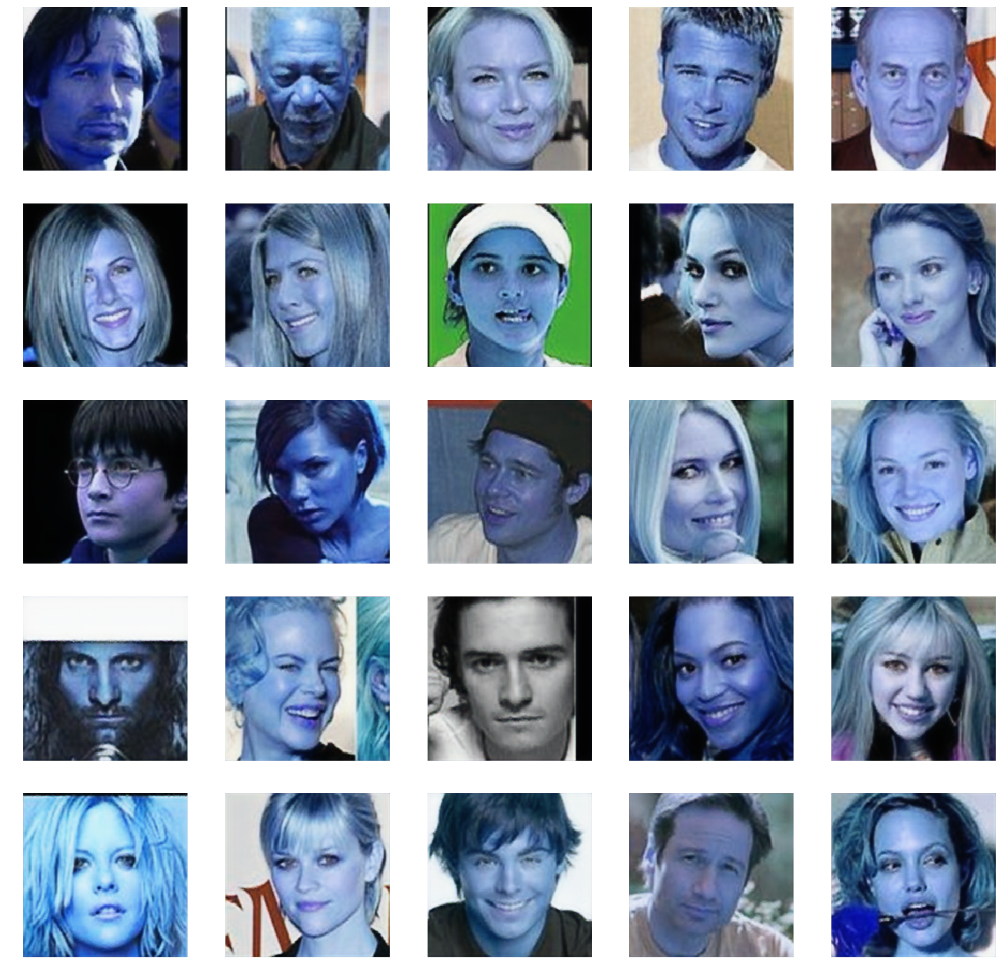

 36%|███▌      | 1802/5000 [22:33<1:37:38,  1.83s/it]

[0.00598744, 0.0]


 36%|███▌      | 1803/5000 [22:34<1:20:05,  1.50s/it]

[0.0015640637, 0.0]


 36%|███▌      | 1804/5000 [22:34<1:07:30,  1.27s/it]

[0.001986484, 0.0]


 36%|███▌      | 1805/5000 [22:35<58:47,  1.10s/it]  

[0.0016019573, 0.0]


 36%|███▌      | 1806/5000 [22:36<52:19,  1.02it/s]

[0.00867957, 0.0]


 36%|███▌      | 1807/5000 [22:36<48:04,  1.11it/s]

[0.0062230425, 0.0]


 36%|███▌      | 1808/5000 [22:37<44:55,  1.18it/s]

[0.0023466514, 0.0]


 36%|███▌      | 1809/5000 [22:38<42:53,  1.24it/s]

[0.0016078334, 0.0]


 36%|███▌      | 1810/5000 [22:39<41:16,  1.29it/s]

[0.002738647, 0.0]


 36%|███▌      | 1811/5000 [22:39<40:18,  1.32it/s]

[0.001741371, 0.0]


 36%|███▌      | 1812/5000 [22:40<39:23,  1.35it/s]

[0.008578752, 0.0]


 36%|███▋      | 1813/5000 [22:41<39:01,  1.36it/s]

[0.0037193818, 0.0]


 36%|███▋      | 1814/5000 [22:41<38:30,  1.38it/s]

[0.0021143444, 0.0]


 36%|███▋      | 1815/5000 [22:42<38:25,  1.38it/s]

[0.0021114997, 0.0]


 36%|███▋      | 1816/5000 [22:43<38:05,  1.39it/s]

[0.002213191, 0.0]


 36%|███▋      | 1817/5000 [22:44<38:03,  1.39it/s]

[0.0030199909, 0.0]


 36%|███▋      | 1818/5000 [22:44<37:52,  1.40it/s]

[0.0017906114, 0.0]


 36%|███▋      | 1819/5000 [22:45<37:54,  1.40it/s]

[0.0019034733, 0.0]


 36%|███▋      | 1820/5000 [22:46<37:45,  1.40it/s]

[0.001784626, 0.0]


 36%|███▋      | 1821/5000 [22:46<37:50,  1.40it/s]

[0.002957649, 0.0]


 36%|███▋      | 1822/5000 [22:47<37:43,  1.40it/s]

[0.0017649466, 0.0]


 36%|███▋      | 1823/5000 [22:48<37:47,  1.40it/s]

[0.0024983336, 0.0]


 36%|███▋      | 1824/5000 [22:49<37:35,  1.41it/s]

[0.0030981689, 0.0]


 36%|███▋      | 1825/5000 [22:49<37:43,  1.40it/s]

[0.0029921182, 0.0]


 37%|███▋      | 1826/5000 [22:50<37:37,  1.41it/s]

[0.0024252646, 0.0]


 37%|███▋      | 1827/5000 [22:51<37:42,  1.40it/s]

[0.001687742, 0.0]


 37%|███▋      | 1828/5000 [22:51<37:32,  1.41it/s]

[0.0064679994, 0.0]


 37%|███▋      | 1829/5000 [22:52<37:48,  1.40it/s]

[0.0015099118, 0.0]


 37%|███▋      | 1830/5000 [22:53<37:34,  1.41it/s]

[0.0017337753, 0.0]


 37%|███▋      | 1831/5000 [22:54<37:36,  1.40it/s]

[0.0019650476, 0.0]


 37%|███▋      | 1832/5000 [22:54<37:32,  1.41it/s]

[0.0021870083, 0.0]


 37%|███▋      | 1833/5000 [22:55<37:34,  1.40it/s]

[0.003546211, 0.0]


 37%|███▋      | 1834/5000 [22:56<37:29,  1.41it/s]

[0.0024477688, 0.0]


 37%|███▋      | 1835/5000 [22:56<37:41,  1.40it/s]

[0.0042799935, 0.0]


 37%|███▋      | 1836/5000 [22:57<37:31,  1.41it/s]

[0.0022489089, 0.0]


 37%|███▋      | 1837/5000 [22:58<37:33,  1.40it/s]

[0.0017344218, 0.0]


 37%|███▋      | 1838/5000 [22:58<37:20,  1.41it/s]

[0.0022213168, 0.0]


 37%|███▋      | 1839/5000 [22:59<37:31,  1.40it/s]

[0.0025042088, 0.0]


 37%|███▋      | 1840/5000 [23:00<37:24,  1.41it/s]

[0.0016094927, 0.0]


 37%|███▋      | 1841/5000 [23:01<37:29,  1.40it/s]

[0.007986189, 0.0]


 37%|███▋      | 1842/5000 [23:01<37:20,  1.41it/s]

[0.0034941193, 0.0]


 37%|███▋      | 1843/5000 [23:02<37:28,  1.40it/s]

[0.00415848, 0.0]


 37%|███▋      | 1844/5000 [23:03<37:22,  1.41it/s]

[0.00263534, 0.0]


 37%|███▋      | 1845/5000 [23:03<37:34,  1.40it/s]

[0.003709372, 0.0]


 37%|███▋      | 1846/5000 [23:04<37:23,  1.41it/s]

[0.00401787, 0.0]


 37%|███▋      | 1847/5000 [23:05<37:26,  1.40it/s]

[0.0017722537, 0.0]


 37%|███▋      | 1848/5000 [23:06<37:14,  1.41it/s]

[0.0029855948, 0.0]


 37%|███▋      | 1849/5000 [23:06<37:18,  1.41it/s]

[0.0033748976, 0.0]


 37%|███▋      | 1850/5000 [23:07<37:11,  1.41it/s]

[0.0018809636, 0.0]


 37%|███▋      | 1851/5000 [23:08<37:19,  1.41it/s]

[0.003968747, 0.0]
1850 [G loss: 0.003969, G acc.: 0.00%]


 37%|███▋      | 1852/5000 [23:08<37:15,  1.41it/s]

[0.0038552093, 0.0]


 37%|███▋      | 1853/5000 [23:09<37:21,  1.40it/s]

[0.0031735592, 0.0]


 37%|███▋      | 1854/5000 [23:10<37:11,  1.41it/s]

[0.0022236037, 0.0]


 37%|███▋      | 1855/5000 [23:11<37:19,  1.40it/s]

[0.003730621, 0.0]


 37%|███▋      | 1856/5000 [23:11<37:10,  1.41it/s]

[0.003233645, 0.0]


 37%|███▋      | 1857/5000 [23:12<37:16,  1.41it/s]

[0.0050103427, 0.0]


 37%|███▋      | 1858/5000 [23:13<37:08,  1.41it/s]

[0.0028592683, 0.0]


 37%|███▋      | 1859/5000 [23:13<37:15,  1.41it/s]

[0.002499747, 0.0]


 37%|███▋      | 1860/5000 [23:14<37:09,  1.41it/s]

[0.0018425644, 0.0]


 37%|███▋      | 1861/5000 [23:15<37:13,  1.41it/s]

[0.0025839827, 0.0]


 37%|███▋      | 1862/5000 [23:16<37:05,  1.41it/s]

[0.0016661247, 0.0]


 37%|███▋      | 1863/5000 [23:16<37:16,  1.40it/s]

[0.0030034445, 0.0]


 37%|███▋      | 1864/5000 [23:17<37:10,  1.41it/s]

[0.0019518057, 0.0]


 37%|███▋      | 1865/5000 [23:18<37:11,  1.41it/s]

[0.004261975, 0.0]


 37%|███▋      | 1866/5000 [23:18<37:06,  1.41it/s]

[0.0018844778, 0.0]


 37%|███▋      | 1867/5000 [23:19<37:09,  1.41it/s]

[0.0016589523, 0.0]


 37%|███▋      | 1868/5000 [23:20<37:02,  1.41it/s]

[0.0015292914, 0.0]


 37%|███▋      | 1869/5000 [23:21<37:08,  1.40it/s]

[0.004491725, 0.0]


 37%|███▋      | 1870/5000 [23:21<37:08,  1.40it/s]

[0.0017899966, 0.0]


 37%|███▋      | 1871/5000 [23:22<37:09,  1.40it/s]

[0.002162159, 0.0]


 37%|███▋      | 1872/5000 [23:23<37:03,  1.41it/s]

[0.0020663512, 0.0]


 37%|███▋      | 1873/5000 [23:23<37:06,  1.40it/s]

[0.0059831436, 0.0]


 37%|███▋      | 1874/5000 [23:24<36:59,  1.41it/s]

[0.016163891, 0.0]


 38%|███▊      | 1875/5000 [23:25<37:06,  1.40it/s]

[0.0033114892, 0.0]


 38%|███▊      | 1876/5000 [23:26<36:55,  1.41it/s]

[0.0027656546, 0.0]


 38%|███▊      | 1877/5000 [23:26<37:03,  1.40it/s]

[0.0031051894, 0.0]


 38%|███▊      | 1878/5000 [23:27<36:53,  1.41it/s]

[0.0017466723, 0.0]


 38%|███▊      | 1879/5000 [23:28<36:57,  1.41it/s]

[0.0033945283, 0.0]


 38%|███▊      | 1880/5000 [23:28<36:49,  1.41it/s]

[0.0033600708, 0.0]


 38%|███▊      | 1881/5000 [23:29<36:57,  1.41it/s]

[0.0019479478, 0.0]


 38%|███▊      | 1882/5000 [23:30<36:48,  1.41it/s]

[0.0017956753, 0.0]


 38%|███▊      | 1883/5000 [23:30<36:57,  1.41it/s]

[0.0035489458, 0.0]


 38%|███▊      | 1884/5000 [23:31<36:51,  1.41it/s]

[0.0051172655, 0.0]


 38%|███▊      | 1885/5000 [23:32<36:57,  1.40it/s]

[0.0023877185, 0.0]


 38%|███▊      | 1886/5000 [23:33<36:48,  1.41it/s]

[0.0025350743, 0.0]


 38%|███▊      | 1887/5000 [23:33<37:04,  1.40it/s]

[0.0018912391, 0.0]


 38%|███▊      | 1888/5000 [23:34<36:54,  1.41it/s]

[0.0021995213, 0.0]


 38%|███▊      | 1889/5000 [23:35<36:55,  1.40it/s]

[0.003940971, 0.0]


 38%|███▊      | 1890/5000 [23:35<36:48,  1.41it/s]

[0.0022423207, 0.0]


 38%|███▊      | 1891/5000 [23:36<36:53,  1.40it/s]

[0.0025692037, 0.0]


 38%|███▊      | 1892/5000 [23:37<36:45,  1.41it/s]

[0.002119224, 0.0]


 38%|███▊      | 1893/5000 [23:38<36:52,  1.40it/s]

[0.0019198456, 0.0]


 38%|███▊      | 1894/5000 [23:38<36:44,  1.41it/s]

[0.0021720862, 0.0]


 38%|███▊      | 1895/5000 [23:39<36:51,  1.40it/s]

[0.0027659654, 0.0]


 38%|███▊      | 1896/5000 [23:40<36:42,  1.41it/s]

[0.0018906958, 0.0]


 38%|███▊      | 1897/5000 [23:40<36:47,  1.41it/s]

[0.0044235727, 0.0]


 38%|███▊      | 1898/5000 [23:41<36:41,  1.41it/s]

[0.0020850261, 0.0]


 38%|███▊      | 1899/5000 [23:42<36:45,  1.41it/s]

[0.001861765, 0.0]


 38%|███▊      | 1900/5000 [23:43<36:35,  1.41it/s]

[0.0017484879, 0.0]


 38%|███▊      | 1901/5000 [23:43<36:43,  1.41it/s]

[0.0025052638, 0.0]
1900 [G loss: 0.002505, G acc.: 0.00%]


 38%|███▊      | 1902/5000 [23:44<36:32,  1.41it/s]

[0.0052878526, 0.0]


 38%|███▊      | 1903/5000 [23:45<36:41,  1.41it/s]

[0.0029504967, 0.0]


 38%|███▊      | 1904/5000 [23:45<36:34,  1.41it/s]

[0.0025140464, 0.0]


 38%|███▊      | 1905/5000 [23:46<36:38,  1.41it/s]

[0.0034657724, 0.0]


 38%|███▊      | 1906/5000 [23:47<36:29,  1.41it/s]

[0.0020272, 0.0]


 38%|███▊      | 1907/5000 [23:48<36:40,  1.41it/s]

[0.0026332878, 0.0]


 38%|███▊      | 1908/5000 [23:48<36:32,  1.41it/s]

[0.003920419, 0.0]


 38%|███▊      | 1909/5000 [23:49<36:39,  1.41it/s]

[0.00196415, 0.0]


 38%|███▊      | 1910/5000 [23:50<36:31,  1.41it/s]

[0.002264749, 0.0]


 38%|███▊      | 1911/5000 [23:50<36:53,  1.40it/s]

[0.0027448195, 0.0]


 38%|███▊      | 1912/5000 [23:51<36:38,  1.40it/s]

[0.0026901534, 0.0]


 38%|███▊      | 1913/5000 [23:52<36:38,  1.40it/s]

[0.0018761931, 0.0]


 38%|███▊      | 1914/5000 [23:53<36:29,  1.41it/s]

[0.0023230072, 0.0]


 38%|███▊      | 1915/5000 [23:53<36:35,  1.40it/s]

[0.002615839, 0.0]


 38%|███▊      | 1916/5000 [23:54<36:31,  1.41it/s]

[0.0018097794, 0.0]


 38%|███▊      | 1917/5000 [23:55<36:36,  1.40it/s]

[0.0045843325, 0.0]


 38%|███▊      | 1918/5000 [23:55<36:30,  1.41it/s]

[0.0054677064, 0.0]


 38%|███▊      | 1919/5000 [23:56<36:36,  1.40it/s]

[0.0045592645, 0.0]


 38%|███▊      | 1920/5000 [23:57<36:24,  1.41it/s]

[0.0021149884, 0.0]


 38%|███▊      | 1921/5000 [23:58<36:32,  1.40it/s]

[0.003979622, 0.0]


 38%|███▊      | 1922/5000 [23:58<36:24,  1.41it/s]

[0.0023695535, 0.0]


 38%|███▊      | 1923/5000 [23:59<36:30,  1.40it/s]

[0.0018170266, 0.0]


 38%|███▊      | 1924/5000 [24:00<36:22,  1.41it/s]

[0.0029629264, 0.0]


 38%|███▊      | 1925/5000 [24:00<36:26,  1.41it/s]

[0.0017421793, 0.0]


 39%|███▊      | 1926/5000 [24:01<36:17,  1.41it/s]

[0.0062046405, 0.0]


 39%|███▊      | 1927/5000 [24:02<36:23,  1.41it/s]

[0.0033220442, 0.0]


 39%|███▊      | 1928/5000 [24:02<36:15,  1.41it/s]

[0.0017048984, 0.0]


 39%|███▊      | 1929/5000 [24:03<36:22,  1.41it/s]

[0.0024270914, 0.0]


 39%|███▊      | 1930/5000 [24:04<36:14,  1.41it/s]

[0.002752876, 0.0]


 39%|███▊      | 1931/5000 [24:05<36:16,  1.41it/s]

[0.0031150149, 0.0]


 39%|███▊      | 1932/5000 [24:05<36:10,  1.41it/s]

[0.0052597285, 0.0]


 39%|███▊      | 1933/5000 [24:06<36:18,  1.41it/s]

[0.0020685215, 0.0]


 39%|███▊      | 1934/5000 [24:07<36:09,  1.41it/s]

[0.0017782674, 0.0]


 39%|███▊      | 1935/5000 [24:07<36:22,  1.40it/s]

[0.0019145955, 0.0]


 39%|███▊      | 1936/5000 [24:08<36:16,  1.41it/s]

[0.0026805212, 0.0]


 39%|███▊      | 1937/5000 [24:09<36:22,  1.40it/s]

[0.0017825172, 0.0]


 39%|███▉      | 1938/5000 [24:10<36:16,  1.41it/s]

[0.005707786, 0.0]


 39%|███▉      | 1939/5000 [24:10<36:25,  1.40it/s]

[0.0052943127, 0.0]


 39%|███▉      | 1940/5000 [24:11<36:13,  1.41it/s]

[0.0020637743, 0.0]


 39%|███▉      | 1941/5000 [24:12<36:15,  1.41it/s]

[0.0023849038, 0.0]


 39%|███▉      | 1942/5000 [24:12<36:05,  1.41it/s]

[0.0020992642, 0.0]


 39%|███▉      | 1943/5000 [24:13<36:16,  1.40it/s]

[0.0033289788, 0.0]


 39%|███▉      | 1944/5000 [24:14<36:08,  1.41it/s]

[0.0035354737, 0.0]


 39%|███▉      | 1945/5000 [24:15<36:17,  1.40it/s]

[0.006572777, 0.0]


 39%|███▉      | 1946/5000 [24:15<36:09,  1.41it/s]

[0.003047013, 0.0]


 39%|███▉      | 1947/5000 [24:16<36:16,  1.40it/s]

[0.003613728, 0.0]


 39%|███▉      | 1948/5000 [24:17<36:06,  1.41it/s]

[0.0025066105, 0.0]


 39%|███▉      | 1949/5000 [24:17<36:15,  1.40it/s]

[0.0031267968, 0.0]


 39%|███▉      | 1950/5000 [24:18<36:08,  1.41it/s]

[0.0032908265, 0.0]


 39%|███▉      | 1951/5000 [24:19<36:16,  1.40it/s]

[0.0018455047, 0.0]
1950 [G loss: 0.001846, G acc.: 0.00%]


 39%|███▉      | 1952/5000 [24:20<36:09,  1.40it/s]

[0.0036125265, 0.0]


 39%|███▉      | 1953/5000 [24:20<36:17,  1.40it/s]

[0.0031965843, 0.0]


 39%|███▉      | 1954/5000 [24:21<36:08,  1.40it/s]

[0.0018713046, 0.0]


 39%|███▉      | 1955/5000 [24:22<36:10,  1.40it/s]

[0.0023147445, 0.0]


 39%|███▉      | 1956/5000 [24:22<35:58,  1.41it/s]

[0.002433882, 0.0]


 39%|███▉      | 1957/5000 [24:23<36:07,  1.40it/s]

[0.0019430112, 0.0]


 39%|███▉      | 1958/5000 [24:24<35:58,  1.41it/s]

[0.002408841, 0.0]


 39%|███▉      | 1959/5000 [24:25<36:05,  1.40it/s]

[0.0052025113, 0.0]


 39%|███▉      | 1960/5000 [24:25<35:58,  1.41it/s]

[0.0016553873, 0.0]


 39%|███▉      | 1961/5000 [24:26<36:04,  1.40it/s]

[0.0059079374, 0.0]


 39%|███▉      | 1962/5000 [24:27<35:59,  1.41it/s]

[0.004003346, 0.0]


 39%|███▉      | 1963/5000 [24:27<36:03,  1.40it/s]

[0.0015553632, 0.0]


 39%|███▉      | 1964/5000 [24:28<35:57,  1.41it/s]

[0.0033855585, 0.0]


 39%|███▉      | 1965/5000 [24:29<36:01,  1.40it/s]

[0.004465955, 0.0]


 39%|███▉      | 1966/5000 [24:29<35:51,  1.41it/s]

[0.0016103735, 0.0]


 39%|███▉      | 1967/5000 [24:30<35:57,  1.41it/s]

[0.0014322047, 0.0]


 39%|███▉      | 1968/5000 [24:31<35:49,  1.41it/s]

[0.0019021387, 0.0]


 39%|███▉      | 1969/5000 [24:32<35:54,  1.41it/s]

[0.0025666703, 0.0]


 39%|███▉      | 1970/5000 [24:32<35:50,  1.41it/s]

[0.0022551685, 0.0]


 39%|███▉      | 1971/5000 [24:33<35:57,  1.40it/s]

[0.0034152316, 0.0]


 39%|███▉      | 1972/5000 [24:34<35:51,  1.41it/s]

[0.005386486, 0.0]


 39%|███▉      | 1973/5000 [24:34<35:55,  1.40it/s]

[0.0051317387, 0.0]


 39%|███▉      | 1974/5000 [24:35<35:47,  1.41it/s]

[0.0014575799, 0.0]


 40%|███▉      | 1975/5000 [24:36<35:54,  1.40it/s]

[0.0068407673, 0.0]


 40%|███▉      | 1976/5000 [24:37<35:48,  1.41it/s]

[0.0030836412, 0.0]


 40%|███▉      | 1977/5000 [24:37<35:55,  1.40it/s]

[0.0014700853, 0.0]


 40%|███▉      | 1978/5000 [24:38<35:46,  1.41it/s]

[0.0016474713, 0.0]


 40%|███▉      | 1979/5000 [24:39<35:51,  1.40it/s]

[0.009419723, 0.0]


 40%|███▉      | 1980/5000 [24:39<35:44,  1.41it/s]

[0.003509576, 0.0]


 40%|███▉      | 1981/5000 [24:40<35:50,  1.40it/s]

[0.0032354123, 0.0]


 40%|███▉      | 1982/5000 [24:41<35:47,  1.41it/s]

[0.0026534915, 0.0]


 40%|███▉      | 1983/5000 [24:42<35:50,  1.40it/s]

[0.0114071965, 0.0]


 40%|███▉      | 1984/5000 [24:42<35:46,  1.41it/s]

[0.0029090622, 0.0]


 40%|███▉      | 1985/5000 [24:43<35:46,  1.40it/s]

[0.0022022896, 0.0]


 40%|███▉      | 1986/5000 [24:44<35:40,  1.41it/s]

[0.0029524234, 0.0]


 40%|███▉      | 1987/5000 [24:44<35:44,  1.41it/s]

[0.0020507602, 0.0]


 40%|███▉      | 1988/5000 [24:45<35:44,  1.40it/s]

[0.0014377993, 0.0]


 40%|███▉      | 1989/5000 [24:46<35:47,  1.40it/s]

[0.0019693929, 0.0]


 40%|███▉      | 1990/5000 [24:47<35:43,  1.40it/s]

[0.010715077, 0.0]


 40%|███▉      | 1991/5000 [24:47<35:49,  1.40it/s]

[0.0023979135, 0.0]


 40%|███▉      | 1992/5000 [24:48<35:37,  1.41it/s]

[0.0019286708, 0.0]


 40%|███▉      | 1993/5000 [24:49<35:39,  1.41it/s]

[0.0023972823, 0.0]


 40%|███▉      | 1994/5000 [24:49<35:29,  1.41it/s]

[0.002206978, 0.0]


 40%|███▉      | 1995/5000 [24:50<35:38,  1.41it/s]

[0.0026490185, 0.0]


 40%|███▉      | 1996/5000 [24:51<35:34,  1.41it/s]

[0.0025644929, 0.0]


 40%|███▉      | 1997/5000 [24:52<35:38,  1.40it/s]

[0.0021673616, 0.0]


 40%|███▉      | 1998/5000 [24:52<35:31,  1.41it/s]

[0.0054808855, 0.0]


 40%|███▉      | 1999/5000 [24:53<35:35,  1.41it/s]

[0.002781373, 0.0]


 40%|████      | 2000/5000 [24:54<35:24,  1.41it/s]

[0.0036756676, 0.0]
[0.0021336467, 0.0]
2000 [G loss: 0.002134, G acc.: 0.00%]


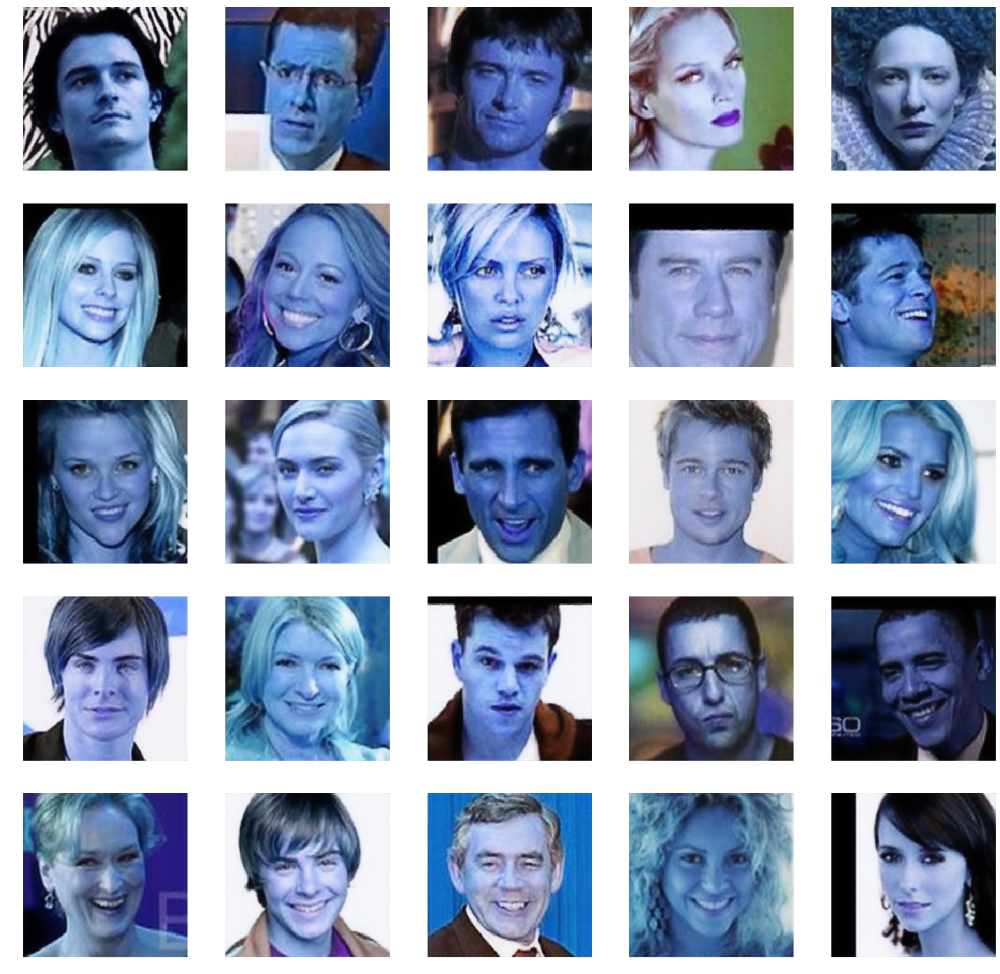

 40%|████      | 2002/5000 [25:01<1:34:14,  1.89s/it]

[0.0024661862, 0.0]


 40%|████      | 2003/5000 [25:01<1:16:43,  1.54s/it]

[0.0018528168, 0.0]


 40%|████      | 2004/5000 [25:02<1:04:32,  1.29s/it]

[0.0018828046, 0.0]


 40%|████      | 2005/5000 [25:03<55:45,  1.12s/it]  

[0.0019080975, 0.0]


 40%|████      | 2006/5000 [25:04<49:44,  1.00it/s]

[0.0016466718, 0.0]


 40%|████      | 2007/5000 [25:04<45:20,  1.10it/s]

[0.0028966567, 0.0]


 40%|████      | 2008/5000 [25:05<42:24,  1.18it/s]

[0.0025443265, 0.0]


 40%|████      | 2009/5000 [25:06<40:12,  1.24it/s]

[0.0024900706, 0.0]


 40%|████      | 2010/5000 [25:06<38:49,  1.28it/s]

[0.0018705009, 0.0]


 40%|████      | 2011/5000 [25:07<37:41,  1.32it/s]

[0.0026887285, 0.0]


 40%|████      | 2012/5000 [25:08<37:03,  1.34it/s]

[0.0039501977, 0.0]


 40%|████      | 2013/5000 [25:08<36:23,  1.37it/s]

[0.0030311125, 0.0]


 40%|████      | 2014/5000 [25:09<36:07,  1.38it/s]

[0.002937294, 0.0]


 40%|████      | 2015/5000 [25:10<35:47,  1.39it/s]

[0.0018184489, 0.0]


 40%|████      | 2016/5000 [25:11<35:42,  1.39it/s]

[0.0019166555, 0.0]


 40%|████      | 2017/5000 [25:11<35:31,  1.40it/s]

[0.0018374578, 0.0]


 40%|████      | 2018/5000 [25:12<35:36,  1.40it/s]

[0.001835154, 0.0]


 40%|████      | 2019/5000 [25:13<35:26,  1.40it/s]

[0.0036513014, 0.0]


 40%|████      | 2020/5000 [25:13<35:29,  1.40it/s]

[0.0034554931, 0.0]


 40%|████      | 2021/5000 [25:14<35:22,  1.40it/s]

[0.0018572973, 0.0]


 40%|████      | 2022/5000 [25:15<35:21,  1.40it/s]

[0.0033056992, 0.0]


 40%|████      | 2023/5000 [25:16<35:12,  1.41it/s]

[0.0031079687, 0.0]


 40%|████      | 2024/5000 [25:16<35:16,  1.41it/s]

[0.0021777344, 0.0]


 40%|████      | 2025/5000 [25:17<35:10,  1.41it/s]

[0.002366523, 0.0]


 41%|████      | 2026/5000 [25:18<35:13,  1.41it/s]

[0.0041803983, 0.0]


 41%|████      | 2027/5000 [25:18<35:06,  1.41it/s]

[0.0019860144, 0.0]


 41%|████      | 2028/5000 [25:19<35:12,  1.41it/s]

[0.0015130277, 0.0]


 41%|████      | 2029/5000 [25:20<35:01,  1.41it/s]

[0.0017617679, 0.0]


 41%|████      | 2030/5000 [25:21<35:06,  1.41it/s]

[0.0015139822, 0.0]


 41%|████      | 2031/5000 [25:21<35:02,  1.41it/s]

[0.0022197969, 0.0]


 41%|████      | 2032/5000 [25:22<35:10,  1.41it/s]

[0.0021224953, 0.0]


 41%|████      | 2033/5000 [25:23<35:02,  1.41it/s]

[0.0016629708, 0.0]


 41%|████      | 2034/5000 [25:23<35:12,  1.40it/s]

[0.0023516926, 0.0]


 41%|████      | 2035/5000 [25:24<35:08,  1.41it/s]

[0.004947728, 0.0]


 41%|████      | 2036/5000 [25:25<35:10,  1.40it/s]

[0.0028314064, 0.0]


 41%|████      | 2037/5000 [25:26<35:03,  1.41it/s]

[0.0022640508, 0.0]


 41%|████      | 2038/5000 [25:26<35:10,  1.40it/s]

[0.0029408096, 0.0]


 41%|████      | 2039/5000 [25:27<35:02,  1.41it/s]

[0.0023980932, 0.0]


 41%|████      | 2040/5000 [25:28<35:06,  1.41it/s]

[0.002484221, 0.0]


 41%|████      | 2041/5000 [25:28<34:58,  1.41it/s]

[0.0029021078, 0.0]


 41%|████      | 2042/5000 [25:29<35:02,  1.41it/s]

[0.002684339, 0.0]


 41%|████      | 2043/5000 [25:30<34:54,  1.41it/s]

[0.0021886702, 0.0]


 41%|████      | 2044/5000 [25:30<34:58,  1.41it/s]

[0.002804919, 0.0]


 41%|████      | 2045/5000 [25:31<34:52,  1.41it/s]

[0.009775354, 0.0]


 41%|████      | 2046/5000 [25:32<34:56,  1.41it/s]

[0.0043312116, 0.0]


 41%|████      | 2047/5000 [25:33<34:53,  1.41it/s]

[0.0030701058, 0.0]


 41%|████      | 2048/5000 [25:33<34:57,  1.41it/s]

[0.001481344, 0.0]


 41%|████      | 2049/5000 [25:34<34:52,  1.41it/s]

[0.0034896387, 0.0]


 41%|████      | 2050/5000 [25:35<35:02,  1.40it/s]

[0.004550363, 0.0]


 41%|████      | 2051/5000 [25:35<34:57,  1.41it/s]

[0.0021205177, 0.0]
2050 [G loss: 0.002121, G acc.: 0.00%]


 41%|████      | 2052/5000 [25:36<35:01,  1.40it/s]

[0.0073100803, 0.0]


 41%|████      | 2053/5000 [25:37<34:55,  1.41it/s]

[0.0021796143, 0.0]


 41%|████      | 2054/5000 [25:38<34:57,  1.40it/s]

[0.0066872593, 0.0]


 41%|████      | 2055/5000 [25:38<34:48,  1.41it/s]

[0.0023225734, 0.0]


 41%|████      | 2056/5000 [25:39<34:52,  1.41it/s]

[0.0020510966, 0.0]


 41%|████      | 2057/5000 [25:40<34:54,  1.41it/s]

[0.0016135687, 0.0]


 41%|████      | 2058/5000 [25:40<34:56,  1.40it/s]

[0.0025387234, 0.0]


 41%|████      | 2059/5000 [25:41<34:52,  1.41it/s]

[0.0031058593, 0.0]


 41%|████      | 2060/5000 [25:42<34:54,  1.40it/s]

[0.0017090584, 0.0]


 41%|████      | 2061/5000 [25:43<34:48,  1.41it/s]

[0.003641064, 0.0]


 41%|████      | 2062/5000 [25:43<34:50,  1.41it/s]

[0.0035232864, 0.0]


 41%|████▏     | 2063/5000 [25:44<34:42,  1.41it/s]

[0.0019199416, 0.0]


 41%|████▏     | 2064/5000 [25:45<34:47,  1.41it/s]

[0.0025147172, 0.0]


 41%|████▏     | 2065/5000 [25:45<34:50,  1.40it/s]

[0.0015216256, 0.0]


 41%|████▏     | 2066/5000 [25:46<34:50,  1.40it/s]

[0.0021743113, 0.0]


 41%|████▏     | 2067/5000 [25:47<34:42,  1.41it/s]

[0.0014479698, 0.0]


 41%|████▏     | 2068/5000 [25:48<34:43,  1.41it/s]

[0.001566486, 0.0]


 41%|████▏     | 2069/5000 [25:48<34:44,  1.41it/s]

[0.0026729074, 0.0]


 41%|████▏     | 2070/5000 [25:49<34:48,  1.40it/s]

[0.0024702933, 0.0]


 41%|████▏     | 2071/5000 [25:50<34:42,  1.41it/s]

[0.0015484361, 0.0]


 41%|████▏     | 2072/5000 [25:50<34:45,  1.40it/s]

[0.0014175491, 0.0]


 41%|████▏     | 2073/5000 [25:51<34:39,  1.41it/s]

[0.0015977466, 0.0]


 41%|████▏     | 2074/5000 [25:52<34:42,  1.40it/s]

[0.002035674, 0.0]


 42%|████▏     | 2075/5000 [25:53<34:44,  1.40it/s]

[0.0018167561, 0.0]


 42%|████▏     | 2076/5000 [25:53<34:51,  1.40it/s]

[0.0021580595, 0.0]


 42%|████▏     | 2077/5000 [25:54<34:38,  1.41it/s]

[0.0019249085, 0.0]


 42%|████▏     | 2078/5000 [25:55<34:40,  1.40it/s]

[0.002666382, 0.0]


 42%|████▏     | 2079/5000 [25:55<34:31,  1.41it/s]

[0.0035018832, 0.0]


 42%|████▏     | 2080/5000 [25:56<34:35,  1.41it/s]

[0.0024607843, 0.0]


 42%|████▏     | 2081/5000 [25:57<34:26,  1.41it/s]

[0.0018599605, 0.0]


 42%|████▏     | 2082/5000 [25:58<34:30,  1.41it/s]

[0.004849055, 0.0]


 42%|████▏     | 2083/5000 [25:58<34:23,  1.41it/s]

[0.0028811225, 0.0]


 42%|████▏     | 2084/5000 [25:59<34:34,  1.41it/s]

[0.0018916184, 0.0]


 42%|████▏     | 2085/5000 [26:00<34:36,  1.40it/s]

[0.0023971298, 0.0]


 42%|████▏     | 2086/5000 [26:00<34:43,  1.40it/s]

[0.004948835, 0.0]


 42%|████▏     | 2087/5000 [26:01<34:32,  1.41it/s]

[0.0016644276, 0.0]


 42%|████▏     | 2088/5000 [26:02<34:37,  1.40it/s]

[0.0020561367, 0.0]


 42%|████▏     | 2089/5000 [26:02<34:31,  1.41it/s]

[0.001782362, 0.0]


 42%|████▏     | 2090/5000 [26:03<34:39,  1.40it/s]

[0.0024922309, 0.0]


 42%|████▏     | 2091/5000 [26:04<34:28,  1.41it/s]

[0.0056831026, 0.0]


 42%|████▏     | 2092/5000 [26:05<34:29,  1.41it/s]

[0.0031649012, 0.0]


 42%|████▏     | 2093/5000 [26:05<34:31,  1.40it/s]

[0.0033883878, 0.0]


 42%|████▏     | 2094/5000 [26:06<34:34,  1.40it/s]

[0.0027423683, 0.0]


 42%|████▏     | 2095/5000 [26:07<34:26,  1.41it/s]

[0.001824528, 0.0]


 42%|████▏     | 2096/5000 [26:07<34:32,  1.40it/s]

[0.0017179011, 0.0]


 42%|████▏     | 2097/5000 [26:08<34:24,  1.41it/s]

[0.0020025778, 0.0]


 42%|████▏     | 2098/5000 [26:09<34:25,  1.40it/s]

[0.004892695, 0.0]


 42%|████▏     | 2099/5000 [26:10<34:18,  1.41it/s]

[0.0049382546, 0.0]


 42%|████▏     | 2100/5000 [26:10<34:20,  1.41it/s]

[0.004325563, 0.0]


 42%|████▏     | 2101/5000 [26:11<34:09,  1.41it/s]

[0.002045335, 0.0]
2100 [G loss: 0.002045, G acc.: 0.00%]


 42%|████▏     | 2102/5000 [26:12<34:15,  1.41it/s]

[0.0020087739, 0.0]


 42%|████▏     | 2103/5000 [26:12<34:04,  1.42it/s]

[0.002388042, 0.0]


 42%|████▏     | 2104/5000 [26:13<34:17,  1.41it/s]

[0.0019013564, 0.0]


 42%|████▏     | 2105/5000 [26:14<34:10,  1.41it/s]

[0.0022161084, 0.0]


 42%|████▏     | 2106/5000 [26:15<34:12,  1.41it/s]

[0.002343904, 0.0]


 42%|████▏     | 2107/5000 [26:15<34:03,  1.42it/s]

[0.0022904924, 0.0]


 42%|████▏     | 2108/5000 [26:16<34:14,  1.41it/s]

[0.00642223, 0.0]


 42%|████▏     | 2109/5000 [26:17<34:06,  1.41it/s]

[0.0025905017, 0.0]


 42%|████▏     | 2110/5000 [26:17<34:12,  1.41it/s]

[0.0035962113, 0.0]


 42%|████▏     | 2111/5000 [26:18<34:04,  1.41it/s]

[0.011881638, 0.0]


 42%|████▏     | 2112/5000 [26:19<34:11,  1.41it/s]

[0.0042104563, 0.0]


 42%|████▏     | 2113/5000 [26:20<34:06,  1.41it/s]

[0.0023835702, 0.0]


 42%|████▏     | 2114/5000 [26:20<34:17,  1.40it/s]

[0.0020203444, 0.0]


 42%|████▏     | 2115/5000 [26:21<34:12,  1.41it/s]

[0.0036834558, 0.0]


 42%|████▏     | 2116/5000 [26:22<34:14,  1.40it/s]

[0.0025275412, 0.0]


 42%|████▏     | 2117/5000 [26:22<34:04,  1.41it/s]

[0.002809138, 0.0]


 42%|████▏     | 2118/5000 [26:23<34:11,  1.40it/s]

[0.002812065, 0.0]


 42%|████▏     | 2119/5000 [26:24<34:01,  1.41it/s]

[0.0026549448, 0.0]


 42%|████▏     | 2120/5000 [26:25<34:07,  1.41it/s]

[0.0025046817, 0.0]


 42%|████▏     | 2121/5000 [26:25<34:01,  1.41it/s]

[0.003310071, 0.0]


 42%|████▏     | 2122/5000 [26:26<34:03,  1.41it/s]

[0.003432873, 0.0]


 42%|████▏     | 2123/5000 [26:27<33:55,  1.41it/s]

[0.0025590204, 0.0]


 42%|████▏     | 2124/5000 [26:27<33:58,  1.41it/s]

[0.0021121693, 0.0]


 42%|████▎     | 2125/5000 [26:28<33:54,  1.41it/s]

[0.0027923873, 0.0]


 43%|████▎     | 2126/5000 [26:29<34:03,  1.41it/s]

[0.0022585392, 0.0]


 43%|████▎     | 2127/5000 [26:29<33:59,  1.41it/s]

[0.0019378536, 0.0]


 43%|████▎     | 2128/5000 [26:30<34:05,  1.40it/s]

[0.0018739962, 0.0]


 43%|████▎     | 2129/5000 [26:31<33:58,  1.41it/s]

[0.0023053868, 0.0]


 43%|████▎     | 2130/5000 [26:32<33:59,  1.41it/s]

[0.004537416, 0.0]


 43%|████▎     | 2131/5000 [26:32<33:56,  1.41it/s]

[0.0036635555, 0.0]


 43%|████▎     | 2132/5000 [26:33<33:58,  1.41it/s]

[0.0016915178, 0.0]


 43%|████▎     | 2133/5000 [26:34<33:53,  1.41it/s]

[0.0016151541, 0.0]


 43%|████▎     | 2134/5000 [26:34<33:56,  1.41it/s]

[0.0022622976, 0.0]


 43%|████▎     | 2135/5000 [26:35<33:50,  1.41it/s]

[0.003438091, 0.0]


 43%|████▎     | 2136/5000 [26:36<33:53,  1.41it/s]

[0.002975486, 0.0]


 43%|████▎     | 2137/5000 [26:37<33:45,  1.41it/s]

[0.0034715666, 0.0]


 43%|████▎     | 2138/5000 [26:37<33:53,  1.41it/s]

[0.0018097479, 0.0]


 43%|████▎     | 2139/5000 [26:38<33:45,  1.41it/s]

[0.0014676661, 0.0]


 43%|████▎     | 2140/5000 [26:39<33:51,  1.41it/s]

[0.001492035, 0.0]


 43%|████▎     | 2141/5000 [26:39<33:50,  1.41it/s]

[0.0029372368, 0.0]


 43%|████▎     | 2142/5000 [26:40<33:55,  1.40it/s]

[0.002768939, 0.0]


 43%|████▎     | 2143/5000 [26:41<33:48,  1.41it/s]

[0.002075724, 0.0]


 43%|████▎     | 2144/5000 [26:42<33:51,  1.41it/s]

[0.0018337902, 0.0]


 43%|████▎     | 2145/5000 [26:42<33:49,  1.41it/s]

[0.002845297, 0.0]


 43%|████▎     | 2146/5000 [26:43<33:51,  1.40it/s]

[0.0034121987, 0.0]


 43%|████▎     | 2147/5000 [26:44<33:44,  1.41it/s]

[0.0018832579, 0.0]


 43%|████▎     | 2148/5000 [26:44<33:54,  1.40it/s]

[0.005241619, 0.0]


 43%|████▎     | 2149/5000 [26:45<33:49,  1.40it/s]

[0.0038560499, 0.0]


 43%|████▎     | 2150/5000 [26:46<33:51,  1.40it/s]

[0.0016876035, 0.0]


 43%|████▎     | 2151/5000 [26:47<33:50,  1.40it/s]

[0.0016418421, 0.0]
2150 [G loss: 0.001642, G acc.: 0.00%]


 43%|████▎     | 2152/5000 [26:47<33:54,  1.40it/s]

[0.0015949121, 0.0]


 43%|████▎     | 2153/5000 [26:48<33:51,  1.40it/s]

[0.0036242323, 0.0]


 43%|████▎     | 2154/5000 [26:49<33:51,  1.40it/s]

[0.0033747226, 0.0]


 43%|████▎     | 2155/5000 [26:49<33:45,  1.40it/s]

[0.001634634, 0.0]


 43%|████▎     | 2156/5000 [26:50<33:47,  1.40it/s]

[0.0030799962, 0.0]


 43%|████▎     | 2157/5000 [26:51<33:39,  1.41it/s]

[0.0016240303, 0.0]


 43%|████▎     | 2158/5000 [26:52<33:42,  1.41it/s]

[0.0033677074, 0.0]


 43%|████▎     | 2159/5000 [26:52<33:37,  1.41it/s]

[0.0039803768, 0.0]


 43%|████▎     | 2160/5000 [26:53<33:40,  1.41it/s]

[0.0019561243, 0.0]


 43%|████▎     | 2161/5000 [26:54<33:34,  1.41it/s]

[0.0026939448, 0.0]


 43%|████▎     | 2162/5000 [26:54<33:35,  1.41it/s]

[0.0018890962, 0.0]


 43%|████▎     | 2163/5000 [26:55<33:30,  1.41it/s]

[0.0017297943, 0.0]


 43%|████▎     | 2164/5000 [26:56<33:32,  1.41it/s]

[0.0037865771, 0.0]


 43%|████▎     | 2165/5000 [26:56<33:26,  1.41it/s]

[0.0024491525, 0.0]


 43%|████▎     | 2166/5000 [26:57<33:33,  1.41it/s]

[0.0020192945, 0.0]


 43%|████▎     | 2167/5000 [26:58<33:25,  1.41it/s]

[0.0017888056, 0.0]


 43%|████▎     | 2168/5000 [26:59<33:34,  1.41it/s]

[0.0017965202, 0.0]


 43%|████▎     | 2169/5000 [26:59<33:27,  1.41it/s]

[0.0013894687, 0.0]


 43%|████▎     | 2170/5000 [27:00<33:36,  1.40it/s]

[0.0022890682, 0.0]


 43%|████▎     | 2171/5000 [27:01<33:30,  1.41it/s]

[0.0038220298, 0.0]


 43%|████▎     | 2172/5000 [27:01<33:33,  1.40it/s]

[0.0023992336, 0.0]


 43%|████▎     | 2173/5000 [27:02<33:27,  1.41it/s]

[0.002396173, 0.0]


 43%|████▎     | 2174/5000 [27:03<33:29,  1.41it/s]

[0.0024253973, 0.0]


 44%|████▎     | 2175/5000 [27:04<33:24,  1.41it/s]

[0.0030209215, 0.0]


 44%|████▎     | 2176/5000 [27:04<33:26,  1.41it/s]

[0.0018147109, 0.0]


 44%|████▎     | 2177/5000 [27:05<33:20,  1.41it/s]

[0.002327716, 0.0]


 44%|████▎     | 2178/5000 [27:06<33:24,  1.41it/s]

[0.0021377143, 0.0]


 44%|████▎     | 2179/5000 [27:06<33:19,  1.41it/s]

[0.0033661386, 0.0]


 44%|████▎     | 2180/5000 [27:07<33:26,  1.41it/s]

[0.00199659, 0.0]


 44%|████▎     | 2181/5000 [27:08<33:22,  1.41it/s]

[0.004622774, 0.0]


 44%|████▎     | 2182/5000 [27:09<33:24,  1.41it/s]

[0.0015751978, 0.0]


 44%|████▎     | 2183/5000 [27:09<33:19,  1.41it/s]

[0.0021976049, 0.0]


 44%|████▎     | 2184/5000 [27:10<33:24,  1.40it/s]

[0.0014374153, 0.0]


 44%|████▎     | 2185/5000 [27:11<33:17,  1.41it/s]

[0.004899605, 0.0]


 44%|████▎     | 2186/5000 [27:11<33:25,  1.40it/s]

[0.0016744495, 0.0]


 44%|████▎     | 2187/5000 [27:12<33:13,  1.41it/s]

[0.0070249, 0.0]


 44%|████▍     | 2188/5000 [27:13<33:19,  1.41it/s]

[0.0037387433, 0.0]


 44%|████▍     | 2189/5000 [27:14<33:12,  1.41it/s]

[0.0018493548, 0.0]


 44%|████▍     | 2190/5000 [27:14<33:17,  1.41it/s]

[0.006689812, 0.0]


 44%|████▍     | 2191/5000 [27:15<33:13,  1.41it/s]

[0.0014437843, 0.0]


 44%|████▍     | 2192/5000 [27:16<33:17,  1.41it/s]

[0.0027575088, 0.0]


 44%|████▍     | 2193/5000 [27:16<33:12,  1.41it/s]

[0.0023160495, 0.0]


 44%|████▍     | 2194/5000 [27:17<33:12,  1.41it/s]

[0.0021078014, 0.0]


 44%|████▍     | 2195/5000 [27:18<33:05,  1.41it/s]

[0.0023795033, 0.0]


 44%|████▍     | 2196/5000 [27:19<33:12,  1.41it/s]

[0.0017695338, 0.0]


 44%|████▍     | 2197/5000 [27:19<33:08,  1.41it/s]

[0.002279054, 0.0]


 44%|████▍     | 2198/5000 [27:20<33:13,  1.41it/s]

[0.003094338, 0.0]


 44%|████▍     | 2199/5000 [27:21<33:07,  1.41it/s]

[0.0022356752, 0.0]


 44%|████▍     | 2200/5000 [27:21<33:16,  1.40it/s]

[0.0024323703, 0.0]
[0.002010928, 0.0]
2200 [G loss: 0.002011, G acc.: 0.00%]


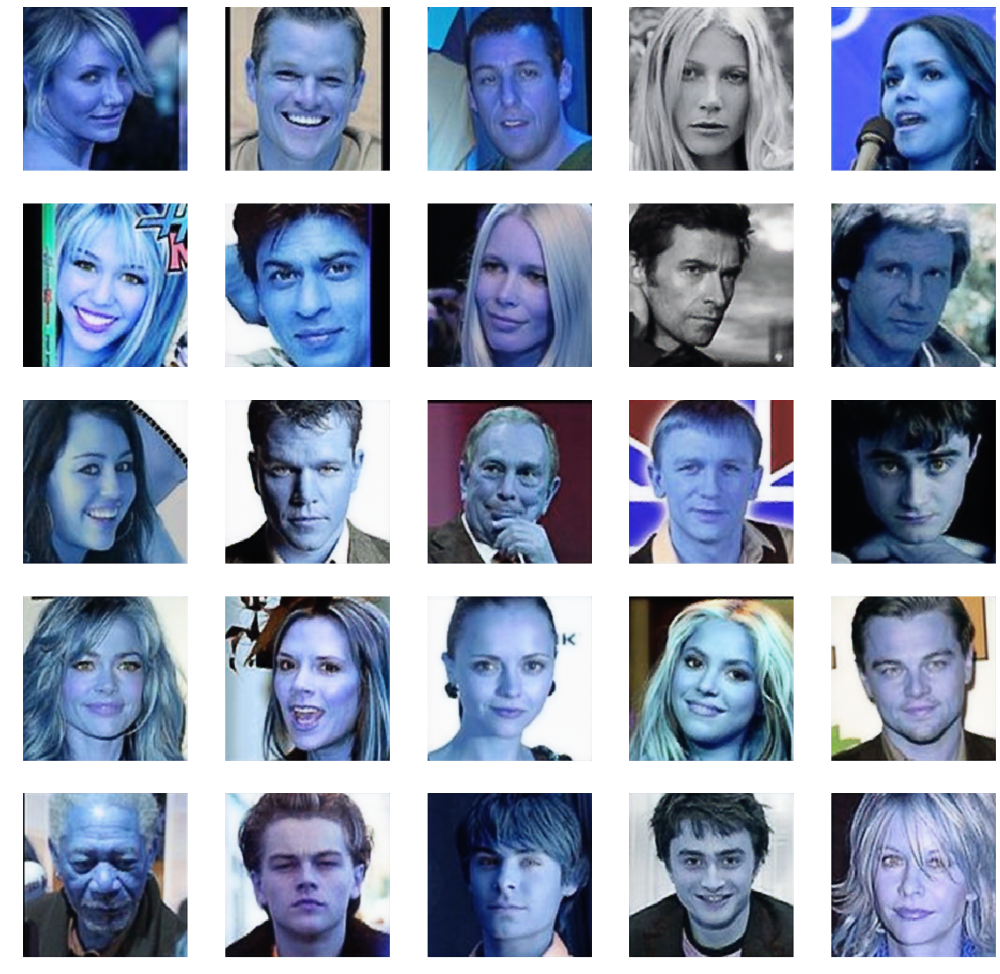

 44%|████▍     | 2202/5000 [27:28<1:23:07,  1.78s/it]

[0.0023726616, 0.0]


 44%|████▍     | 2203/5000 [27:29<1:08:12,  1.46s/it]

[0.001758182, 0.0]


 44%|████▍     | 2204/5000 [27:29<57:33,  1.24s/it]  

[0.0016695092, 0.0]


 44%|████▍     | 2205/5000 [27:30<50:17,  1.08s/it]

[0.0030075482, 0.0]


 44%|████▍     | 2206/5000 [27:31<45:00,  1.03it/s]

[0.0017931163, 0.0]


 44%|████▍     | 2207/5000 [27:31<41:30,  1.12it/s]

[0.002356381, 0.0]


 44%|████▍     | 2208/5000 [27:32<38:51,  1.20it/s]

[0.0045876876, 0.0]


 44%|████▍     | 2209/5000 [27:33<37:11,  1.25it/s]

[0.0018005111, 0.0]


 44%|████▍     | 2210/5000 [27:34<35:50,  1.30it/s]

[0.007854355, 0.0]


 44%|████▍     | 2211/5000 [27:34<35:05,  1.32it/s]

[0.0030611558, 0.0]


 44%|████▍     | 2212/5000 [27:35<34:20,  1.35it/s]

[0.0036274327, 0.0]


 44%|████▍     | 2213/5000 [27:36<34:01,  1.37it/s]

[0.0038122036, 0.0]


 44%|████▍     | 2214/5000 [27:36<33:36,  1.38it/s]

[0.002900115, 0.0]


 44%|████▍     | 2215/5000 [27:37<33:26,  1.39it/s]

[0.0017627748, 0.0]


 44%|████▍     | 2216/5000 [27:38<33:10,  1.40it/s]

[0.003952203, 0.0]


 44%|████▍     | 2217/5000 [27:39<33:10,  1.40it/s]

[0.0020684456, 0.0]


 44%|████▍     | 2218/5000 [27:39<32:57,  1.41it/s]

[0.0039984346, 0.0]


 44%|████▍     | 2219/5000 [27:40<33:01,  1.40it/s]

[0.0042085554, 0.0]


 44%|████▍     | 2220/5000 [27:41<32:52,  1.41it/s]

[0.004651173, 0.0]


 44%|████▍     | 2221/5000 [27:41<32:55,  1.41it/s]

[0.0017226543, 0.0]


 44%|████▍     | 2222/5000 [27:42<32:48,  1.41it/s]

[0.0024006125, 0.0]


 44%|████▍     | 2223/5000 [27:43<32:52,  1.41it/s]

[0.0022293641, 0.0]


 44%|████▍     | 2224/5000 [27:43<32:43,  1.41it/s]

[0.0021914882, 0.0]


 44%|████▍     | 2225/5000 [27:44<32:52,  1.41it/s]

[0.0020140933, 0.0]


 45%|████▍     | 2226/5000 [27:45<32:45,  1.41it/s]

[0.0018447376, 0.0]


 45%|████▍     | 2227/5000 [27:46<32:53,  1.41it/s]

[0.0030396935, 0.0]


 45%|████▍     | 2228/5000 [27:46<32:50,  1.41it/s]

[0.0019520149, 0.0]


 45%|████▍     | 2229/5000 [27:47<32:52,  1.41it/s]

[0.0017546768, 0.0]


 45%|████▍     | 2230/5000 [27:48<32:44,  1.41it/s]

[0.001612344, 0.0]


 45%|████▍     | 2231/5000 [27:48<32:55,  1.40it/s]

[0.0016404806, 0.0]


 45%|████▍     | 2232/5000 [27:49<32:49,  1.41it/s]

[0.0018645553, 0.0]


 45%|████▍     | 2233/5000 [27:50<32:52,  1.40it/s]

[0.0027337351, 0.0]


 45%|████▍     | 2234/5000 [27:51<32:44,  1.41it/s]

[0.0029904859, 0.0]


 45%|████▍     | 2235/5000 [27:51<32:47,  1.41it/s]

[0.0024668889, 0.0]


 45%|████▍     | 2236/5000 [27:52<32:40,  1.41it/s]

[0.0017287866, 0.0]


 45%|████▍     | 2237/5000 [27:53<32:43,  1.41it/s]

[0.0021208106, 0.0]


 45%|████▍     | 2238/5000 [27:53<32:36,  1.41it/s]

[0.0026398608, 0.0]


 45%|████▍     | 2239/5000 [27:54<32:43,  1.41it/s]

[0.0017082042, 0.0]


 45%|████▍     | 2240/5000 [27:55<32:36,  1.41it/s]

[0.002094888, 0.0]


 45%|████▍     | 2241/5000 [27:56<32:42,  1.41it/s]

[0.0018179432, 0.0]


 45%|████▍     | 2242/5000 [27:56<32:37,  1.41it/s]

[0.0036560623, 0.0]


 45%|████▍     | 2243/5000 [27:57<32:42,  1.40it/s]

[0.0014457882, 0.0]


 45%|████▍     | 2244/5000 [27:58<32:37,  1.41it/s]

[0.0024689378, 0.0]


 45%|████▍     | 2245/5000 [27:58<32:43,  1.40it/s]

[0.0046313507, 0.0]


 45%|████▍     | 2246/5000 [27:59<32:35,  1.41it/s]

[0.0023568913, 0.0]


 45%|████▍     | 2247/5000 [28:00<32:40,  1.40it/s]

[0.0017734796, 0.0]


 45%|████▍     | 2248/5000 [28:01<32:31,  1.41it/s]

[0.0032568811, 0.0]


 45%|████▍     | 2249/5000 [28:01<32:37,  1.41it/s]

[0.0026499715, 0.0]


 45%|████▌     | 2250/5000 [28:02<32:29,  1.41it/s]

[0.0021556285, 0.0]


 45%|████▌     | 2251/5000 [28:03<32:34,  1.41it/s]

[0.0013916754, 0.0]
2250 [G loss: 0.001392, G acc.: 0.00%]


 45%|████▌     | 2252/5000 [28:03<32:29,  1.41it/s]

[0.0017810507, 0.0]


 45%|████▌     | 2253/5000 [28:04<32:35,  1.40it/s]

[0.0021757982, 0.0]


 45%|████▌     | 2254/5000 [28:05<32:25,  1.41it/s]

[0.0022441929, 0.0]


 45%|████▌     | 2255/5000 [28:06<32:31,  1.41it/s]

[0.0036618668, 0.0]


 45%|████▌     | 2256/5000 [28:06<32:28,  1.41it/s]

[0.0028006968, 0.0]


 45%|████▌     | 2257/5000 [28:07<32:33,  1.40it/s]

[0.004139923, 0.0]


 45%|████▌     | 2258/5000 [28:08<32:25,  1.41it/s]

[0.0022535715, 0.0]


 45%|████▌     | 2259/5000 [28:08<32:34,  1.40it/s]

[0.0032940719, 0.0]


 45%|████▌     | 2260/5000 [28:09<32:26,  1.41it/s]

[0.0020052753, 0.0]


 45%|████▌     | 2261/5000 [28:10<32:31,  1.40it/s]

[0.0018911521, 0.0]


 45%|████▌     | 2262/5000 [28:10<32:25,  1.41it/s]

[0.0018882202, 0.0]


 45%|████▌     | 2263/5000 [28:11<32:33,  1.40it/s]

[0.0021744487, 0.0]


 45%|████▌     | 2264/5000 [28:12<32:23,  1.41it/s]

[0.0017320325, 0.0]


 45%|████▌     | 2265/5000 [28:13<32:30,  1.40it/s]

[0.0031907388, 0.0]


 45%|████▌     | 2266/5000 [28:13<32:22,  1.41it/s]

[0.0019203158, 0.0]


 45%|████▌     | 2267/5000 [28:14<32:26,  1.40it/s]

[0.004940733, 0.0]


 45%|████▌     | 2268/5000 [28:15<32:29,  1.40it/s]

[0.0016840219, 0.0]


 45%|████▌     | 2269/5000 [28:15<32:30,  1.40it/s]

[0.0016791758, 0.0]


 45%|████▌     | 2270/5000 [28:16<32:19,  1.41it/s]

[0.0030742737, 0.0]


 45%|████▌     | 2271/5000 [28:17<32:23,  1.40it/s]

[0.0018065139, 0.0]


 45%|████▌     | 2272/5000 [28:18<32:16,  1.41it/s]

[0.0018388693, 0.0]


 45%|████▌     | 2273/5000 [28:18<32:22,  1.40it/s]

[0.0030676585, 0.0]


 45%|████▌     | 2274/5000 [28:19<32:15,  1.41it/s]

[0.0020289663, 0.0]


 46%|████▌     | 2275/5000 [28:20<32:18,  1.41it/s]

[0.0030942748, 0.0]


 46%|████▌     | 2276/5000 [28:20<32:15,  1.41it/s]

[0.004457483, 0.0]


 46%|████▌     | 2277/5000 [28:21<32:19,  1.40it/s]

[0.0033834781, 0.0]


 46%|████▌     | 2278/5000 [28:22<32:15,  1.41it/s]

[0.0046185656, 0.0]


 46%|████▌     | 2279/5000 [28:23<32:22,  1.40it/s]

[0.0017883322, 0.0]


 46%|████▌     | 2280/5000 [28:23<32:14,  1.41it/s]

[0.0022557187, 0.0]


 46%|████▌     | 2281/5000 [28:24<32:18,  1.40it/s]

[0.0018089715, 0.0]


 46%|████▌     | 2282/5000 [28:25<32:08,  1.41it/s]

[0.0017895232, 0.0]


 46%|████▌     | 2283/5000 [28:25<32:11,  1.41it/s]

[0.0018938007, 0.0]


 46%|████▌     | 2284/5000 [28:26<32:04,  1.41it/s]

[0.0021855666, 0.0]


 46%|████▌     | 2285/5000 [28:27<32:10,  1.41it/s]

[0.0015404224, 0.0]


 46%|████▌     | 2286/5000 [28:28<32:04,  1.41it/s]

[0.0027253786, 0.0]


 46%|████▌     | 2287/5000 [28:28<32:08,  1.41it/s]

[0.0017507537, 0.0]


 46%|████▌     | 2288/5000 [28:29<32:02,  1.41it/s]

[0.002251326, 0.0]


 46%|████▌     | 2289/5000 [28:30<32:07,  1.41it/s]

[0.0032159272, 0.0]


 46%|████▌     | 2290/5000 [28:30<32:02,  1.41it/s]

[0.001895464, 0.0]


 46%|████▌     | 2291/5000 [28:31<32:08,  1.40it/s]

[0.0014595886, 0.0]


 46%|████▌     | 2292/5000 [28:32<32:02,  1.41it/s]

[0.0018769673, 0.0]


 46%|████▌     | 2293/5000 [28:33<32:07,  1.40it/s]

[0.0015123091, 0.0]


 46%|████▌     | 2294/5000 [28:33<32:02,  1.41it/s]

[0.0059887692, 0.0]


 46%|████▌     | 2295/5000 [28:34<32:04,  1.41it/s]

[0.006388954, 0.0]


 46%|████▌     | 2296/5000 [28:35<31:59,  1.41it/s]

[0.0026400895, 0.0]


 46%|████▌     | 2297/5000 [28:35<32:05,  1.40it/s]

[0.0020421222, 0.0]


 46%|████▌     | 2298/5000 [28:36<31:59,  1.41it/s]

[0.0032610486, 0.0]


 46%|████▌     | 2299/5000 [28:37<32:00,  1.41it/s]

[0.0032569768, 0.0]


 46%|████▌     | 2300/5000 [28:38<31:55,  1.41it/s]

[0.0018766433, 0.0]


 46%|████▌     | 2301/5000 [28:38<32:01,  1.40it/s]

[0.0049553057, 0.0]
2300 [G loss: 0.004955, G acc.: 0.00%]


 46%|████▌     | 2302/5000 [28:39<31:57,  1.41it/s]

[0.006906978, 0.0]


 46%|████▌     | 2303/5000 [28:40<32:04,  1.40it/s]

[0.0031505558, 0.0]


 46%|████▌     | 2304/5000 [28:40<31:57,  1.41it/s]

[0.002860814, 0.0]


 46%|████▌     | 2305/5000 [28:41<32:03,  1.40it/s]

[0.0026111735, 0.0]


 46%|████▌     | 2306/5000 [28:42<31:52,  1.41it/s]

[0.0021012172, 0.0]


 46%|████▌     | 2307/5000 [28:43<31:56,  1.41it/s]

[0.0019643845, 0.0]


 46%|████▌     | 2308/5000 [28:43<31:46,  1.41it/s]

[0.0018337315, 0.0]


 46%|████▌     | 2309/5000 [28:44<31:51,  1.41it/s]

[0.010600646, 0.0]


 46%|████▌     | 2310/5000 [28:45<31:46,  1.41it/s]

[0.002573984, 0.0]


 46%|████▌     | 2311/5000 [28:45<31:55,  1.40it/s]

[0.0018164531, 0.0]


 46%|████▌     | 2312/5000 [28:46<31:45,  1.41it/s]

[0.0042758253, 0.0]


 46%|████▋     | 2313/5000 [28:47<31:53,  1.40it/s]

[0.002436156, 0.0]


 46%|████▋     | 2314/5000 [28:47<31:45,  1.41it/s]

[0.001954534, 0.0]


 46%|████▋     | 2315/5000 [28:48<31:56,  1.40it/s]

[0.0045055402, 0.0]


 46%|████▋     | 2316/5000 [28:49<31:46,  1.41it/s]

[0.0015516832, 0.0]


 46%|████▋     | 2317/5000 [28:50<31:51,  1.40it/s]

[0.0025871592, 0.0]


 46%|████▋     | 2318/5000 [28:50<31:42,  1.41it/s]

[0.0018829501, 0.0]


 46%|████▋     | 2319/5000 [28:51<31:49,  1.40it/s]

[0.0018738533, 0.0]


 46%|████▋     | 2320/5000 [28:52<31:42,  1.41it/s]

[0.0016961353, 0.0]


 46%|████▋     | 2321/5000 [28:52<31:45,  1.41it/s]

[0.0017657855, 0.0]


 46%|████▋     | 2322/5000 [28:53<31:43,  1.41it/s]

[0.0018861549, 0.0]


 46%|████▋     | 2323/5000 [28:54<31:47,  1.40it/s]

[0.001789024, 0.0]


 46%|████▋     | 2324/5000 [28:55<31:39,  1.41it/s]

[0.0018623148, 0.0]


 46%|████▋     | 2325/5000 [28:55<31:43,  1.41it/s]

[0.00231298, 0.0]


 47%|████▋     | 2326/5000 [28:56<31:37,  1.41it/s]

[0.0043773823, 0.0]


 47%|████▋     | 2327/5000 [28:57<31:40,  1.41it/s]

[0.0059039416, 0.0]


 47%|████▋     | 2328/5000 [28:57<31:33,  1.41it/s]

[0.002302183, 0.0]


 47%|████▋     | 2329/5000 [28:58<31:38,  1.41it/s]

[0.0019702832, 0.0]


 47%|████▋     | 2330/5000 [28:59<31:31,  1.41it/s]

[0.0076183258, 0.0]


 47%|████▋     | 2331/5000 [29:00<31:41,  1.40it/s]

[0.0014579874, 0.0]


 47%|████▋     | 2332/5000 [29:00<31:36,  1.41it/s]

[0.0018650193, 0.0]


 47%|████▋     | 2333/5000 [29:01<31:41,  1.40it/s]

[0.0014626837, 0.0]


 47%|████▋     | 2334/5000 [29:02<31:31,  1.41it/s]

[0.0017848084, 0.0]


 47%|████▋     | 2335/5000 [29:02<31:36,  1.41it/s]

[0.0015278589, 0.0]


 47%|████▋     | 2336/5000 [29:03<31:33,  1.41it/s]

[0.0017625063, 0.0]


 47%|████▋     | 2337/5000 [29:04<31:34,  1.41it/s]

[0.0039389147, 0.0]


 47%|████▋     | 2338/5000 [29:05<31:28,  1.41it/s]

[0.0022763861, 0.0]


 47%|████▋     | 2339/5000 [29:05<31:37,  1.40it/s]

[0.002317095, 0.0]


 47%|████▋     | 2340/5000 [29:06<31:28,  1.41it/s]

[0.0018194584, 0.0]


 47%|████▋     | 2341/5000 [29:07<31:35,  1.40it/s]

[0.0019168298, 0.0]


 47%|████▋     | 2342/5000 [29:07<31:29,  1.41it/s]

[0.001499489, 0.0]


 47%|████▋     | 2343/5000 [29:08<31:34,  1.40it/s]

[0.0066029914, 0.0]


 47%|████▋     | 2344/5000 [29:09<31:28,  1.41it/s]

[0.0027184708, 0.0]


 47%|████▋     | 2345/5000 [29:10<31:33,  1.40it/s]

[0.0015775565, 0.0]


 47%|████▋     | 2346/5000 [29:10<31:27,  1.41it/s]

[0.004308985, 0.0]


 47%|████▋     | 2347/5000 [29:11<31:31,  1.40it/s]

[0.0027448037, 0.0]


 47%|████▋     | 2348/5000 [29:12<31:23,  1.41it/s]

[0.0020368735, 0.0]


 47%|████▋     | 2349/5000 [29:12<31:28,  1.40it/s]

[0.0018582548, 0.0]


 47%|████▋     | 2350/5000 [29:13<31:23,  1.41it/s]

[0.0015554944, 0.0]


 47%|████▋     | 2351/5000 [29:14<31:27,  1.40it/s]

[0.010507164, 0.0]
2350 [G loss: 0.010507, G acc.: 0.00%]


 47%|████▋     | 2352/5000 [29:14<31:19,  1.41it/s]

[0.0019447317, 0.0]


 47%|████▋     | 2353/5000 [29:15<31:26,  1.40it/s]

[0.0016963517, 0.0]


 47%|████▋     | 2354/5000 [29:16<31:16,  1.41it/s]

[0.001822949, 0.0]


 47%|████▋     | 2355/5000 [29:17<31:25,  1.40it/s]

[0.0049187886, 0.0]


 47%|████▋     | 2356/5000 [29:17<31:20,  1.41it/s]

[0.0025918842, 0.0]


 47%|████▋     | 2357/5000 [29:18<31:28,  1.40it/s]

[0.0022885706, 0.0]


 47%|████▋     | 2358/5000 [29:19<31:16,  1.41it/s]

[0.0072247228, 0.0]


 47%|████▋     | 2359/5000 [29:19<31:24,  1.40it/s]

[0.004155209, 0.0]


 47%|████▋     | 2360/5000 [29:20<31:20,  1.40it/s]

[0.001615636, 0.0]


 47%|████▋     | 2361/5000 [29:21<31:24,  1.40it/s]

[0.002941544, 0.0]


 47%|████▋     | 2362/5000 [29:22<31:17,  1.41it/s]

[0.0020701736, 0.0]


 47%|████▋     | 2363/5000 [29:22<31:20,  1.40it/s]

[0.0022419791, 0.0]


 47%|████▋     | 2364/5000 [29:23<31:15,  1.41it/s]

[0.0021700922, 0.0]


 47%|████▋     | 2365/5000 [29:24<31:19,  1.40it/s]

[0.0052069826, 0.0]


 47%|████▋     | 2366/5000 [29:24<31:13,  1.41it/s]

[0.0014162293, 0.0]


 47%|████▋     | 2367/5000 [29:25<31:17,  1.40it/s]

[0.0017857081, 0.0]


 47%|████▋     | 2368/5000 [29:26<31:12,  1.41it/s]

[0.0018981386, 0.0]


 47%|████▋     | 2369/5000 [29:27<31:19,  1.40it/s]

[0.002468101, 0.0]


 47%|████▋     | 2370/5000 [29:27<31:10,  1.41it/s]

[0.0019912587, 0.0]


 47%|████▋     | 2371/5000 [29:28<31:20,  1.40it/s]

[0.0029446331, 0.0]


 47%|████▋     | 2372/5000 [29:29<31:11,  1.40it/s]

[0.0030335425, 0.0]


 47%|████▋     | 2373/5000 [29:29<31:17,  1.40it/s]

[0.0019554019, 0.0]


 47%|████▋     | 2374/5000 [29:30<31:09,  1.40it/s]

[0.0017082787, 0.0]


 48%|████▊     | 2375/5000 [29:31<31:13,  1.40it/s]

[0.006719501, 0.0]


 48%|████▊     | 2376/5000 [29:32<31:07,  1.41it/s]

[0.0016095898, 0.0]


 48%|████▊     | 2377/5000 [29:32<31:12,  1.40it/s]

[0.0032012167, 0.0]


 48%|████▊     | 2378/5000 [29:33<31:05,  1.41it/s]

[0.0019631872, 0.0]


 48%|████▊     | 2379/5000 [29:34<31:18,  1.40it/s]

[0.0026428956, 0.0]


 48%|████▊     | 2380/5000 [29:34<31:05,  1.40it/s]

[0.00384297, 0.0]


 48%|████▊     | 2381/5000 [29:35<31:12,  1.40it/s]

[0.0019902003, 0.0]


 48%|████▊     | 2382/5000 [29:36<31:01,  1.41it/s]

[0.002548432, 0.0]


 48%|████▊     | 2383/5000 [29:37<31:06,  1.40it/s]

[0.0015568327, 0.0]


 48%|████▊     | 2384/5000 [29:37<30:59,  1.41it/s]

[0.0015898809, 0.0]


 48%|████▊     | 2385/5000 [29:38<31:03,  1.40it/s]

[0.00222269, 0.0]


 48%|████▊     | 2386/5000 [29:39<30:57,  1.41it/s]

[0.0019716849, 0.0]


 48%|████▊     | 2387/5000 [29:39<31:01,  1.40it/s]

[0.0031706374, 0.0]


 48%|████▊     | 2388/5000 [29:40<30:54,  1.41it/s]

[0.0021199442, 0.0]


 48%|████▊     | 2389/5000 [29:41<30:56,  1.41it/s]

[0.0017675001, 0.0]


 48%|████▊     | 2390/5000 [29:42<30:52,  1.41it/s]

[0.0016830812, 0.0]


 48%|████▊     | 2391/5000 [29:42<31:02,  1.40it/s]

[0.0019666734, 0.0]


 48%|████▊     | 2392/5000 [29:43<30:53,  1.41it/s]

[0.0015491471, 0.0]


 48%|████▊     | 2393/5000 [29:44<30:57,  1.40it/s]

[0.0028562685, 0.0]


 48%|████▊     | 2394/5000 [29:44<30:49,  1.41it/s]

[0.0017428636, 0.0]


 48%|████▊     | 2395/5000 [29:45<30:55,  1.40it/s]

[0.003334416, 0.0]


 48%|████▊     | 2396/5000 [29:46<30:49,  1.41it/s]

[0.0019113248, 0.0]


 48%|████▊     | 2397/5000 [29:47<30:57,  1.40it/s]

[0.001651172, 0.0]


 48%|████▊     | 2398/5000 [29:47<30:49,  1.41it/s]

[0.0032767744, 0.0]


 48%|████▊     | 2399/5000 [29:48<30:52,  1.40it/s]

[0.002336686, 0.0]


 48%|████▊     | 2400/5000 [29:49<30:44,  1.41it/s]

[0.0043102875, 0.0]
[0.0026468874, 0.0]
2400 [G loss: 0.002647, G acc.: 0.00%]


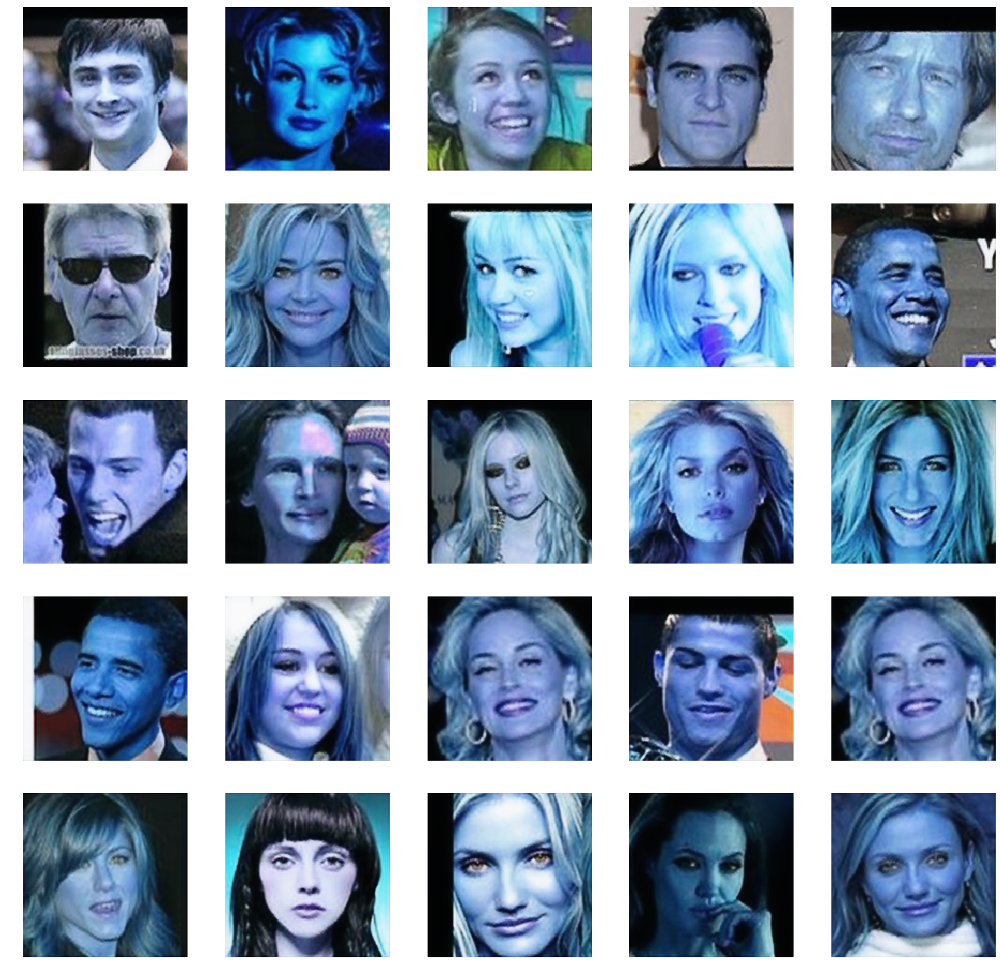

 48%|████▊     | 2402/5000 [29:55<1:18:24,  1.81s/it]

[0.00202128, 0.0]


 48%|████▊     | 2403/5000 [29:56<1:04:19,  1.49s/it]

[0.0026976785, 0.0]


 48%|████▊     | 2404/5000 [29:57<54:18,  1.26s/it]  

[0.004947682, 0.0]


 48%|████▊     | 2405/5000 [29:57<47:19,  1.09s/it]

[0.0031836666, 0.0]


 48%|████▊     | 2406/5000 [29:58<42:12,  1.02it/s]

[0.001802939, 0.0]


 48%|████▊     | 2407/5000 [29:59<38:50,  1.11it/s]

[0.0022874826, 0.0]


 48%|████▊     | 2408/5000 [30:00<36:17,  1.19it/s]

[0.0022031001, 0.0]


 48%|████▊     | 2409/5000 [30:00<34:40,  1.25it/s]

[0.004444521, 0.0]


 48%|████▊     | 2410/5000 [30:01<33:25,  1.29it/s]

[0.0038331735, 0.0]


 48%|████▊     | 2411/5000 [30:02<32:41,  1.32it/s]

[0.002142045, 0.0]


 48%|████▊     | 2412/5000 [30:02<31:59,  1.35it/s]

[0.0025540865, 0.0]


 48%|████▊     | 2413/5000 [30:03<31:42,  1.36it/s]

[0.0035453252, 0.0]


 48%|████▊     | 2414/5000 [30:04<31:20,  1.37it/s]

[0.0018080986, 0.0]


 48%|████▊     | 2415/5000 [30:05<31:18,  1.38it/s]

[0.00274293, 0.0]


 48%|████▊     | 2416/5000 [30:05<30:59,  1.39it/s]

[0.003510628, 0.0]


 48%|████▊     | 2417/5000 [30:06<30:59,  1.39it/s]

[0.0029214558, 0.0]


 48%|████▊     | 2418/5000 [30:07<30:46,  1.40it/s]

[0.0018589441, 0.0]


 48%|████▊     | 2419/5000 [30:07<30:48,  1.40it/s]

[0.0059009255, 0.0]


 48%|████▊     | 2420/5000 [30:08<30:42,  1.40it/s]

[0.003594956, 0.0]


 48%|████▊     | 2421/5000 [30:09<30:47,  1.40it/s]

[0.002842302, 0.0]


 48%|████▊     | 2422/5000 [30:10<30:40,  1.40it/s]

[0.0028111131, 0.0]


 48%|████▊     | 2423/5000 [30:10<30:43,  1.40it/s]

[0.0065407283, 0.0]


 48%|████▊     | 2424/5000 [30:11<30:34,  1.40it/s]

[0.00449915, 0.0]


 48%|████▊     | 2425/5000 [30:12<30:37,  1.40it/s]

[0.0019416055, 0.0]


 49%|████▊     | 2426/5000 [30:12<30:30,  1.41it/s]

[0.0022705554, 0.0]


 49%|████▊     | 2427/5000 [30:13<30:37,  1.40it/s]

[0.002102916, 0.0]


 49%|████▊     | 2428/5000 [30:14<30:30,  1.41it/s]

[0.0032524727, 0.0]


 49%|████▊     | 2429/5000 [30:15<30:36,  1.40it/s]

[0.0048502223, 0.0]


 49%|████▊     | 2430/5000 [30:15<30:32,  1.40it/s]

[0.002402584, 0.0]


 49%|████▊     | 2431/5000 [30:16<30:38,  1.40it/s]

[0.0020950653, 0.0]


 49%|████▊     | 2432/5000 [30:17<30:32,  1.40it/s]

[0.0020517858, 0.0]


 49%|████▊     | 2433/5000 [30:17<30:37,  1.40it/s]

[0.012488198, 0.0]


 49%|████▊     | 2434/5000 [30:18<30:29,  1.40it/s]

[0.0030583234, 0.0]


 49%|████▊     | 2435/5000 [30:19<30:32,  1.40it/s]

[0.0023137995, 0.0]


 49%|████▊     | 2436/5000 [30:20<30:24,  1.41it/s]

[0.0021960197, 0.0]


 49%|████▊     | 2437/5000 [30:20<30:35,  1.40it/s]

[0.0025832534, 0.0]


 49%|████▉     | 2438/5000 [30:21<30:30,  1.40it/s]

[0.0017884693, 0.0]


 49%|████▉     | 2439/5000 [30:22<30:25,  1.40it/s]

[0.0019190727, 0.0]


 49%|████▉     | 2440/5000 [30:22<30:15,  1.41it/s]

[0.004195649, 0.0]


 49%|████▉     | 2441/5000 [30:23<30:26,  1.40it/s]

[0.0021924467, 0.0]


 49%|████▉     | 2442/5000 [30:24<30:21,  1.40it/s]

[0.0015144012, 0.0]


 49%|████▉     | 2443/5000 [30:25<30:28,  1.40it/s]

[0.004074764, 0.0]


 49%|████▉     | 2444/5000 [30:25<30:24,  1.40it/s]

[0.0018194347, 0.0]


 49%|████▉     | 2445/5000 [30:26<30:28,  1.40it/s]

[0.0023615712, 0.0]


 49%|████▉     | 2446/5000 [30:27<30:21,  1.40it/s]

[0.002511428, 0.0]


 49%|████▉     | 2447/5000 [30:27<30:28,  1.40it/s]

[0.002391962, 0.0]


 49%|████▉     | 2448/5000 [30:28<30:22,  1.40it/s]

[0.0017311412, 0.0]


 49%|████▉     | 2449/5000 [30:29<30:27,  1.40it/s]

[0.0018750096, 0.0]


 49%|████▉     | 2450/5000 [30:30<30:22,  1.40it/s]

[0.0024745185, 0.0]


 49%|████▉     | 2451/5000 [30:30<30:25,  1.40it/s]

[0.0057864324, 0.0]
2450 [G loss: 0.005786, G acc.: 0.00%]


 49%|████▉     | 2452/5000 [30:31<30:14,  1.40it/s]

[0.0020403173, 0.0]


 49%|████▉     | 2453/5000 [30:32<30:19,  1.40it/s]

[0.0016632522, 0.0]


 49%|████▉     | 2454/5000 [30:32<30:14,  1.40it/s]

[0.001585429, 0.0]


 49%|████▉     | 2455/5000 [30:33<30:16,  1.40it/s]

[0.0014665441, 0.0]


 49%|████▉     | 2456/5000 [30:34<30:10,  1.41it/s]

[0.0026785585, 0.0]


 49%|████▉     | 2457/5000 [30:35<30:14,  1.40it/s]

[0.0014574281, 0.0]


 49%|████▉     | 2458/5000 [30:35<30:10,  1.40it/s]

[0.0037151568, 0.0]


 49%|████▉     | 2459/5000 [30:36<30:15,  1.40it/s]

[0.0059406515, 0.0]


 49%|████▉     | 2460/5000 [30:37<30:11,  1.40it/s]

[0.003827952, 0.0]


 49%|████▉     | 2461/5000 [30:37<30:15,  1.40it/s]

[0.002869064, 0.0]


 49%|████▉     | 2462/5000 [30:38<30:10,  1.40it/s]

[0.0019180818, 0.0]


 49%|████▉     | 2463/5000 [30:39<30:12,  1.40it/s]

[0.0013836581, 0.0]


 49%|████▉     | 2464/5000 [30:40<30:03,  1.41it/s]

[0.002821404, 0.0]


 49%|████▉     | 2465/5000 [30:40<30:07,  1.40it/s]

[0.0020494182, 0.0]


 49%|████▉     | 2466/5000 [30:41<30:03,  1.40it/s]

[0.0018459928, 0.0]


 49%|████▉     | 2467/5000 [30:42<30:08,  1.40it/s]

[0.0015830665, 0.0]


 49%|████▉     | 2468/5000 [30:42<30:02,  1.40it/s]

[0.0016313795, 0.0]


 49%|████▉     | 2469/5000 [30:43<30:10,  1.40it/s]

[0.0016976218, 0.0]


 49%|████▉     | 2470/5000 [30:44<30:04,  1.40it/s]

[0.0027422062, 0.0]


 49%|████▉     | 2471/5000 [30:45<30:08,  1.40it/s]

[0.0019696339, 0.0]


 49%|████▉     | 2472/5000 [30:45<30:03,  1.40it/s]

[0.00242983, 0.0]


 49%|████▉     | 2473/5000 [30:46<30:04,  1.40it/s]

[0.0029053844, 0.0]


 49%|████▉     | 2474/5000 [30:47<30:01,  1.40it/s]

[0.0022808793, 0.0]


 50%|████▉     | 2475/5000 [30:47<30:08,  1.40it/s]

[0.0025580106, 0.0]


 50%|████▉     | 2476/5000 [30:48<30:03,  1.40it/s]

[0.0033878733, 0.0]


 50%|████▉     | 2477/5000 [30:49<30:06,  1.40it/s]

[0.0018574496, 0.0]


 50%|████▉     | 2478/5000 [30:50<29:59,  1.40it/s]

[0.0040901965, 0.0]


 50%|████▉     | 2479/5000 [30:50<30:07,  1.39it/s]

[0.0016772976, 0.0]


 50%|████▉     | 2480/5000 [30:51<29:58,  1.40it/s]

[0.002238037, 0.0]


 50%|████▉     | 2481/5000 [30:52<30:00,  1.40it/s]

[0.0030607767, 0.0]


 50%|████▉     | 2482/5000 [30:52<29:55,  1.40it/s]

[0.0027033067, 0.0]


 50%|████▉     | 2483/5000 [30:53<29:59,  1.40it/s]

[0.0022291313, 0.0]


 50%|████▉     | 2484/5000 [30:54<29:52,  1.40it/s]

[0.0019962243, 0.0]


 50%|████▉     | 2485/5000 [30:55<29:55,  1.40it/s]

[0.005734255, 0.0]


 50%|████▉     | 2486/5000 [30:55<29:51,  1.40it/s]

[0.0020965098, 0.0]


 50%|████▉     | 2487/5000 [30:56<29:58,  1.40it/s]

[0.0031249016, 0.0]


 50%|████▉     | 2488/5000 [30:57<29:53,  1.40it/s]

[0.0021678128, 0.0]


 50%|████▉     | 2489/5000 [30:57<29:57,  1.40it/s]

[0.0016520873, 0.0]


 50%|████▉     | 2490/5000 [30:58<29:55,  1.40it/s]

[0.009064008, 0.0]


 50%|████▉     | 2491/5000 [30:59<29:57,  1.40it/s]

[0.0079831155, 0.0]


 50%|████▉     | 2492/5000 [31:00<29:51,  1.40it/s]

[0.0019288022, 0.0]


 50%|████▉     | 2493/5000 [31:00<29:59,  1.39it/s]

[0.0032986957, 0.0]


 50%|████▉     | 2494/5000 [31:01<29:52,  1.40it/s]

[0.0037397451, 0.0]


 50%|████▉     | 2495/5000 [31:02<29:58,  1.39it/s]

[0.0047528497, 0.0]


 50%|████▉     | 2496/5000 [31:02<29:51,  1.40it/s]

[0.0018556777, 0.0]


 50%|████▉     | 2497/5000 [31:03<29:55,  1.39it/s]

[0.0032184592, 0.0]


 50%|████▉     | 2498/5000 [31:04<29:50,  1.40it/s]

[0.001908169, 0.0]


 50%|████▉     | 2499/5000 [31:05<29:56,  1.39it/s]

[0.0028624772, 0.0]


 50%|█████     | 2500/5000 [31:05<29:50,  1.40it/s]

[0.002604597, 0.0]


 50%|█████     | 2501/5000 [31:06<29:51,  1.39it/s]

[0.0018789961, 0.0]
2500 [G loss: 0.001879, G acc.: 0.00%]


 50%|█████     | 2502/5000 [31:07<29:47,  1.40it/s]

[0.0021214166, 0.0]


 50%|█████     | 2503/5000 [31:07<29:46,  1.40it/s]

[0.0042105387, 0.0]


 50%|█████     | 2504/5000 [31:08<29:36,  1.40it/s]

[0.004160104, 0.0]


 50%|█████     | 2505/5000 [31:09<29:39,  1.40it/s]

[0.0040182914, 0.0]


 50%|█████     | 2506/5000 [31:10<29:31,  1.41it/s]

[0.0022423086, 0.0]


 50%|█████     | 2507/5000 [31:10<29:41,  1.40it/s]

[0.0015341723, 0.0]


 50%|█████     | 2508/5000 [31:11<29:35,  1.40it/s]

[0.002126006, 0.0]


 50%|█████     | 2509/5000 [31:12<29:42,  1.40it/s]

[0.0021040512, 0.0]


 50%|█████     | 2510/5000 [31:12<29:38,  1.40it/s]

[0.004148865, 0.0]


 50%|█████     | 2511/5000 [31:13<29:46,  1.39it/s]

[0.006942813, 0.0]


 50%|█████     | 2512/5000 [31:14<29:37,  1.40it/s]

[0.0013606679, 0.0]


 50%|█████     | 2513/5000 [31:15<29:44,  1.39it/s]

[0.002014776, 0.0]


 50%|█████     | 2514/5000 [31:15<29:38,  1.40it/s]

[0.0033639672, 0.0]


 50%|█████     | 2515/5000 [31:16<29:42,  1.39it/s]

[0.005114257, 0.0]


 50%|█████     | 2516/5000 [31:17<29:38,  1.40it/s]

[0.002581047, 0.0]


 50%|█████     | 2517/5000 [31:17<29:42,  1.39it/s]

[0.0017171501, 0.0]


 50%|█████     | 2518/5000 [31:18<29:37,  1.40it/s]

[0.003091123, 0.0]


 50%|█████     | 2519/5000 [31:19<29:42,  1.39it/s]

[0.0023983235, 0.0]


 50%|█████     | 2520/5000 [31:20<29:35,  1.40it/s]

[0.001666097, 0.0]


 50%|█████     | 2521/5000 [31:20<29:36,  1.40it/s]

[0.0022479126, 0.0]


 50%|█████     | 2522/5000 [31:21<29:30,  1.40it/s]

[0.0019256652, 0.0]


 50%|█████     | 2523/5000 [31:22<29:34,  1.40it/s]

[0.0015704574, 0.0]


 50%|█████     | 2524/5000 [31:22<29:28,  1.40it/s]

[0.0018846575, 0.0]


 50%|█████     | 2525/5000 [31:23<29:34,  1.39it/s]

[0.0022296242, 0.0]


 51%|█████     | 2526/5000 [31:24<29:26,  1.40it/s]

[0.0016171223, 0.0]


 51%|█████     | 2527/5000 [31:25<29:33,  1.39it/s]

[0.0021379078, 0.0]


 51%|█████     | 2528/5000 [31:25<29:26,  1.40it/s]

[0.0021678496, 0.0]


 51%|█████     | 2529/5000 [31:26<29:32,  1.39it/s]

[0.0058468785, 0.0]


 51%|█████     | 2530/5000 [31:27<29:22,  1.40it/s]

[0.0018266333, 0.0]


 51%|█████     | 2531/5000 [31:27<29:30,  1.39it/s]

[0.0036056698, 0.0]


 51%|█████     | 2532/5000 [31:28<29:21,  1.40it/s]

[0.0027447082, 0.0]


 51%|█████     | 2533/5000 [31:29<29:29,  1.39it/s]

[0.002398808, 0.0]


 51%|█████     | 2534/5000 [31:30<29:21,  1.40it/s]

[0.0020449054, 0.0]


 51%|█████     | 2535/5000 [31:30<29:25,  1.40it/s]

[0.0025687933, 0.0]


 51%|█████     | 2536/5000 [31:31<29:19,  1.40it/s]

[0.002428501, 0.0]


 51%|█████     | 2537/5000 [31:32<29:24,  1.40it/s]

[0.0038018704, 0.0]


 51%|█████     | 2538/5000 [31:32<29:17,  1.40it/s]

[0.0018433671, 0.0]


 51%|█████     | 2539/5000 [31:33<29:22,  1.40it/s]

[0.0034818517, 0.0]


 51%|█████     | 2540/5000 [31:34<29:17,  1.40it/s]

[0.0021232984, 0.0]


 51%|█████     | 2541/5000 [31:35<29:22,  1.39it/s]

[0.005372053, 0.0]


 51%|█████     | 2542/5000 [31:35<29:13,  1.40it/s]

[0.0018299624, 0.0]


 51%|█████     | 2543/5000 [31:36<29:18,  1.40it/s]

[0.001997864, 0.0]


 51%|█████     | 2544/5000 [31:37<29:10,  1.40it/s]

[0.0030071368, 0.0]


 51%|█████     | 2545/5000 [31:37<29:15,  1.40it/s]

[0.0046820343, 0.0]


 51%|█████     | 2546/5000 [31:38<29:10,  1.40it/s]

[0.0017319738, 0.0]


 51%|█████     | 2547/5000 [31:39<29:13,  1.40it/s]

[0.0018249153, 0.0]


 51%|█████     | 2548/5000 [31:40<29:14,  1.40it/s]

[0.0025529452, 0.0]


 51%|█████     | 2549/5000 [31:40<29:13,  1.40it/s]

[0.0024024586, 0.0]


 51%|█████     | 2550/5000 [31:41<29:06,  1.40it/s]

[0.0015675027, 0.0]


 51%|█████     | 2551/5000 [31:42<29:14,  1.40it/s]

[0.0024697627, 0.0]
2550 [G loss: 0.002470, G acc.: 0.00%]


 51%|█████     | 2552/5000 [31:42<29:09,  1.40it/s]

[0.0024825728, 0.0]


 51%|█████     | 2553/5000 [31:43<29:16,  1.39it/s]

[0.00381191, 0.0]


 51%|█████     | 2554/5000 [31:44<29:08,  1.40it/s]

[0.003532808, 0.0]


 51%|█████     | 2555/5000 [31:45<29:11,  1.40it/s]

[0.0021017604, 0.0]


 51%|█████     | 2556/5000 [31:45<29:04,  1.40it/s]

[0.0037405845, 0.0]


 51%|█████     | 2557/5000 [31:46<29:11,  1.39it/s]

[0.002177548, 0.0]


 51%|█████     | 2558/5000 [31:47<29:09,  1.40it/s]

[0.007033433, 0.0]


 51%|█████     | 2559/5000 [31:47<29:15,  1.39it/s]

[0.001814966, 0.0]


 51%|█████     | 2560/5000 [31:48<29:06,  1.40it/s]

[0.0043576513, 0.0]


 51%|█████     | 2561/5000 [31:49<29:11,  1.39it/s]

[0.0016765881, 0.0]


 51%|█████     | 2562/5000 [31:50<29:03,  1.40it/s]

[0.0036348414, 0.0]


 51%|█████▏    | 2563/5000 [31:50<29:10,  1.39it/s]

[0.002802467, 0.0]


 51%|█████▏    | 2564/5000 [31:51<29:02,  1.40it/s]

[0.0015936866, 0.0]


 51%|█████▏    | 2565/5000 [31:52<29:08,  1.39it/s]

[0.0016627113, 0.0]


 51%|█████▏    | 2566/5000 [31:53<29:00,  1.40it/s]

[0.0029193875, 0.0]


 51%|█████▏    | 2567/5000 [31:53<29:06,  1.39it/s]

[0.0028306914, 0.0]


 51%|█████▏    | 2568/5000 [31:54<28:57,  1.40it/s]

[0.0015161195, 0.0]


 51%|█████▏    | 2569/5000 [31:55<29:00,  1.40it/s]

[0.0027373738, 0.0]


 51%|█████▏    | 2570/5000 [31:55<28:59,  1.40it/s]

[0.0021399104, 0.0]


 51%|█████▏    | 2571/5000 [31:56<28:59,  1.40it/s]

[0.0028867126, 0.0]


 51%|█████▏    | 2572/5000 [31:57<28:54,  1.40it/s]

[0.0017105456, 0.0]


 51%|█████▏    | 2573/5000 [31:58<28:58,  1.40it/s]

[0.002913225, 0.0]


 51%|█████▏    | 2574/5000 [31:58<28:53,  1.40it/s]

[0.0017096688, 0.0]


 52%|█████▏    | 2575/5000 [31:59<28:55,  1.40it/s]

[0.0016621695, 0.0]


 52%|█████▏    | 2576/5000 [32:00<28:49,  1.40it/s]

[0.0024054612, 0.0]


 52%|█████▏    | 2577/5000 [32:00<28:53,  1.40it/s]

[0.006265122, 0.0]


 52%|█████▏    | 2578/5000 [32:01<28:50,  1.40it/s]

[0.00647379, 0.0]


 52%|█████▏    | 2579/5000 [32:02<28:54,  1.40it/s]

[0.0013629075, 0.0]


 52%|█████▏    | 2580/5000 [32:03<28:49,  1.40it/s]

[0.0025895447, 0.0]


 52%|█████▏    | 2581/5000 [32:03<28:52,  1.40it/s]

[0.002147502, 0.0]


 52%|█████▏    | 2582/5000 [32:04<28:46,  1.40it/s]

[0.001821962, 0.0]


 52%|█████▏    | 2583/5000 [32:05<28:45,  1.40it/s]

[0.001882343, 0.0]


 52%|█████▏    | 2584/5000 [32:05<28:35,  1.41it/s]

[0.0015135158, 0.0]


 52%|█████▏    | 2585/5000 [32:06<28:40,  1.40it/s]

[0.0022163251, 0.0]


 52%|█████▏    | 2586/5000 [32:07<28:37,  1.41it/s]

[0.0024503923, 0.0]


 52%|█████▏    | 2587/5000 [32:08<28:45,  1.40it/s]

[0.0014549434, 0.0]


 52%|█████▏    | 2588/5000 [32:08<28:40,  1.40it/s]

[0.0033804607, 0.0]


 52%|█████▏    | 2589/5000 [32:09<28:48,  1.40it/s]

[0.0025866735, 0.0]


 52%|█████▏    | 2590/5000 [32:10<28:41,  1.40it/s]

[0.0015349081, 0.0]


 52%|█████▏    | 2591/5000 [32:10<28:45,  1.40it/s]

[0.004115468, 0.0]


 52%|█████▏    | 2592/5000 [32:11<28:42,  1.40it/s]

[0.0032783009, 0.0]


 52%|█████▏    | 2593/5000 [32:12<28:47,  1.39it/s]

[0.0014823681, 0.0]


 52%|█████▏    | 2594/5000 [32:13<28:39,  1.40it/s]

[0.002700926, 0.0]


 52%|█████▏    | 2595/5000 [32:13<28:44,  1.39it/s]

[0.0019081822, 0.0]


 52%|█████▏    | 2596/5000 [32:14<28:36,  1.40it/s]

[0.0035529872, 0.0]


 52%|█████▏    | 2597/5000 [32:15<28:40,  1.40it/s]

[0.0061301743, 0.0]


 52%|█████▏    | 2598/5000 [32:15<28:32,  1.40it/s]

[0.0017344374, 0.0]


 52%|█████▏    | 2599/5000 [32:16<28:37,  1.40it/s]

[0.0017252386, 0.0]


 52%|█████▏    | 2600/5000 [32:17<28:30,  1.40it/s]

[0.0023352457, 0.0]
[0.001564895, 0.0]
2600 [G loss: 0.001565, G acc.: 0.00%]


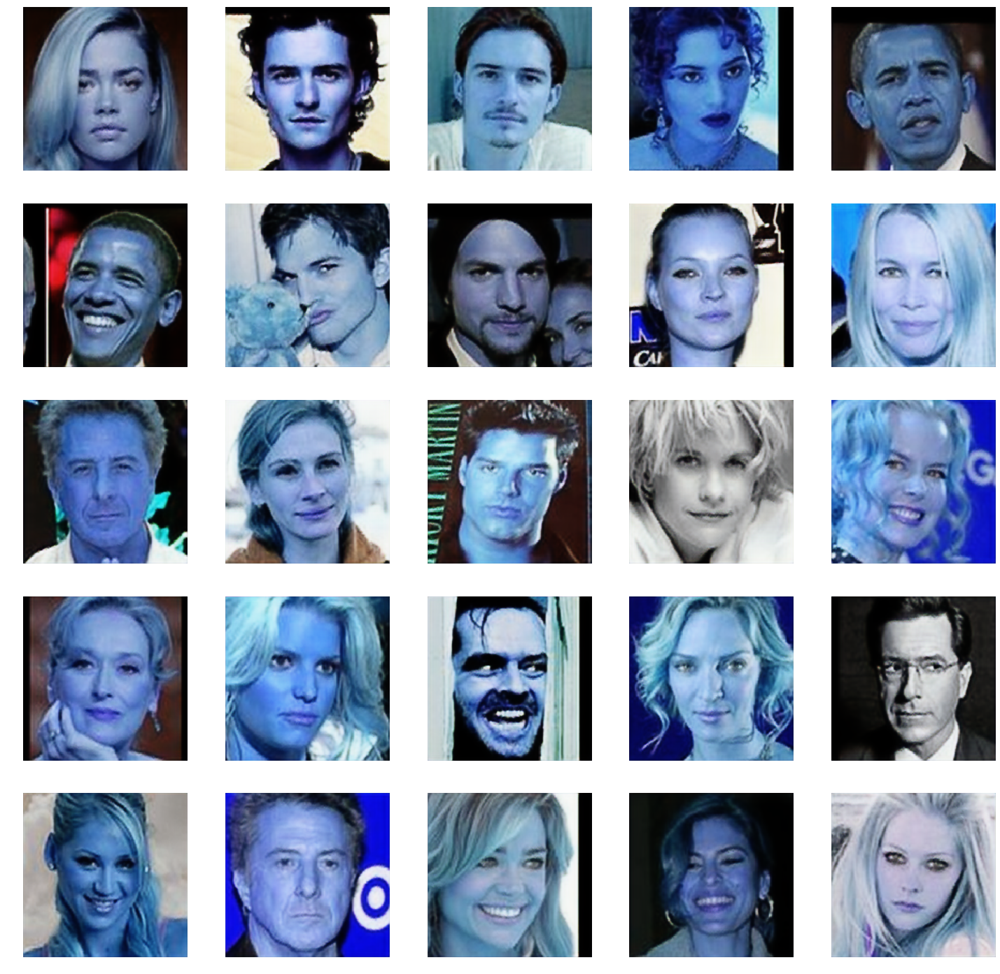

 52%|█████▏    | 2602/5000 [32:24<1:15:16,  1.88s/it]

[0.0026430676, 0.0]


 52%|█████▏    | 2603/5000 [32:24<1:01:21,  1.54s/it]

[0.004079833, 0.0]


 52%|█████▏    | 2604/5000 [32:25<51:39,  1.29s/it]  

[0.0030117906, 0.0]


 52%|█████▏    | 2605/5000 [32:26<44:36,  1.12s/it]

[0.006615384, 0.0]


 52%|█████▏    | 2606/5000 [32:27<39:48,  1.00it/s]

[0.0044339676, 0.0]


 52%|█████▏    | 2607/5000 [32:27<36:18,  1.10it/s]

[0.0077739796, 0.0]


 52%|█████▏    | 2608/5000 [32:28<33:59,  1.17it/s]

[0.0022257275, 0.0]


 52%|█████▏    | 2609/5000 [32:29<32:14,  1.24it/s]

[0.0020230592, 0.0]


 52%|█████▏    | 2610/5000 [32:29<31:07,  1.28it/s]

[0.0014878721, 0.0]


 52%|█████▏    | 2611/5000 [32:30<30:12,  1.32it/s]

[0.0020183278, 0.0]


 52%|█████▏    | 2612/5000 [32:31<29:46,  1.34it/s]

[0.0024654537, 0.0]


 52%|█████▏    | 2613/5000 [32:32<29:16,  1.36it/s]

[0.002636138, 0.0]


 52%|█████▏    | 2614/5000 [32:32<29:05,  1.37it/s]

[0.0015499198, 0.0]


 52%|█████▏    | 2615/5000 [32:33<28:46,  1.38it/s]

[0.0017641799, 0.0]


 52%|█████▏    | 2616/5000 [32:34<28:43,  1.38it/s]

[0.0035414498, 0.0]


 52%|█████▏    | 2617/5000 [32:34<28:32,  1.39it/s]

[0.0015777937, 0.0]


 52%|█████▏    | 2618/5000 [32:35<28:29,  1.39it/s]

[0.008577305, 0.0]


 52%|█████▏    | 2619/5000 [32:36<28:18,  1.40it/s]

[0.0018320339, 0.0]


 52%|█████▏    | 2620/5000 [32:37<28:19,  1.40it/s]

[0.0022005474, 0.0]


 52%|█████▏    | 2621/5000 [32:37<28:14,  1.40it/s]

[0.0014669314, 0.0]


 52%|█████▏    | 2622/5000 [32:38<28:16,  1.40it/s]

[0.0015731797, 0.0]


 52%|█████▏    | 2623/5000 [32:39<28:09,  1.41it/s]

[0.0018358326, 0.0]


 52%|█████▏    | 2624/5000 [32:39<28:15,  1.40it/s]

[0.0065237023, 0.0]


 52%|█████▎    | 2625/5000 [32:40<28:12,  1.40it/s]

[0.0019486672, 0.0]


 53%|█████▎    | 2626/5000 [32:41<28:09,  1.40it/s]

[0.003154949, 0.0]


 53%|█████▎    | 2627/5000 [32:42<28:03,  1.41it/s]

[0.0016234803, 0.0]


 53%|█████▎    | 2628/5000 [32:42<28:03,  1.41it/s]

[0.0023918347, 0.0]


 53%|█████▎    | 2629/5000 [32:43<27:58,  1.41it/s]

[0.0015687549, 0.0]


 53%|█████▎    | 2630/5000 [32:44<28:03,  1.41it/s]

[0.003488523, 0.0]


 53%|█████▎    | 2631/5000 [32:44<28:01,  1.41it/s]

[0.0021740932, 0.0]


 53%|█████▎    | 2632/5000 [32:45<28:09,  1.40it/s]

[0.0024531651, 0.0]


 53%|█████▎    | 2633/5000 [32:46<28:03,  1.41it/s]

[0.0036966552, 0.0]


 53%|█████▎    | 2634/5000 [32:47<28:10,  1.40it/s]

[0.0013450045, 0.0]


 53%|█████▎    | 2635/5000 [32:47<28:07,  1.40it/s]

[0.0070209727, 0.0]


 53%|█████▎    | 2636/5000 [32:48<28:12,  1.40it/s]

[0.0014860232, 0.0]


 53%|█████▎    | 2637/5000 [32:49<28:03,  1.40it/s]

[0.0018815125, 0.0]


 53%|█████▎    | 2638/5000 [32:49<28:08,  1.40it/s]

[0.003760324, 0.0]


 53%|█████▎    | 2639/5000 [32:50<28:03,  1.40it/s]

[0.0022403924, 0.0]


 53%|█████▎    | 2640/5000 [32:51<28:07,  1.40it/s]

[0.0024156494, 0.0]


 53%|█████▎    | 2641/5000 [32:52<28:02,  1.40it/s]

[0.0023993042, 0.0]


 53%|█████▎    | 2642/5000 [32:52<28:10,  1.40it/s]

[0.0018935661, 0.0]


 53%|█████▎    | 2643/5000 [32:53<28:04,  1.40it/s]

[0.0013577124, 0.0]


 53%|█████▎    | 2644/5000 [32:54<28:07,  1.40it/s]

[0.0017725278, 0.0]


 53%|█████▎    | 2645/5000 [32:54<28:02,  1.40it/s]

[0.0026634056, 0.0]


 53%|█████▎    | 2646/5000 [32:55<28:07,  1.39it/s]

[0.0020250527, 0.0]


 53%|█████▎    | 2647/5000 [32:56<27:59,  1.40it/s]

[0.0036933068, 0.0]


 53%|█████▎    | 2648/5000 [32:57<28:09,  1.39it/s]

[0.0019222558, 0.0]


 53%|█████▎    | 2649/5000 [32:57<27:59,  1.40it/s]

[0.0047107018, 0.0]


 53%|█████▎    | 2650/5000 [32:58<28:02,  1.40it/s]

[0.0015018124, 0.0]


 53%|█████▎    | 2651/5000 [32:59<27:57,  1.40it/s]

[0.0015014369, 0.0]
2650 [G loss: 0.001501, G acc.: 0.00%]


 53%|█████▎    | 2652/5000 [32:59<28:01,  1.40it/s]

[0.0016439529, 0.0]


 53%|█████▎    | 2653/5000 [33:00<27:53,  1.40it/s]

[0.0017402883, 0.0]


 53%|█████▎    | 2654/5000 [33:01<27:58,  1.40it/s]

[0.00226909, 0.0]


 53%|█████▎    | 2655/5000 [33:02<27:51,  1.40it/s]

[0.0019399503, 0.0]


 53%|█████▎    | 2656/5000 [33:02<27:57,  1.40it/s]

[0.004841904, 0.0]


 53%|█████▎    | 2657/5000 [33:03<27:51,  1.40it/s]

[0.0040312316, 0.0]


 53%|█████▎    | 2658/5000 [33:04<27:56,  1.40it/s]

[0.0014293131, 0.0]


 53%|█████▎    | 2659/5000 [33:04<27:48,  1.40it/s]

[0.0026397752, 0.0]


 53%|█████▎    | 2660/5000 [33:05<27:54,  1.40it/s]

[0.0017556115, 0.0]


 53%|█████▎    | 2661/5000 [33:06<27:47,  1.40it/s]

[0.0014802435, 0.0]


 53%|█████▎    | 2662/5000 [33:07<27:51,  1.40it/s]

[0.0015502507, 0.0]


 53%|█████▎    | 2663/5000 [33:07<27:46,  1.40it/s]

[0.0043445285, 0.0]


 53%|█████▎    | 2664/5000 [33:08<27:50,  1.40it/s]

[0.0032920397, 0.0]


 53%|█████▎    | 2665/5000 [33:09<27:44,  1.40it/s]

[0.0023892466, 0.0]


 53%|█████▎    | 2666/5000 [33:09<27:45,  1.40it/s]

[0.0012992362, 0.0]


 53%|█████▎    | 2667/5000 [33:10<27:42,  1.40it/s]

[0.0027743361, 0.0]


 53%|█████▎    | 2668/5000 [33:11<27:49,  1.40it/s]

[0.0033261878, 0.0]


 53%|█████▎    | 2669/5000 [33:12<27:44,  1.40it/s]

[0.0038953417, 0.0]


 53%|█████▎    | 2670/5000 [33:12<27:48,  1.40it/s]

[0.0019586964, 0.0]


 53%|█████▎    | 2671/5000 [33:13<27:40,  1.40it/s]

[0.0037125405, 0.0]


 53%|█████▎    | 2672/5000 [33:14<27:45,  1.40it/s]

[0.002507736, 0.0]


 53%|█████▎    | 2673/5000 [33:14<27:37,  1.40it/s]

[0.0017419546, 0.0]


 53%|█████▎    | 2674/5000 [33:15<27:40,  1.40it/s]

[0.002451944, 0.0]


 54%|█████▎    | 2675/5000 [33:16<27:35,  1.40it/s]

[0.010175508, 0.0]


 54%|█████▎    | 2676/5000 [33:17<27:45,  1.39it/s]

[0.0020191967, 0.0]


 54%|█████▎    | 2677/5000 [33:17<27:41,  1.40it/s]

[0.001796008, 0.0]


 54%|█████▎    | 2678/5000 [33:18<27:44,  1.39it/s]

[0.0021020952, 0.0]


 54%|█████▎    | 2679/5000 [33:19<27:39,  1.40it/s]

[0.0026371242, 0.0]


 54%|█████▎    | 2680/5000 [33:19<27:43,  1.39it/s]

[0.0023072644, 0.0]


 54%|█████▎    | 2681/5000 [33:20<27:36,  1.40it/s]

[0.0017095851, 0.0]


 54%|█████▎    | 2682/5000 [33:21<27:40,  1.40it/s]

[0.0014105155, 0.0]


 54%|█████▎    | 2683/5000 [33:22<27:33,  1.40it/s]

[0.0019710022, 0.0]


 54%|█████▎    | 2684/5000 [33:22<27:38,  1.40it/s]

[0.0023289202, 0.0]


 54%|█████▎    | 2685/5000 [33:23<27:34,  1.40it/s]

[0.0027710316, 0.0]


 54%|█████▎    | 2686/5000 [33:24<27:37,  1.40it/s]

[0.0018193155, 0.0]


 54%|█████▎    | 2687/5000 [33:24<27:33,  1.40it/s]

[0.0024551956, 0.0]


 54%|█████▍    | 2688/5000 [33:25<27:39,  1.39it/s]

[0.0036116007, 0.0]


 54%|█████▍    | 2689/5000 [33:26<27:30,  1.40it/s]

[0.0032208513, 0.0]


 54%|█████▍    | 2690/5000 [33:27<27:34,  1.40it/s]

[0.0012641922, 0.0]


 54%|█████▍    | 2691/5000 [33:27<27:26,  1.40it/s]

[0.0041262372, 0.0]


 54%|█████▍    | 2692/5000 [33:28<27:30,  1.40it/s]

[0.0018611441, 0.0]


 54%|█████▍    | 2693/5000 [33:29<27:24,  1.40it/s]

[0.001479482, 0.0]


 54%|█████▍    | 2694/5000 [33:29<27:27,  1.40it/s]

[0.0024695648, 0.0]


 54%|█████▍    | 2695/5000 [33:30<27:23,  1.40it/s]

[0.0017708921, 0.0]


 54%|█████▍    | 2696/5000 [33:31<27:24,  1.40it/s]

[0.0021804408, 0.0]


 54%|█████▍    | 2697/5000 [33:32<27:21,  1.40it/s]

[0.001817177, 0.0]


 54%|█████▍    | 2698/5000 [33:32<27:23,  1.40it/s]

[0.005580161, 0.0]


 54%|█████▍    | 2699/5000 [33:33<27:21,  1.40it/s]

[0.001464232, 0.0]


 54%|█████▍    | 2700/5000 [33:34<27:23,  1.40it/s]

[0.0014202308, 0.0]


 54%|█████▍    | 2701/5000 [33:34<27:15,  1.41it/s]

[0.0023920066, 0.0]
2700 [G loss: 0.002392, G acc.: 0.00%]


 54%|█████▍    | 2702/5000 [33:35<27:19,  1.40it/s]

[0.0016076239, 0.0]


 54%|█████▍    | 2703/5000 [33:36<27:17,  1.40it/s]

[0.002005615, 0.0]


 54%|█████▍    | 2704/5000 [33:37<27:21,  1.40it/s]

[0.0023342848, 0.0]


 54%|█████▍    | 2705/5000 [33:37<27:18,  1.40it/s]

[0.002653801, 0.0]


 54%|█████▍    | 2706/5000 [33:38<27:21,  1.40it/s]

[0.002974449, 0.0]


 54%|█████▍    | 2707/5000 [33:39<27:14,  1.40it/s]

[0.0018181499, 0.0]


 54%|█████▍    | 2708/5000 [33:39<27:20,  1.40it/s]

[0.0031924087, 0.0]


 54%|█████▍    | 2709/5000 [33:40<27:14,  1.40it/s]

[0.0019144042, 0.0]


 54%|█████▍    | 2710/5000 [33:41<27:18,  1.40it/s]

[0.0015434027, 0.0]


 54%|█████▍    | 2711/5000 [33:42<27:09,  1.40it/s]

[0.0030973183, 0.0]


 54%|█████▍    | 2712/5000 [33:42<27:20,  1.40it/s]

[0.002927394, 0.0]


 54%|█████▍    | 2713/5000 [33:43<27:11,  1.40it/s]

[0.00184473, 0.0]


 54%|█████▍    | 2714/5000 [33:44<27:16,  1.40it/s]

[0.001896309, 0.0]


 54%|█████▍    | 2715/5000 [33:44<27:09,  1.40it/s]

[0.001709417, 0.0]


 54%|█████▍    | 2716/5000 [33:45<27:15,  1.40it/s]

[0.0030101605, 0.0]


 54%|█████▍    | 2717/5000 [33:46<27:10,  1.40it/s]

[0.001459044, 0.0]


 54%|█████▍    | 2718/5000 [33:47<27:12,  1.40it/s]

[0.0026687963, 0.0]


 54%|█████▍    | 2719/5000 [33:47<27:08,  1.40it/s]

[0.002271378, 0.0]


 54%|█████▍    | 2720/5000 [33:48<27:12,  1.40it/s]

[0.0013868391, 0.0]


 54%|█████▍    | 2721/5000 [33:49<27:06,  1.40it/s]

[0.0015211994, 0.0]


 54%|█████▍    | 2722/5000 [33:49<27:15,  1.39it/s]

[0.0027743857, 0.0]


 54%|█████▍    | 2723/5000 [33:50<27:10,  1.40it/s]

[0.0014395898, 0.0]


 54%|█████▍    | 2724/5000 [33:51<27:13,  1.39it/s]

[0.003043789, 0.0]


 55%|█████▍    | 2725/5000 [33:52<27:06,  1.40it/s]

[0.0026849243, 0.0]


 55%|█████▍    | 2726/5000 [33:52<27:09,  1.40it/s]

[0.0032529233, 0.0]


 55%|█████▍    | 2727/5000 [33:53<27:01,  1.40it/s]

[0.003333492, 0.0]


 55%|█████▍    | 2728/5000 [33:54<27:07,  1.40it/s]

[0.0016674234, 0.0]


 55%|█████▍    | 2729/5000 [33:54<27:03,  1.40it/s]

[0.0022723624, 0.0]


 55%|█████▍    | 2730/5000 [33:55<27:08,  1.39it/s]

[0.0017609292, 0.0]


 55%|█████▍    | 2731/5000 [33:56<27:03,  1.40it/s]

[0.0021391432, 0.0]


 55%|█████▍    | 2732/5000 [33:57<27:07,  1.39it/s]

[0.0024375406, 0.0]


 55%|█████▍    | 2733/5000 [33:57<26:59,  1.40it/s]

[0.0016047827, 0.0]


 55%|█████▍    | 2734/5000 [33:58<27:02,  1.40it/s]

[0.0016584605, 0.0]


 55%|█████▍    | 2735/5000 [33:59<26:58,  1.40it/s]

[0.0026116355, 0.0]


 55%|█████▍    | 2736/5000 [33:59<27:00,  1.40it/s]

[0.00227182, 0.0]


 55%|█████▍    | 2737/5000 [34:00<26:54,  1.40it/s]

[0.002802515, 0.0]


 55%|█████▍    | 2738/5000 [34:01<26:58,  1.40it/s]

[0.0015479461, 0.0]


 55%|█████▍    | 2739/5000 [34:02<26:53,  1.40it/s]

[0.0039067683, 0.0]


 55%|█████▍    | 2740/5000 [34:02<26:53,  1.40it/s]

[0.0020746905, 0.0]


 55%|█████▍    | 2741/5000 [34:03<26:48,  1.40it/s]

[0.0018263918, 0.0]


 55%|█████▍    | 2742/5000 [34:04<26:53,  1.40it/s]

[0.0024481227, 0.0]


 55%|█████▍    | 2743/5000 [34:04<26:46,  1.41it/s]

[0.0032254346, 0.0]


 55%|█████▍    | 2744/5000 [34:05<26:50,  1.40it/s]

[0.0021676365, 0.0]


 55%|█████▍    | 2745/5000 [34:06<26:44,  1.41it/s]

[0.008755306, 0.0]


 55%|█████▍    | 2746/5000 [34:07<26:51,  1.40it/s]

[0.0021491847, 0.0]


 55%|█████▍    | 2747/5000 [34:07<26:44,  1.40it/s]

[0.0017971366, 0.0]


 55%|█████▍    | 2748/5000 [34:08<26:50,  1.40it/s]

[0.0021938968, 0.0]


 55%|█████▍    | 2749/5000 [34:09<26:44,  1.40it/s]

[0.0035387943, 0.0]


 55%|█████▌    | 2750/5000 [34:09<26:50,  1.40it/s]

[0.0034691377, 0.0]


 55%|█████▌    | 2751/5000 [34:10<26:43,  1.40it/s]

[0.0019092887, 0.0]
2750 [G loss: 0.001909, G acc.: 0.00%]


 55%|█████▌    | 2752/5000 [34:11<26:52,  1.39it/s]

[0.0019934166, 0.0]


 55%|█████▌    | 2753/5000 [34:12<26:49,  1.40it/s]

[0.0015141293, 0.0]


 55%|█████▌    | 2754/5000 [34:12<26:51,  1.39it/s]

[0.0019953065, 0.0]


 55%|█████▌    | 2755/5000 [34:13<26:46,  1.40it/s]

[0.0012896315, 0.0]


 55%|█████▌    | 2756/5000 [34:14<26:51,  1.39it/s]

[0.0014054982, 0.0]


 55%|█████▌    | 2757/5000 [34:14<26:43,  1.40it/s]

[0.0032521875, 0.0]


 55%|█████▌    | 2758/5000 [34:15<26:46,  1.40it/s]

[0.0030944673, 0.0]


 55%|█████▌    | 2759/5000 [34:16<26:40,  1.40it/s]

[0.0017706628, 0.0]


 55%|█████▌    | 2760/5000 [34:17<26:44,  1.40it/s]

[0.0015146617, 0.0]


 55%|█████▌    | 2761/5000 [34:17<26:40,  1.40it/s]

[0.0021939643, 0.0]


 55%|█████▌    | 2762/5000 [34:18<26:43,  1.40it/s]

[0.0042635156, 0.0]


 55%|█████▌    | 2763/5000 [34:19<26:38,  1.40it/s]

[0.0019573998, 0.0]


 55%|█████▌    | 2764/5000 [34:19<26:44,  1.39it/s]

[0.002516603, 0.0]


 55%|█████▌    | 2765/5000 [34:20<26:37,  1.40it/s]

[0.0015434624, 0.0]


 55%|█████▌    | 2766/5000 [34:21<26:39,  1.40it/s]

[0.0025576425, 0.0]


 55%|█████▌    | 2767/5000 [34:22<26:34,  1.40it/s]

[0.0016219695, 0.0]


 55%|█████▌    | 2768/5000 [34:22<26:36,  1.40it/s]

[0.0039961236, 0.0]


 55%|█████▌    | 2769/5000 [34:23<26:30,  1.40it/s]

[0.002082999, 0.0]


 55%|█████▌    | 2770/5000 [34:24<26:32,  1.40it/s]

[0.0020156999, 0.0]


 55%|█████▌    | 2771/5000 [34:24<26:27,  1.40it/s]

[0.0018166562, 0.0]


 55%|█████▌    | 2772/5000 [34:25<26:33,  1.40it/s]

[0.0022352922, 0.0]


 55%|█████▌    | 2773/5000 [34:26<26:27,  1.40it/s]

[0.0021304158, 0.0]


 55%|█████▌    | 2774/5000 [34:27<26:30,  1.40it/s]

[0.0016290765, 0.0]


 56%|█████▌    | 2775/5000 [34:27<26:26,  1.40it/s]

[0.0018971362, 0.0]


 56%|█████▌    | 2776/5000 [34:28<26:27,  1.40it/s]

[0.0018304285, 0.0]


 56%|█████▌    | 2777/5000 [34:29<26:24,  1.40it/s]

[0.0071020005, 0.0]


 56%|█████▌    | 2778/5000 [34:29<26:24,  1.40it/s]

[0.008979957, 0.0]


 56%|█████▌    | 2779/5000 [34:30<26:19,  1.41it/s]

[0.0016040148, 0.0]


 56%|█████▌    | 2780/5000 [34:31<26:21,  1.40it/s]

[0.0016929111, 0.0]


 56%|█████▌    | 2781/5000 [34:32<26:14,  1.41it/s]

[0.0018605297, 0.0]


 56%|█████▌    | 2782/5000 [34:32<26:16,  1.41it/s]

[0.0033209496, 0.0]


 56%|█████▌    | 2783/5000 [34:33<26:14,  1.41it/s]

[0.0018811525, 0.0]


 56%|█████▌    | 2784/5000 [34:34<26:17,  1.40it/s]

[0.00650125, 0.0]


 56%|█████▌    | 2785/5000 [34:34<26:17,  1.40it/s]

[0.0016661866, 0.0]


 56%|█████▌    | 2786/5000 [34:35<26:19,  1.40it/s]

[0.0026277858, 0.0]


 56%|█████▌    | 2787/5000 [34:36<26:17,  1.40it/s]

[0.0022013453, 0.0]


 56%|█████▌    | 2788/5000 [34:37<26:20,  1.40it/s]

[0.0017797566, 0.0]


 56%|█████▌    | 2789/5000 [34:37<26:16,  1.40it/s]

[0.0035690775, 0.0]


 56%|█████▌    | 2790/5000 [34:38<26:18,  1.40it/s]

[0.0052246954, 0.0]


 56%|█████▌    | 2791/5000 [34:39<26:14,  1.40it/s]

[0.007347248, 0.0]


 56%|█████▌    | 2792/5000 [34:39<26:16,  1.40it/s]

[0.001790054, 0.0]


 56%|█████▌    | 2793/5000 [34:40<26:12,  1.40it/s]

[0.0027384986, 0.0]


 56%|█████▌    | 2794/5000 [34:41<26:15,  1.40it/s]

[0.00230254, 0.0]


 56%|█████▌    | 2795/5000 [34:42<26:11,  1.40it/s]

[0.0036825745, 0.0]


 56%|█████▌    | 2796/5000 [34:42<26:15,  1.40it/s]

[0.006590593, 0.0]


 56%|█████▌    | 2797/5000 [34:43<26:10,  1.40it/s]

[0.001570212, 0.0]


 56%|█████▌    | 2798/5000 [34:44<26:12,  1.40it/s]

[0.0024408903, 0.0]


 56%|█████▌    | 2799/5000 [34:44<26:08,  1.40it/s]

[0.0022864724, 0.0]


 56%|█████▌    | 2800/5000 [34:45<26:12,  1.40it/s]

[0.0029658694, 0.0]
[0.002235715, 0.0]
2800 [G loss: 0.002236, G acc.: 0.00%]


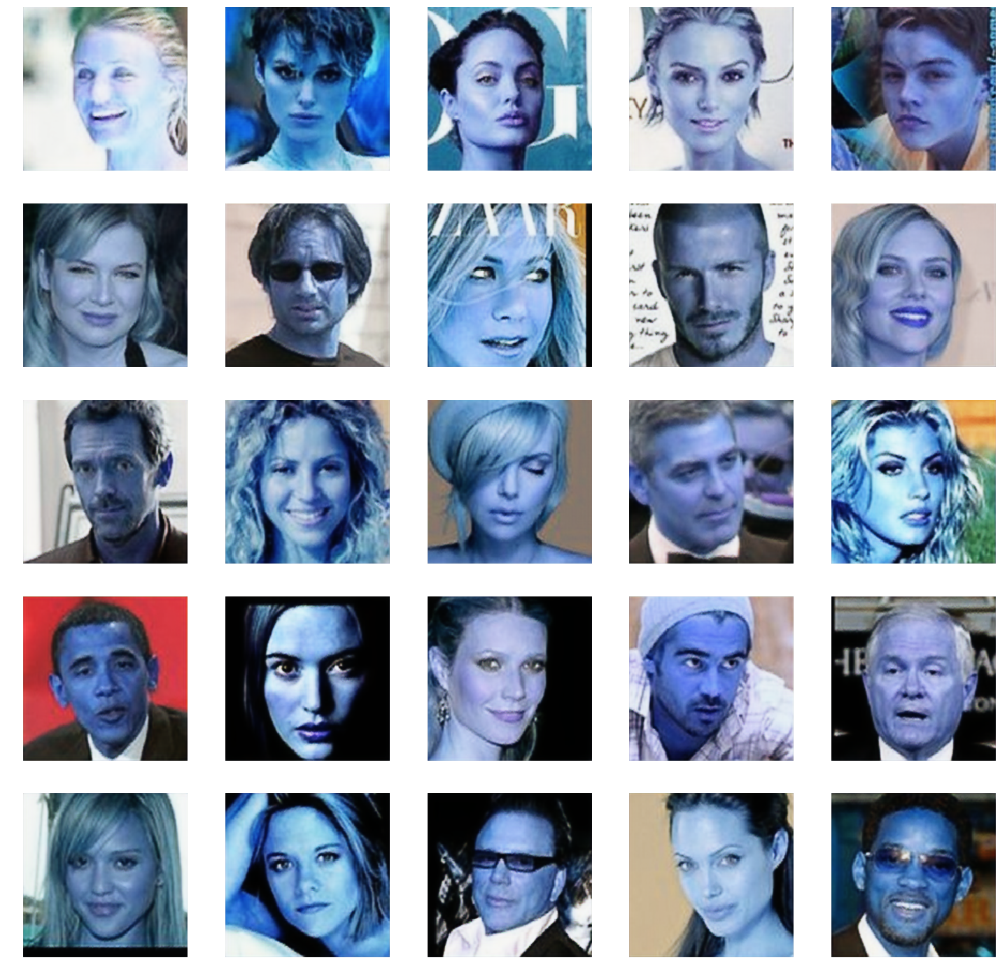

 56%|█████▌    | 2802/5000 [34:52<1:04:57,  1.77s/it]

[0.0034722856, 0.0]


 56%|█████▌    | 2803/5000 [34:52<53:27,  1.46s/it]  

[0.0015633296, 0.0]


 56%|█████▌    | 2804/5000 [34:53<45:20,  1.24s/it]

[0.0016850536, 0.0]


 56%|█████▌    | 2805/5000 [34:54<39:32,  1.08s/it]

[0.002376284, 0.0]


 56%|█████▌    | 2806/5000 [34:54<35:34,  1.03it/s]

[0.0018644043, 0.0]


 56%|█████▌    | 2807/5000 [34:55<32:39,  1.12it/s]

[0.0025043888, 0.0]


 56%|█████▌    | 2808/5000 [34:56<30:42,  1.19it/s]

[0.0043898765, 0.0]


 56%|█████▌    | 2809/5000 [34:57<29:13,  1.25it/s]

[0.0016484504, 0.0]


 56%|█████▌    | 2810/5000 [34:57<28:18,  1.29it/s]

[0.0027419634, 0.0]


 56%|█████▌    | 2811/5000 [34:58<27:35,  1.32it/s]

[0.0019784006, 0.0]


 56%|█████▌    | 2812/5000 [34:59<27:10,  1.34it/s]

[0.0020263786, 0.0]


 56%|█████▋    | 2813/5000 [34:59<26:45,  1.36it/s]

[0.0024695224, 0.0]


 56%|█████▋    | 2814/5000 [35:00<26:32,  1.37it/s]

[0.002016247, 0.0]


 56%|█████▋    | 2815/5000 [35:01<26:16,  1.39it/s]

[0.0021085567, 0.0]


 56%|█████▋    | 2816/5000 [35:02<26:12,  1.39it/s]

[0.0027524552, 0.0]


 56%|█████▋    | 2817/5000 [35:02<26:03,  1.40it/s]

[0.0017805613, 0.0]


 56%|█████▋    | 2818/5000 [35:03<26:03,  1.40it/s]

[0.0027863367, 0.0]


 56%|█████▋    | 2819/5000 [35:04<25:56,  1.40it/s]

[0.005116048, 0.0]


 56%|█████▋    | 2820/5000 [35:04<25:55,  1.40it/s]

[0.0017024737, 0.0]


 56%|█████▋    | 2821/5000 [35:05<25:47,  1.41it/s]

[0.0017767445, 0.0]


 56%|█████▋    | 2822/5000 [35:06<25:53,  1.40it/s]

[0.0019403681, 0.0]


 56%|█████▋    | 2823/5000 [35:07<25:50,  1.40it/s]

[0.001982909, 0.0]


 56%|█████▋    | 2824/5000 [35:07<25:56,  1.40it/s]

[0.0020651915, 0.0]


 56%|█████▋    | 2825/5000 [35:08<25:51,  1.40it/s]

[0.0012794054, 0.0]


 57%|█████▋    | 2826/5000 [35:09<25:58,  1.39it/s]

[0.0015181939, 0.0]


 57%|█████▋    | 2827/5000 [35:09<25:52,  1.40it/s]

[0.0016078479, 0.0]


 57%|█████▋    | 2828/5000 [35:10<25:52,  1.40it/s]

[0.0016607501, 0.0]


 57%|█████▋    | 2829/5000 [35:11<25:47,  1.40it/s]

[0.001963629, 0.0]


 57%|█████▋    | 2830/5000 [35:12<25:51,  1.40it/s]

[0.0018202944, 0.0]


 57%|█████▋    | 2831/5000 [35:12<25:47,  1.40it/s]

[0.002268158, 0.0]


 57%|█████▋    | 2832/5000 [35:13<25:57,  1.39it/s]

[0.0015888169, 0.0]


 57%|█████▋    | 2833/5000 [35:14<25:52,  1.40it/s]

[0.003047956, 0.0]


 57%|█████▋    | 2834/5000 [35:14<25:52,  1.40it/s]

[0.0018865868, 0.0]


 57%|█████▋    | 2835/5000 [35:15<25:45,  1.40it/s]

[0.0023170912, 0.0]


 57%|█████▋    | 2836/5000 [35:16<25:48,  1.40it/s]

[0.0016028465, 0.0]


 57%|█████▋    | 2837/5000 [35:17<25:42,  1.40it/s]

[0.0015878549, 0.0]


 57%|█████▋    | 2838/5000 [35:17<25:45,  1.40it/s]

[0.0027487853, 0.0]


 57%|█████▋    | 2839/5000 [35:18<25:41,  1.40it/s]

[0.0071375906, 0.0]


 57%|█████▋    | 2840/5000 [35:19<25:43,  1.40it/s]

[0.0016168312, 0.0]


 57%|█████▋    | 2841/5000 [35:19<25:33,  1.41it/s]

[0.0023025377, 0.0]


 57%|█████▋    | 2842/5000 [35:20<26:14,  1.37it/s]

[0.002050286, 0.0]


 57%|█████▋    | 2843/5000 [35:21<25:57,  1.38it/s]

[0.0039918926, 0.0]


 57%|█████▋    | 2844/5000 [35:22<25:54,  1.39it/s]

[0.006181683, 0.0]


 57%|█████▋    | 2845/5000 [35:22<25:46,  1.39it/s]

[0.002637394, 0.0]


 57%|█████▋    | 2846/5000 [35:23<25:45,  1.39it/s]

[0.0023374122, 0.0]


 57%|█████▋    | 2847/5000 [35:24<25:36,  1.40it/s]

[0.001764533, 0.0]


 57%|█████▋    | 2848/5000 [35:24<25:37,  1.40it/s]

[0.0017931266, 0.0]


 57%|█████▋    | 2849/5000 [35:25<25:34,  1.40it/s]

[0.0017952495, 0.0]


 57%|█████▋    | 2850/5000 [35:26<25:35,  1.40it/s]

[0.0024543407, 0.0]


 57%|█████▋    | 2851/5000 [35:27<25:28,  1.41it/s]

[0.0015303439, 0.0]
2850 [G loss: 0.001530, G acc.: 0.00%]


 57%|█████▋    | 2852/5000 [35:27<25:35,  1.40it/s]

[0.0014868072, 0.0]


 57%|█████▋    | 2853/5000 [35:28<25:28,  1.40it/s]

[0.0017185996, 0.0]


 57%|█████▋    | 2854/5000 [35:29<25:30,  1.40it/s]

[0.004776459, 0.0]


 57%|█████▋    | 2855/5000 [35:29<25:31,  1.40it/s]

[0.0020125096, 0.0]


 57%|█████▋    | 2856/5000 [35:30<25:31,  1.40it/s]

[0.0018411799, 0.0]


 57%|█████▋    | 2857/5000 [35:31<25:26,  1.40it/s]

[0.0016248494, 0.0]


 57%|█████▋    | 2858/5000 [35:32<25:29,  1.40it/s]

[0.0021920432, 0.0]


 57%|█████▋    | 2859/5000 [35:32<25:24,  1.40it/s]

[0.0032284912, 0.0]


 57%|█████▋    | 2860/5000 [35:33<25:26,  1.40it/s]

[0.0020826277, 0.0]


 57%|█████▋    | 2861/5000 [35:34<25:22,  1.40it/s]

[0.0035404342, 0.0]


 57%|█████▋    | 2862/5000 [35:34<25:26,  1.40it/s]

[0.0029518572, 0.0]


 57%|█████▋    | 2863/5000 [35:35<25:25,  1.40it/s]

[0.0021894786, 0.0]


 57%|█████▋    | 2864/5000 [35:36<25:28,  1.40it/s]

[0.0014861438, 0.0]


 57%|█████▋    | 2865/5000 [35:37<25:24,  1.40it/s]

[0.0020839386, 0.0]


 57%|█████▋    | 2866/5000 [35:37<25:28,  1.40it/s]

[0.0017897441, 0.0]


 57%|█████▋    | 2867/5000 [35:38<25:20,  1.40it/s]

[0.0027995817, 0.0]


 57%|█████▋    | 2868/5000 [35:39<25:23,  1.40it/s]

[0.0015647177, 0.0]


 57%|█████▋    | 2869/5000 [35:39<25:17,  1.40it/s]

[0.0033790648, 0.0]


 57%|█████▋    | 2870/5000 [35:40<25:21,  1.40it/s]

[0.0025627646, 0.0]


 57%|█████▋    | 2871/5000 [35:41<25:18,  1.40it/s]

[0.0015965881, 0.0]


 57%|█████▋    | 2872/5000 [35:42<25:23,  1.40it/s]

[0.0012390851, 0.0]


 57%|█████▋    | 2873/5000 [35:42<25:17,  1.40it/s]

[0.0043671425, 0.0]


 57%|█████▋    | 2874/5000 [35:43<25:20,  1.40it/s]

[0.0014612073, 0.0]


 57%|█████▊    | 2875/5000 [35:44<25:16,  1.40it/s]

[0.0016601814, 0.0]


 58%|█████▊    | 2876/5000 [35:44<25:18,  1.40it/s]

[0.0026254007, 0.0]


 58%|█████▊    | 2877/5000 [35:45<25:09,  1.41it/s]

[0.0013347036, 0.0]


 58%|█████▊    | 2878/5000 [35:46<25:12,  1.40it/s]

[0.0025540143, 0.0]


 58%|█████▊    | 2879/5000 [35:47<25:09,  1.41it/s]

[0.0027297689, 0.0]


 58%|█████▊    | 2880/5000 [35:47<25:09,  1.40it/s]

[0.0018088933, 0.0]


 58%|█████▊    | 2881/5000 [35:48<25:04,  1.41it/s]

[0.003953965, 0.0]


 58%|█████▊    | 2882/5000 [35:49<25:09,  1.40it/s]

[0.0043944526, 0.0]


 58%|█████▊    | 2883/5000 [35:49<25:06,  1.40it/s]

[0.0013906113, 0.0]


 58%|█████▊    | 2884/5000 [35:50<25:13,  1.40it/s]

[0.0018239435, 0.0]


 58%|█████▊    | 2885/5000 [35:51<25:10,  1.40it/s]

[0.00224527, 0.0]


 58%|█████▊    | 2886/5000 [35:52<25:13,  1.40it/s]

[0.004999636, 0.0]


 58%|█████▊    | 2887/5000 [35:52<25:05,  1.40it/s]

[0.0015737301, 0.0]


 58%|█████▊    | 2888/5000 [35:53<25:09,  1.40it/s]

[0.002086576, 0.0]


 58%|█████▊    | 2889/5000 [35:54<25:04,  1.40it/s]

[0.001339604, 0.0]


 58%|█████▊    | 2890/5000 [35:54<25:04,  1.40it/s]

[0.004305134, 0.0]


 58%|█████▊    | 2891/5000 [35:55<25:02,  1.40it/s]

[0.0016800702, 0.0]


 58%|█████▊    | 2892/5000 [35:56<25:07,  1.40it/s]

[0.0021911643, 0.0]


 58%|█████▊    | 2893/5000 [35:57<25:01,  1.40it/s]

[0.0025065765, 0.0]


 58%|█████▊    | 2894/5000 [35:57<25:07,  1.40it/s]

[0.001643436, 0.0]


 58%|█████▊    | 2895/5000 [35:58<24:59,  1.40it/s]

[0.002346158, 0.0]


 58%|█████▊    | 2896/5000 [35:59<25:02,  1.40it/s]

[0.0020721157, 0.0]


 58%|█████▊    | 2897/5000 [35:59<24:56,  1.41it/s]

[0.0042441324, 0.0]


 58%|█████▊    | 2898/5000 [36:00<24:57,  1.40it/s]

[0.0015307803, 0.0]


 58%|█████▊    | 2899/5000 [36:01<24:53,  1.41it/s]

[0.0026332287, 0.0]


 58%|█████▊    | 2900/5000 [36:02<24:58,  1.40it/s]

[0.0014858004, 0.0]


 58%|█████▊    | 2901/5000 [36:02<24:51,  1.41it/s]

[0.0027612962, 0.0]
2900 [G loss: 0.002761, G acc.: 0.00%]


 58%|█████▊    | 2902/5000 [36:03<24:54,  1.40it/s]

[0.0020608623, 0.0]


 58%|█████▊    | 2903/5000 [36:04<24:52,  1.41it/s]

[0.0020975377, 0.0]


 58%|█████▊    | 2904/5000 [36:04<24:54,  1.40it/s]

[0.0030477098, 0.0]


 58%|█████▊    | 2905/5000 [36:05<24:52,  1.40it/s]

[0.0016758203, 0.0]


 58%|█████▊    | 2906/5000 [36:06<24:56,  1.40it/s]

[0.0074042436, 0.0]


 58%|█████▊    | 2907/5000 [36:07<24:53,  1.40it/s]

[0.0058159847, 0.0]


 58%|█████▊    | 2908/5000 [36:07<24:55,  1.40it/s]

[0.0015654302, 0.0]


 58%|█████▊    | 2909/5000 [36:08<24:49,  1.40it/s]

[0.0014249467, 0.0]


 58%|█████▊    | 2910/5000 [36:09<24:53,  1.40it/s]

[0.0018419388, 0.0]


 58%|█████▊    | 2911/5000 [36:09<24:47,  1.40it/s]

[0.0036333452, 0.0]


 58%|█████▊    | 2912/5000 [36:10<24:53,  1.40it/s]

[0.0017928925, 0.0]


 58%|█████▊    | 2913/5000 [36:11<24:49,  1.40it/s]

[0.0013918525, 0.0]


 58%|█████▊    | 2914/5000 [36:12<24:55,  1.39it/s]

[0.0016452734, 0.0]


 58%|█████▊    | 2915/5000 [36:12<24:49,  1.40it/s]

[0.007008863, 0.0]


 58%|█████▊    | 2916/5000 [36:13<24:52,  1.40it/s]

[0.0018448526, 0.0]


 58%|█████▊    | 2917/5000 [36:14<24:45,  1.40it/s]

[0.0014365787, 0.0]


 58%|█████▊    | 2918/5000 [36:14<24:50,  1.40it/s]

[0.0015749907, 0.0]


 58%|█████▊    | 2919/5000 [36:15<24:44,  1.40it/s]

[0.0015319801, 0.0]


 58%|█████▊    | 2920/5000 [36:16<24:49,  1.40it/s]

[0.00284807, 0.0]


 58%|█████▊    | 2921/5000 [36:17<24:43,  1.40it/s]

[0.003334106, 0.0]


 58%|█████▊    | 2922/5000 [36:17<24:47,  1.40it/s]

[0.0033163803, 0.0]


 58%|█████▊    | 2923/5000 [36:18<24:44,  1.40it/s]

[0.0022217191, 0.0]


 58%|█████▊    | 2924/5000 [36:19<24:47,  1.40it/s]

[0.0021666477, 0.0]


 58%|█████▊    | 2925/5000 [36:19<24:42,  1.40it/s]

[0.0032781053, 0.0]


 59%|█████▊    | 2926/5000 [36:20<24:44,  1.40it/s]

[0.002084527, 0.0]


 59%|█████▊    | 2927/5000 [36:21<24:39,  1.40it/s]

[0.001813042, 0.0]


 59%|█████▊    | 2928/5000 [36:22<24:43,  1.40it/s]

[0.0016619071, 0.0]


 59%|█████▊    | 2929/5000 [36:22<24:39,  1.40it/s]

[0.0023913758, 0.0]


 59%|█████▊    | 2930/5000 [36:23<24:40,  1.40it/s]

[0.0030865106, 0.0]


 59%|█████▊    | 2931/5000 [36:24<24:36,  1.40it/s]

[0.004165571, 0.0]


 59%|█████▊    | 2932/5000 [36:24<24:43,  1.39it/s]

[0.0015607505, 0.0]


 59%|█████▊    | 2933/5000 [36:25<24:38,  1.40it/s]

[0.0033580435, 0.0]


 59%|█████▊    | 2934/5000 [36:26<24:42,  1.39it/s]

[0.001545178, 0.0]


 59%|█████▊    | 2935/5000 [36:27<24:37,  1.40it/s]

[0.0020294953, 0.0]


 59%|█████▊    | 2936/5000 [36:27<24:40,  1.39it/s]

[0.0015668408, 0.0]


 59%|█████▊    | 2937/5000 [36:28<24:33,  1.40it/s]

[0.0015474221, 0.0]


 59%|█████▉    | 2938/5000 [36:29<24:38,  1.39it/s]

[0.0020588252, 0.0]


 59%|█████▉    | 2939/5000 [36:29<24:33,  1.40it/s]

[0.0018325782, 0.0]


 59%|█████▉    | 2940/5000 [36:30<24:35,  1.40it/s]

[0.00257075, 0.0]


 59%|█████▉    | 2941/5000 [36:31<24:28,  1.40it/s]

[0.007645528, 0.0]


 59%|█████▉    | 2942/5000 [36:32<24:34,  1.40it/s]

[0.002405263, 0.0]


 59%|█████▉    | 2943/5000 [36:32<24:29,  1.40it/s]

[0.0020358202, 0.0]


 59%|█████▉    | 2944/5000 [36:33<24:31,  1.40it/s]

[0.005250673, 0.0]


 59%|█████▉    | 2945/5000 [36:34<24:23,  1.40it/s]

[0.0016260345, 0.0]


 59%|█████▉    | 2946/5000 [36:34<24:27,  1.40it/s]

[0.0018978826, 0.0]


 59%|█████▉    | 2947/5000 [36:35<24:25,  1.40it/s]

[0.0014288446, 0.0]


 59%|█████▉    | 2948/5000 [36:36<24:30,  1.40it/s]

[0.0032677213, 0.0]


 59%|█████▉    | 2949/5000 [36:37<24:27,  1.40it/s]

[0.0023111466, 0.0]


 59%|█████▉    | 2950/5000 [36:37<24:28,  1.40it/s]

[0.0031048267, 0.0]


 59%|█████▉    | 2951/5000 [36:38<24:22,  1.40it/s]

[0.0018800085, 0.0]
2950 [G loss: 0.001880, G acc.: 0.00%]


 59%|█████▉    | 2952/5000 [36:39<24:26,  1.40it/s]

[0.0033938517, 0.0]


 59%|█████▉    | 2953/5000 [36:39<24:21,  1.40it/s]

[0.0017317804, 0.0]


 59%|█████▉    | 2954/5000 [36:40<24:23,  1.40it/s]

[0.0046438454, 0.0]


 59%|█████▉    | 2955/5000 [36:41<24:20,  1.40it/s]

[0.002042214, 0.0]


 59%|█████▉    | 2956/5000 [36:42<24:22,  1.40it/s]

[0.0024799253, 0.0]


 59%|█████▉    | 2957/5000 [36:42<24:17,  1.40it/s]

[0.0024926278, 0.0]


 59%|█████▉    | 2958/5000 [36:43<24:19,  1.40it/s]

[0.0023010422, 0.0]


 59%|█████▉    | 2959/5000 [36:44<24:19,  1.40it/s]

[0.0013030062, 0.0]


 59%|█████▉    | 2960/5000 [36:44<24:20,  1.40it/s]

[0.0017334016, 0.0]


 59%|█████▉    | 2961/5000 [36:45<24:16,  1.40it/s]

[0.0059045353, 0.0]


 59%|█████▉    | 2962/5000 [36:46<24:21,  1.39it/s]

[0.0014286613, 0.0]


 59%|█████▉    | 2963/5000 [36:47<24:15,  1.40it/s]

[0.0024407464, 0.0]


 59%|█████▉    | 2964/5000 [36:47<24:17,  1.40it/s]

[0.005452037, 0.0]


 59%|█████▉    | 2965/5000 [36:48<24:12,  1.40it/s]

[0.0014263075, 0.0]


 59%|█████▉    | 2966/5000 [36:49<24:16,  1.40it/s]

[0.0015547251, 0.0]


 59%|█████▉    | 2967/5000 [36:49<24:12,  1.40it/s]

[0.0014811604, 0.0]


 59%|█████▉    | 2968/5000 [36:50<24:20,  1.39it/s]

[0.0013116907, 0.0]


 59%|█████▉    | 2969/5000 [36:51<24:13,  1.40it/s]

[0.0015094877, 0.0]


 59%|█████▉    | 2970/5000 [36:52<24:14,  1.40it/s]

[0.0024450293, 0.0]


 59%|█████▉    | 2971/5000 [36:52<24:11,  1.40it/s]

[0.0015275136, 0.0]


 59%|█████▉    | 2972/5000 [36:53<24:13,  1.40it/s]

[0.0037580195, 0.0]


 59%|█████▉    | 2973/5000 [36:54<24:08,  1.40it/s]

[0.0018447881, 0.0]


 59%|█████▉    | 2974/5000 [36:54<24:07,  1.40it/s]

[0.0013263538, 0.0]


 60%|█████▉    | 2975/5000 [36:55<24:03,  1.40it/s]

[0.0026754774, 0.0]


 60%|█████▉    | 2976/5000 [36:56<24:08,  1.40it/s]

[0.0017205559, 0.0]


 60%|█████▉    | 2977/5000 [36:57<24:02,  1.40it/s]

[0.0038444756, 0.0]


 60%|█████▉    | 2978/5000 [36:57<24:06,  1.40it/s]

[0.0017538572, 0.0]


 60%|█████▉    | 2979/5000 [36:58<23:59,  1.40it/s]

[0.0018144425, 0.0]


 60%|█████▉    | 2980/5000 [36:59<24:04,  1.40it/s]

[0.002606635, 0.0]


 60%|█████▉    | 2981/5000 [36:59<23:58,  1.40it/s]

[0.006572103, 0.0]


 60%|█████▉    | 2982/5000 [37:00<24:02,  1.40it/s]

[0.007064343, 0.0]


 60%|█████▉    | 2983/5000 [37:01<24:00,  1.40it/s]

[0.0025581736, 0.0]


 60%|█████▉    | 2984/5000 [37:02<24:02,  1.40it/s]

[0.0016185029, 0.0]


 60%|█████▉    | 2985/5000 [37:02<23:57,  1.40it/s]

[0.0028387862, 0.0]


 60%|█████▉    | 2986/5000 [37:03<24:01,  1.40it/s]

[0.004930787, 0.0]


 60%|█████▉    | 2987/5000 [37:04<23:56,  1.40it/s]

[0.0024385345, 0.0]


 60%|█████▉    | 2988/5000 [37:04<23:57,  1.40it/s]

[0.001587291, 0.0]


 60%|█████▉    | 2989/5000 [37:05<23:52,  1.40it/s]

[0.0030147482, 0.0]


 60%|█████▉    | 2990/5000 [37:06<23:59,  1.40it/s]

[0.005041581, 0.0]


 60%|█████▉    | 2991/5000 [37:07<23:52,  1.40it/s]

[0.0027139047, 0.0]


 60%|█████▉    | 2992/5000 [37:07<23:54,  1.40it/s]

[0.0020367808, 0.0]


 60%|█████▉    | 2993/5000 [37:08<23:51,  1.40it/s]

[0.0022377055, 0.0]


 60%|█████▉    | 2994/5000 [37:09<23:56,  1.40it/s]

[0.0030875504, 0.0]


 60%|█████▉    | 2995/5000 [37:09<23:51,  1.40it/s]

[0.0019159929, 0.0]


 60%|█████▉    | 2996/5000 [37:10<23:54,  1.40it/s]

[0.0043117194, 0.0]


 60%|█████▉    | 2997/5000 [37:11<23:48,  1.40it/s]

[0.0018525192, 0.0]


 60%|█████▉    | 2998/5000 [37:12<23:49,  1.40it/s]

[0.0015860318, 0.0]


 60%|█████▉    | 2999/5000 [37:12<23:46,  1.40it/s]

[0.0020454808, 0.0]


 60%|██████    | 3000/5000 [37:13<23:50,  1.40it/s]

[0.0069999574, 0.0]
[0.0039671934, 0.0]
3000 [G loss: 0.003967, G acc.: 0.00%]
Buffered data was truncated after reaching the output size limit.

In [0]:
train(EPOCHS, BATCH_SIZE)

## Evaluation

In [0]:
def fix(image, gen):
    """
    This function should take a degraded image in BGR format as a 250x250x3
    numpy array, and return its fixed version in the same format.
    """
    img = cv2.resize(image, (IN_HEIGHT,IN_WIDTH), interpolation = cv2.INTER_CUBIC)
    # img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = img.reshape(1, IN_HEIGHT, IN_WIDTH, IN_CHANNELS)
    # img = remove_pure(img)
    img = img.astype('float32')
    img = (img - 127.5)/127.5
    gen_img = gen.predict(img)
    gen_img = gen_img*0.5 + 0.5
    gen_img = gen_img*255
    gen_img = gen_img.reshape(IN_HEIGHT, IN_WIDTH, IN_CHANNELS)
    gen_img = cv2.resize(gen_img, (250, 250), interpolation = cv2.INTER_CUBIC)
    gen_img = gen_img.astype(np.uint8)
    # gen_img = cv2.fastNlMeansDenoisingColored(gen_img,None,10,10,7,21)
    # gen_img = cv2.GaussianBlur(gen_img, (3,3), 0)

    # gen_img = cv2.cvtColor(gen_img, cv2.COLOR_RGB2BGR)
    # gen_img = gen_img[:,:,::-1]
    return gen_img

# Results
Run this block after done to look at some of the results of the fix function yourself.

/usr/local/lib/python3.6/dist-packages/keras/engine/saving.py:310: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


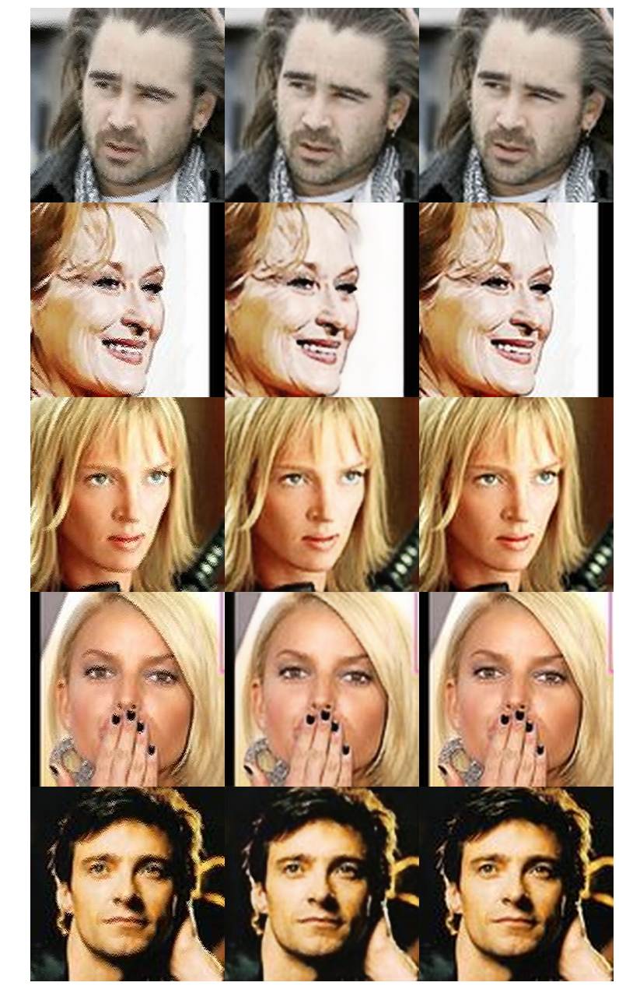

In [0]:
%matplotlib inline

import os
import random
from glob import glob

import cv2
import matplotlib.pyplot as plt
import numpy as np

NUM_DISPLAY = 5

files = glob('/content/my-pubfig831/correct/test/*/*')
grid = []
gen = load_model('gen_model.h5')
outputs = []
input_imgs = []
truths = []
# fig, axs = plt.subplots(5, 3)
# cnt = 0
for path in random.sample(files, NUM_DISPLAY):
  correct = cv2.imread(path)
  split = path.split('/')
  degraded = cv2.imread('/'.join([*split[:3], 'degraded', *split[4:]]))
  fixed = fix(degraded, gen)
  input_imgs.append(degraded)
  outputs.append(fixed)
  truths.append(correct)
#   degraded = cv2.cvtColor(degraded, cv2.COLOR_BGR2RGB)
#   correct = cv2.cvtColor(correct, cv2.COLOR_BGR2RGB)
  grid.append(np.column_stack([degraded, fixed, correct]))

image = np.row_stack(grid)
dpi = float(plt.rcParams['figure.dpi'])
figsize = image.shape[1] / dpi, image.shape[0] / dpi
ax = plt.figure(figsize=figsize).add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(image[..., ::-1])
plt.show()